$\rule{800pt}{20pt}$

# Imports

In [ ]:
import os
import os.path
import time
from datetime import datetime

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import tensorflow as tf
import cvxpy as cp

tf.keras.utils.set_random_seed(42)

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
os.getcwd()

'/content'

In [ ]:
images_path = '/content/drive/My Drive/DSO_464_Fall_2024/Images'

data_path = '/content/drive/My Drive/DSO_464_Fall_2024/05_Neural_Networks_for_Structured_Data_Dense_NNs_I_EX_Complexity_in_Stock_Returns_Predictions_for_Asset_and_Wealth_Management_and_Trading/Data'

$\rule{800pt}{20pt}$


# A Framework For How To Think About Business Analytics Problems

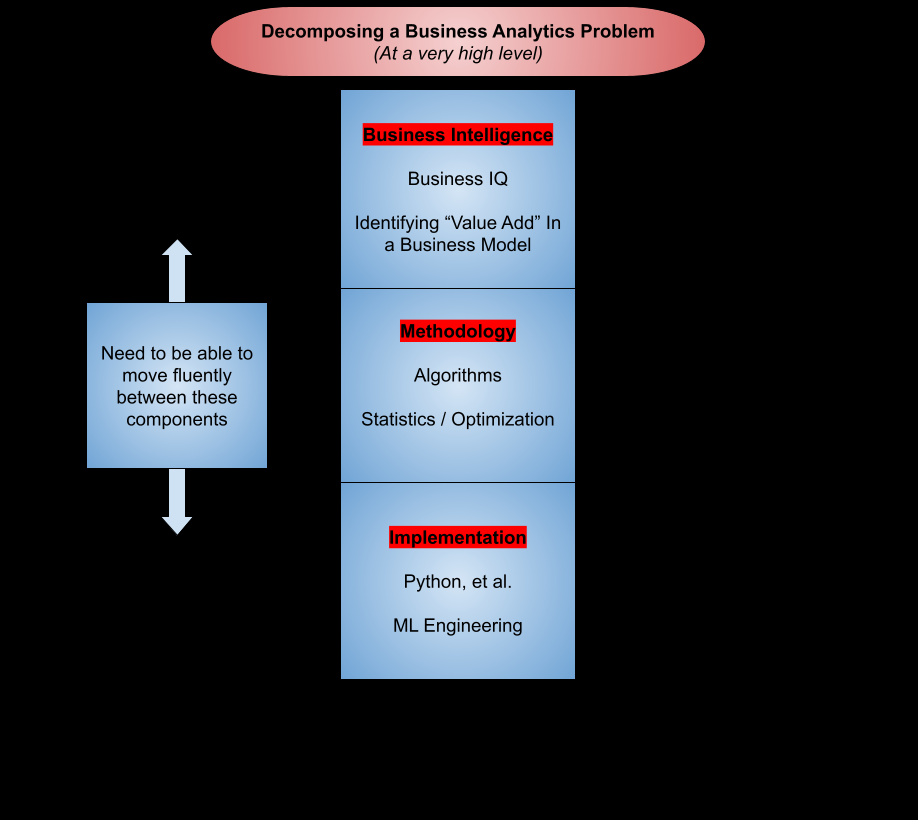

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'Outline_for_Decomposing_Analytics_Problems.png'))

$\rule{800pt}{20pt}$

$\rule{800pt}{20pt}$

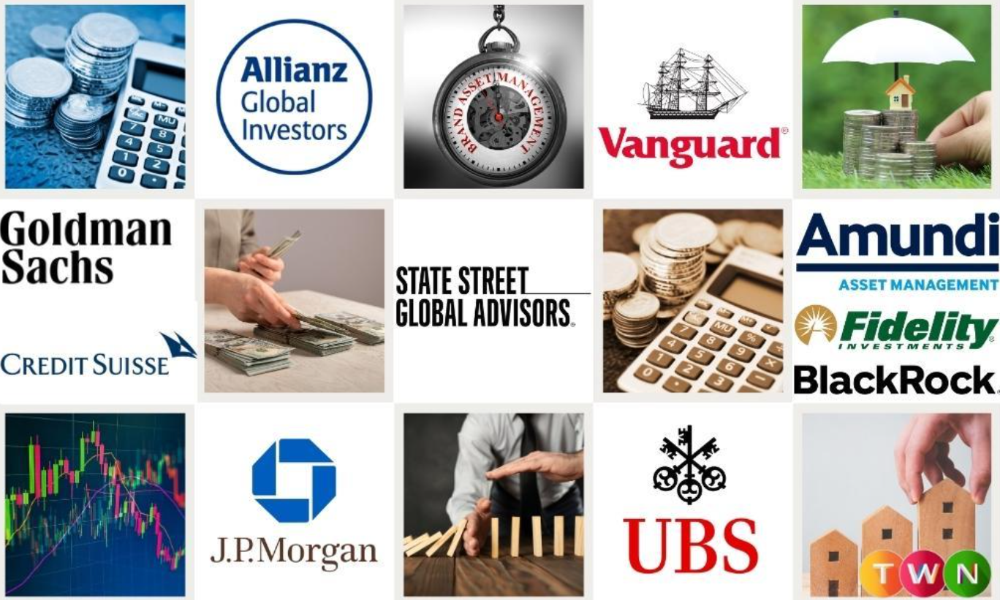

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'asset_management_1.png'))

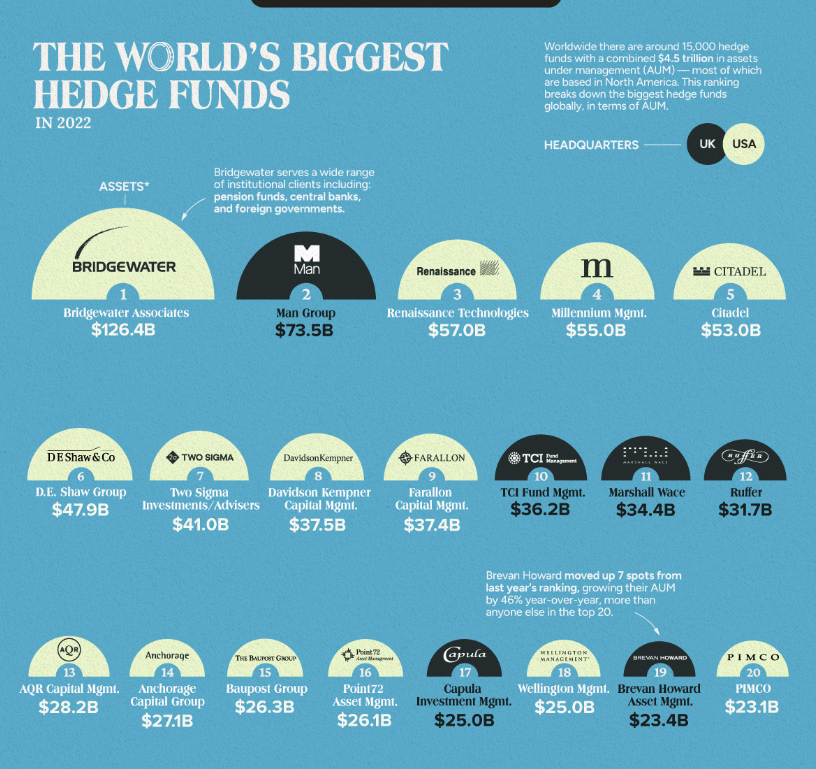

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'asset_management_2.png'))

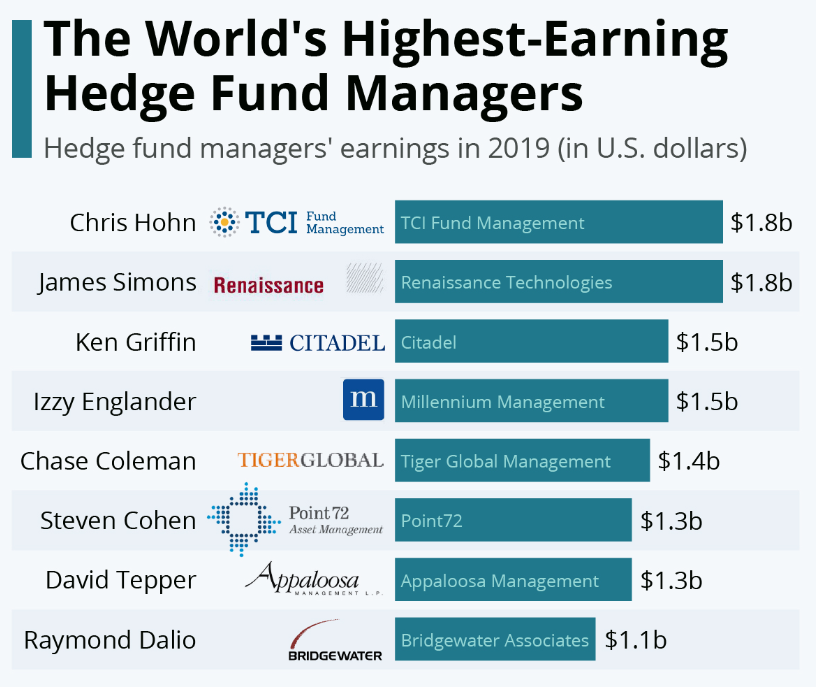

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'asset_management_3.png'))

- <a href="https://en.wikipedia.org/wiki/List_of_asset_management_firms">List of asset management firms by AUM</a>

- <a href="https://www.wallstreetprep.com/knowledge/top-hedge-funds/">List of top hedge funds by AUM</a>

- <a href="https://www.aqr.com/Learning-Center/Machine-Learning/Video-Introduction">Machine Learning in Asset Management</a>

$\rule{800pt}{20pt}$

# The Importance of Predicting Returns
<br>
<font size="+1">
    <ul>
        <li>Believe it or not, being able to anticipate the S&P 500 index (SPX) stock market returns is crucial for many commercial business domains, not just the financial sector.</li>
        <br>
        <li>Being able to anticipate market returns helps organizations make informed decisions and manage risks; these decisions typically center around <b>capital budgeting</b>.</li>
        <br>
        <li>However, companies also use market return forecasts to make <b>strategic decisions</b> regarding mergers, acquisitions, and divestments.</li>
        <br>
        <li>Other industries that need to be able to anticipate market returns are:</li>
        <br>
        <ul>
          <li>retail and e-commerce: for demand forecasting, inventory management, dynamic pricing, etc.,</li>
          <br>
          <li>manufacturing and supply chain management: for production planning, and aligning production and distribution with market conditions,</li>
          <br>
          <li>other industries include real estate, insurance, healthcare (for R&D development decisions).</li>
          <br>
        </ul>
        <br>
        <br>
        $\rule{800pt}{10pt}$
        <br>
        <br>
        <font color="blue"><li>In our context, we will be primarily focused on market return prediction for the purpose of <b>asset management and financial services</b>.</li></font>
        <br>
        <br>
        $\rule{800pt}{10pt}$
        <br>
        <br>        
    </ul>
</font>

$\square$

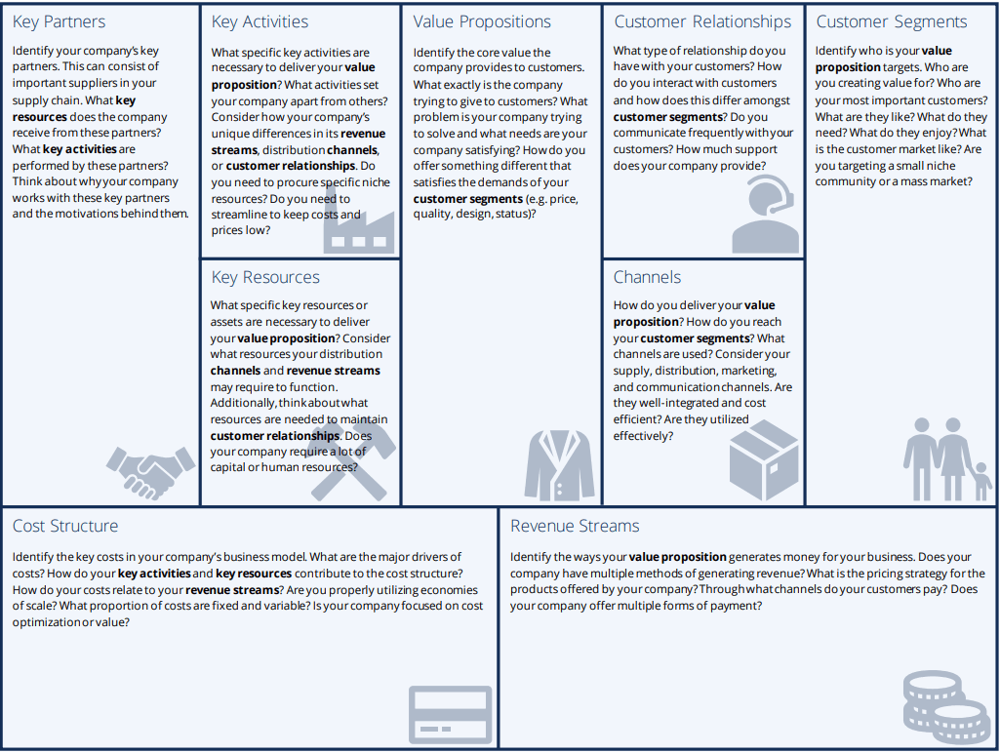

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'Business_Model_Canvas_2.png'))

## How Does Return Prediction Affect the Underlying Business Model of Asset Management?
<br>
<font size="+1">
    <ul>
        <li><font color="blue">Whenver you are considering technology, you should always spend time considering how the technology could impact, i.e. add value to,  pieces of firm's <b>business model</b>.</li>
        <br>
       <li>It is not uncommon that this simply boils down to measuring impact on key performance indicators (KPIs).</font></li>
        <br>
        <li>Asset managers act as intermediaries between savers and consumers through financial markets.</li>
        <br>
        <li>For this intermediary service, where they act as a financial advisor, they typically charge an annual fee based on <b>assets under management (AUM)</b>.</li>
        <br>
        <li>They seek to direct clients' funds into securities in an effort to construct and manage a portfolio that satisfies the clients' preferences.</li>
        <br>
        <li>They can also create products, financial securities such as mutual funds, ETFs, portfolios for insurance firms, portfolios for retirement accounts, etc., and can charge a fee for the management of those products.</li>
        <br>
        <li>In this sense, asset managers offer investment-related financial products and services to clients.</li>
        <br>
        <li>The asset management industry, like all other industries, has gone through many changes, exacerbated by financial market turbulence, and evolutions including</li>
        <ul>
            <li>the creation of new markets (PIMCO is an example),</li>
            <br>
            <li>the shift in client demand from active management portfolios to passively managed portfolios, and (possibly) back to clearly defined goal-based active management,</li>
            <br>
            <li>the change in demand for different vehicles for a particular product such as mutual funds, ETFs, annuities, retirement vehicles, hedge funds, private partnerships, private equity, venture capital,  etc.,</li>
            <br>
            <li>the rise in <i>robo-advising</i> and other competitive innovations in financial technology that seek to autmoate portfolio allocations and trade executions,</li>
            <br>
            <li>etc.</li>
            <br>
        </ul>
        $\rule{800pt}{10pt}$
        <br>
        <br>
        <li>To service and trade their portfolios, asset managers require require <a href="https://en.wikipedia.org/wiki/Custodian_bank">custody services</a>, as well as legal, compliance, and marketing advice.</li>
        <br>
        <li>There are also software vendors that cater to the investment fund community by developing software applications for portfolio management, client reporting, and other back-office services.</li>
        <br>
        <li>Other types of asset managers include:</li>
        <br>
        <ul>
            <li>Private equity funds, venture capital providers, and angel investors supply investment capital to companies in exchange for ownership stakes or profit participation.</li>
            <br>
            <li>Venture capital was especially important to technology firms in the 1990s. Much of what goes on behind the scenes in the making of big deals is attributed to this group.</li>
            <br>
        </ul>
        <br>
        <br>
        $\rule{800pt}{10pt}$
        <br>
        <br>
        <font color="blue"><li>To grow the important KPI of assets under management (AUM), asset managers need to continuously improve their ability to predict market returns!</li></font>
        <br>
        <br>
        $\rule{800pt}{10pt}$
        <br>
        <br>    
    </ul>
</font>

$\square$

## Modeling Returns
<br>
<font size="+1">
    <ul>
        <font color="blue"><li>Before we can <b>predict</b> the returns of SPX, we should consider how returns are <b>measured and traditionally modeled</b>.</li></font>
        <br>
        <li>The <b>return</b> of a security can be defined as the percentage change (i.e. growth rate) of the security's price \begin{equation}r_{i,t} = \frac{P_{i,t} - P_{i,t-1}}{P_{i,t-1}},\end{equation} where \begin{equation}P_{i,t}\end{equation} is the price of security \begin{equation}i\end{equation} at time \begin{equation}t.\end{equation}</li>
        <br>
        <ul>
          <li>Note that this formula is the return coming from price appreciation, and not dividends.</li>
          <br>
        </ul>
        <li>A very <b>crude estimate of the expected future return</b> of a security can be made by taking the sample average of a time series of returns $$\mathbb{E}_{ \ t \ }[r_{i, \ t+1}] \approx \frac{1}{T}\sum_{j=0}^{T-1} r_{i, t-j} \ .$$</li>
        <br>
        $\rule{800pt}{10pt}$
        <br>
        <br>
        <font color="blue"><li style="color:blue">There has to be a better way!</li></font>
        <br>
        $\rule{800pt}{10pt}$
        <br>
    </ul>
</font>

$\square$

### Using Factors to Model Returns
<br>
<font size="+1">
    <ul>
      <font color="blue"><li style="color:blue">However, a long time ago, analysts realized you could use <b>factors</b> to help predict future expected returns.</li></font>
        <br>
        <li>To reduce the notation, we will temporarily drop the $t$ subscript.</li>
        <br>
        <li>Assume returns follow the factor structure: $$r_i = \alpha_i + \sum_{k=1}^{p}\beta_{i,k}F_k + \varepsilon_i, $$ where $$F_k$$ are common random factors and the $$\beta_{i,k}$$ are the factor <i>loadings</i> (coefficients), and $$\varepsilon_i$$ is the security's idiosyncratic risk.</li>
        <br>
        <li>This allows us to estimate expected future returns at a given point in time $t$ as $$\mathbb{E}_{ \ t \ }\left[r_{i, \ t+1} \ | \ (F_1, \dots, F_p) \right] = f(F_1, \dots, F_p; \beta_i).$$</li>
        <br>
        <br>
        $\rule{800pt}{10pt}$
        <br>
        <br>
        <font color="blue"><li style="color:blue">How can we think of this type of modeling in terms of <b>traditional linear regressions (i.e. single-layer linear perceptrons)</b>, and how can we operationalize this with <b>deep learning</b> for time-series?</li></font>
        <br>
        $\rule{800pt}{10pt}$
        <br>
        <br>
        <li>Consider the case where factors can be observable (though typically noisy observations) or estimated (i.e. by PCA).</li>
    <br>
    <font color="red"><li>More specifically, assume the data we observe is being generated over time, and each new period, we observe a new set of factors and response variables.</li></font>
    <br>
    <ul>
      <font color="red"><li> <i>Note that when fitting time series regression models, you should use data at the highest sampling frequency possible. Also note, that if you use the highest frequency possible, that is trade and quote data, then you will not have evenly spaced time series.</i></li></font>
      <br>
    </ul>
    <li>In this case the available data is in the form $$\left\{\left(\widehat{F_t}, r_t \right )\right\}_{t \leq T},$$ which makes the <u>theoretical</u> model $$r_i = a_i + b_i^T \widehat{F} + \varepsilon_i = a_i + \sum_{k=1}^p b_{i,k} \widehat{F_k} + \varepsilon_i , $$ a <b>multivariate linear model</b> where the unknowns are the factor loadings.</li>
    <br>
    <ul>
      <font color="red"><li>This begs the question of how to fit these multilinear regression models?</li></font>
      <br>
      <li>When we consider the data, that is, for a given data observation at time $t$, and fix a given measured variable $i$, our model for an <u>observation/sample</u> looks a little more complicated (note that this is just notation):</li>
      <br>
      <ul>
        <li>\begin{align}r_{t,i} & = a_{t,i} + b_{t,i}^T \widehat{F_t} + \varepsilon_{t,i} \\ & = a_{t,i} + \sum_{k=1}^p b_{t,i,k} \ \widehat{F_{t,k}} \ + \varepsilon_{t,i}\end{align}</li>
        <br>
      </ul>
      <li>So we see that for a given variable (column $i$, we have a multiple linear regression (since we have multiple factors), and if we unfreeze $i$ then we have a multivariate regression model (many targets).</li>
      <br>
      <li>Depending on how many times we estimate the regression (i.e. all at once, for every column, for every new observation), we will have coefficients (factor loadings) that will depend on different indices (i.e. nothing, on the column, on the data point). </li>
      <br>
    </ul>
    <br>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <font color="red"><li><b>It should be noted that in practice, all estimations should occur on a rolling walkforward basis.</b></li></font>
    <br>
    <br>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    </ul>
</font>

$\square$

$\rule{800pt}{20pt}$

### An Aside: Factor Models

<details>
<summary> Click here for more details on the methodology of factor models.</summary>
<br>
<font size="+1">
  <ul>
    <li>When using the sample covariance matrix $\widehat{\Sigma}$ to approximate the true covariance matrix $\Sigma$, we find that when we are in high dimensions $p \geq n$, the sample estimator is a poor approximation.</li>
    <br>
    <li>We need to make some assumptions about our data and the structure of the covariance matrix to improve estimation, one possible assumption is to assume sparsity by thresholding individual pairwise correlations (setting values to zero if they are not above particular threshold), however this is an unreasonable assumption in many applications, especially financial applications since many variables in financial markets are lowly correlated.</li>
    <br>
    <li>The presence of common factors, which can be identified by co-movement of variables over time, leads to a very dense covariance matrix.</li>
    <br>
    <font color="orange"><li>Another common structure to assume for the covariance matrix $\Sigma$, particularly more well suited for financial applications, is <b>conditional sparsity</b>, which means that when you condition on common factors that impact the correlations in the data, the resulting covariance matrix is sparse. This structural assumption induces a <b>factor model</b>, i.e. assume the structure for the covariance matrix is a factor model.</li></font>
    <br>
    <li>A factor model is a useful tool for understanding the common dependence among many variables, specifically when the dependence among multivariate measurements is strong.</li>
    <br>
    <li>Let's consider a formal definition:</li>
    <br>
    <ul>
      <li>Consider some data $X \in \mathbb{R}^p$ of measurements, whose dependence is driven by $K$ factors $f \in \mathbb{R}^K$.</li>
      <br>
      <li>The <b>factor model</b> assumes:</li>
      <br>
      <ul>
        <li>$$X = a + \mathbf{B}f + u , $$ where $\mathbf{E}[u] = 0$ and $cov(f, u) =0$</li>
        <br>
        <li>Componentwise, this relation can be expressed as $$X_j = a_j + b_j^T f + u_j = a_j + \sum_{k=1}^K b_{j,k} f_k + u_j , $$ where $1\leq j \leq p$.</li>
        <br>
        <li>Here, $u$ is the unexpected or idiosyncratic component that is uncorrelated with the common factors $f$, and $\mathbf{B} $ is the $p \times K$ <b>factor loading</b> matrix \begin{bmatrix}
        \cdots & b_1 &  \cdots \\
        \cdots & b_2 &  \cdots \\
        & \vdots & \\
        \cdots & b_p &  \cdots \\
        \end{bmatrix}
with $b_{j,k}$ indicating how much the $j^{th}$ outcome $X_j$ depends on the $k^{th}$ factor $f_k$, and $a$ is a bias (intercept) term.</li>
        <br>
        <li>When $\Sigma_u = Var(u)$ is diagonal, it is referred to as a <b>strict factor model</b>, and when $\Sigma_u$ is sparse it is called an <b>approximate factor model</b>.</li>
        <br>
      </ul>
      <li><b>This framework induces a covariance structure for $\Sigma_X = Var(X)$, specifically:</b> $$\Sigma_X = \mathbf{B} \ \Sigma_f \ \mathbf{B}^T + \Sigma_u,$$ where $\Sigma_f = Var(f), \Sigma_u = Var(u)$.</li>
      <br>
      <li>It is common to assume $\Sigma_u$ is sparse, since common dependence has been removed from the assumed factors $\iff$ this condition of sparsity on the residuals covariance matrix is known as <b>conditional sparsity</b>.</li>
      <br>
      <li>When the factors and the residuals are independent, it is the case that $Var(X | f) = \Sigma_{X|f}= \Sigma_u$.</li>
      <br>
    </ul>
    <font color="red"><li>What happens when we have an entire data set?</li>
    <br>
    <li>How can we identify the factors?</li>
    <br>
    <li>How can we estimate the data's loadings on the factors?</li>
    <br></font>
    <li>Assume we have a data matrix
\begin{bmatrix}
\cdots & X_1 &  \cdots \\
\cdots & X_2 &  \cdots \\
& \vdots & \\
\cdots & X_n &  \cdots \\
\end{bmatrix} consisting of we have observed $n$ data points $\{X_i\}_{i \leq n}$ of $p$ measurements coming from the factor model: $$X_{i,j} = a_j + b_j^T f_i + u_{i,j},$$ for each variable $1 \leq j \leq p$.</li>
    <br>
    <li>In many applications, the realized factors $\{f_i\}_{i \leq n}$ are unknown and we need to estimate them from the data, and then estimate the loadings from the estimated factors.</li>
    <br>
    <li><i>For more on how to estimate with robust PCA, that assumes a low-rank and sparse structure, see section 10.2.1 of Fan et al.</i></li>
    <br>
    <font color="orange"><li>(IGNORE) Consider the following algorithm:</li></font>
    <br>
    <ol>
      <font color="orange"><li>Obtain the best estimator you can for $\mu$ and $\Sigma$, e.g. the sample mean $\widehat{\mu}$ and the sample covariance matrix $\widehat{\Sigma}$.</li>
      <br>
      <li>Compute the eigen-decomposition of $$\widehat{\Sigma} = \sum_{i=1}^p \hat{\lambda}_i \hat{o}_i \hat{o}_i^T ,$$ and the consider the top $K \leq p$ eigenvalues and corresponding eigenvectors.</li>
      <br>
      <li>Estimate the factor loading matrix $$\widehat{B} = \left[\sqrt{\widehat{\lambda}_1} \widehat{o}_1, \cdots, \sqrt{\widehat{\lambda}_K} \widehat{o}_K \right],$$ and the latent factors $$\widehat{f}_i = diag(\widehat{\lambda}_1, \cdots, \widehat{\lambda}_K)^{-1} \widehat{B}^T (X_i - \widehat{\mu}),$$ specifically $\widehat{B}$ consists of the top $K$ rescaled eigenvectors of $\widehat{\Sigma}$, and $\widehat{f}_i$ is the rescaled projection of $(X_i - \widehat{\mu})$ onto the space spanned by the eigenvectors.</li>
      <br>
      <li>Optain an initial estimator for $\Sigma_u$ by $\widehat{\Sigma}_u = \sum_{i=K+1}^{p}\hat{\lambda}_i \hat{o}_i \hat{o}_i^T$, and its regularized estimator $\widehat{\Sigma}_{u,\lambda}^{\tau}$ by using the correlation thresholding estimator.</li>
      <br>
      <li>Estimate the covariance matrix by the induced covariance factor structure $$\Sigma_X = \mathbf{B} \ \Sigma_f \ \mathbf{B}^T + \Sigma_u,$$ where we assume $\Sigma_f = Var(f) = I_K$, which implies $$\underbrace{\widehat{\Sigma}_{X, \lambda} = \widehat{\mathbf{B}} \ \widehat{\mathbf{B}}^T + \widehat{\Sigma}_{u,\lambda}^{\tau} = \sum_{i=1}^{K}\hat{\lambda}_i \hat{o}_i \hat{o}_i^T + \widehat{\Sigma}_{u,\lambda}^{\tau}}_{\text{Principal Orthogonal ComplEment Thresholding (POET) estimator}}$$</li>
      <br></font>
    </ol>
    <font color="orange"><li>How can we estimate the number of factors?</li>
    <br>
    <li>$K$ can usually be estimated from the eigenvalues of the pilot covariance matrix estimator $\widehat{\Sigma}$ by using classical methods such as likelihood ratio tests, the scree plot, etc. For more methods, see section 10.2.3 of Fan et al.</li></font>
    <br>
    <li>There are some cases, however, especially in finance, where factors can be observable (e.g. Fama French 3 factor model); in this case the available data is in the form $$\{(f_i, X_i)\}_{i \leq n},$$ which makes the model $$X_j = a_j + b_j^T f + u_j = a_j + \sum_{k=1}^K b_{j,k} f_k + u_j , $$ a <b>multivariate linear model</b> where the unknowns are the factor loadings.</li>
    <br>
    <ul>
      <font color="red"><li>This begs the question of how to fit these multilinear regression models?</li>
      <br>
      <li>There are a variety of estimators for this model that are appropriate under various assumptions on structure of the error covariance matrix.</li></font>
      <br>
    </ul>
    <font color="blue"><li><b>In conclusion, depending on the type of factor model you are using, either the loadings, the factors, or both the factors and the loadings are unknown and must be estimated, <u>on a rolling basis</u>.</b></li></font>
    <br>
  </ul>
</font>

</details>

$\square$

#### An Aside: Why Use Factor Models to Estimate $\widehat{\Sigma_X}$ Rather than the Sample Covariance Matrix?

<details>
<summary> Click here for more details on the methodology of factor models for estimating covariance matrices.</summary>
<br>
<font size="+1">
  <ul>
    <li>This is a slight repeat of the above reasons, with some additional details.</li>
    <br>
    <li>Recall the sample covariance matrix can be computed as: $$\widehat{\Sigma_X} = \frac{1}{n}\left(X - \mu\right)^T \left(X - \mu\right),$$ and the covariance matrix estimator coming from a factor model can be computed as $$\widehat{\Sigma_X} = \widehat{\mathbf{B}} \ \widehat{\Sigma_f} \ \widehat{\mathbf{B}}^T + \widehat{\Sigma_u}, \text{ where } \Sigma_f = Var(f), \Sigma_u = Var(u)$$</li>
    <br>
    <li><b>Why should we use the factor estimator rather than the sample estimator?</b></li>
    <br>
    <li>One reason is the estimation accuracy.</li>
    <br>
    <li>While the sample covariance matrix is unbiased, it requires the estimation of $\frac{p(p+1)}{2}$ covariances and variances.</li>
    <br>
    <ul>
      <li>Each of these parameters is estimated with error and when this many errors accumulate, the result can be a large loss of accuracy.</li>
      <br>
    </ul>
    <li>On the other hand, the factor model requires estimates of $p\times K$ parameters in the factor loading matrix $\mathbf{B}$, $\frac{K(K+1)}{2}$ parameters in the factor covariance matrix $\Sigma_f$, and $p$ parameters in the diagonal residual covariance matrix $\Sigma_u$, for a total of $$pK+\frac{K(K+1)}{2}+p$$ parameters, which is much smaller than $\frac{p(p+1)}{2}$ parameters since the number of covariates $p$ is large, and the number of factors $K$ is much smaller.</li>
    <br>
    <li>The downside of the factor model is that there will be bias in the estimate of $\widehat{\Sigma_X}$ if the factor model is misspecified, and especially if the residual covariance matrix is not diagonal, which is assumed by the factor model.</li>
    <br>
  </ul>
</font>

</details>

$\square$

### An Aside: Fitting Factor Models by Time Series Regression

<details>
<summary> Click here for more details on the methodology of fitting factor models using time-series data.</summary>
<br>
<font size="+1">
  <ul>
    <li>Consider the case where factors can be observable (though typically noisy observations) or estimated (i.e. by PCA).</li>
    <br>
    <font color="red"><li>More specifically, assume the data we observe is being generated over time, and each new period, we observe a new set of factors and response variables.</li></font>
    <br>
    <ul>
      <font color="red"><li> <i>Note that when fitting time series regression models, you should use data at the highest sampling frequency possible. Also note, that if you use the highest frequency possible, that is trade and quote data, then you will not have evenly spaced time series.</i></li></font>
      <br>
    </ul>
    <li>In this case the available data is in the form $$\left\{\left(\widehat{f_t}, X_t \right )\right\}_{t \leq T},$$ which makes the <u>theoretical</u> model $$X_j = a_j + b_j^T \widehat{f} + u_j = a_j + \sum_{k=1}^K b_{j,k} \widehat{f_k} + u_j , $$ a <b>multivariate linear model</b> where the unknowns are the factor loadings.</li>
    <br>
    <ul>
      <font color="red"><li>This begs the question of how to fit these multilinear regression models?</li></font>
      <br>
      <li>When we consider the data, that is, for a given data observation at time $t$, and fix a given measured variable $j$, our model for an <u>observation/sample</u> looks a little more complicated (note that this is just notation):</li>
      <br>
      <ul>
        <li>\begin{align}X_{t,j} & = a_{t,j} + b_{t,j}^T \widehat{f_t} + u_{t,j} \\ & = a_{t,j} + \sum_{k=1}^K b_{t,j,k} \ \widehat{f_{t,k}} \ + u_{t,j}\end{align}</li>
        <br>
      </ul>
      <li>So we see that for a given variable (column $j$, we have a multiple linear regression (since we have multiple factors), and if we unfreeze $j$ then we have a multivariate regression model (many targets).</li>
      <br>
      <li>Depending on how many times we estimate the regression (i.e. all at once, for every column, for every new observation), we will have coefficients (factor loadings) that will depend on different indices (i.e. nothing, on the column, on the data point). </li>
      <br>
    </ul>
    <font color="red"><li><b>It should be noted that in practice, all estimations should occur on a rolling walkforward basis.</b></li></font>
    <br>
  </ul>
</font>

</details>

$\square$

### An Aside: Fitting Factor Models by Cross-Sectional Regression

<details>
<summary> Click here for more details on the methodology of fitting factor models using cross-sectional data.</summary>
<br>
<font size="+1">
  <ul>
    <li>Consider the case where factors can be observable (though typically noisy observations) or estimated (i.e. by PCA).</li>
    <br>
    <li>In this case the available data is in the form $$\left\{\left(\widehat{f_i}, X_i \right )\right\}_{i \leq n},$$ which makes the <u>theoretical</u> model $$X_j = a_j + b_j^T \widehat{f} + u_j = a_j + \sum_{k=1}^K b_{j,k} \widehat{f_k} + u_j , $$ a <b>multivariate linear model</b> where the unknowns are the factor loadings.</li>
    <br>
    <ul>
      <font color="red"><li>This begs the question of how to fit these multilinear regression models?</li></font>
      <br>
      <li>When we consider the data, that is, for a given data observation $i$, and fix a given variable $j$, our model for an <u>observation/sample</u> looks a little more complicated (note that this is just notation):</li>
      <br>
      <ul>
        <li>\begin{align}X_{i,j} & = a_{i,j} + b_{i,j}^T \widehat{f_i} + u_{i,j} \\ & = a_{i,j} + \sum_{k=1}^K b_{i,j,k} \ \widehat{f_{i,k}} \ + u_{i,j}\end{align}</li>
        <br>
      </ul>
      <li>So we see that for a given column $j$, we have a multiple linear regression (since we have multiple factors), and if we unfreeze $j$ then we have a multivariate regression model.</li>
      <br>
      <li>Depending on how many times we estimate the regression (i.e. all at once, for every column, for every new observation), we will have coefficients (factor loadings) that will depend on different indices (i.e. nothing, on the column, on the data point). </li>
      <br>
    </ul>
  </ul>
</font>

</details>

$\square$

### An Aside: Statistical Factor Models

<details>
<summary> Click here for more details on the methodology of <b>statistical</b> factor models.</summary>
<br>
<font size="+1">
  <ul>
    <li>In a statistical factor model, neither the factors nor the loadings are directly observable, all that is available is the sample $\{X_i\}_{i\leq n}$, and possibly the sample covariance matrix.</li>
    <br>
    <li><b>What do we do?</b></li>
    <br>
    <li>We need to make some necessary assumptions to identify the parameters in $\Sigma_X$:</li>
    <br>
    <ul>
      <li>Assume the factors are uncorrelated and standardized $$\Sigma_f = I_K,$$ which leads to the covariance matrix being $$\Sigma_X = \mathbf{B}\mathbf{B}^T + \Sigma_u.$$</li>
      <br>
      <li>Assume $$\mathbf{B}\Sigma_u^{-1}\mathbf{B}^T $$ is diagonal to allow for uniqueness of the factor loading estimations (otherwise the factor loadings will only be determined up to a rotation.</li>
      <br>
    </ul>
    <font color="blue"><li>Consider the following algorithm:</li></font>
    <br>
    <ol>
      <font color="blue"><li>Obtain the best estimator you can for $\mu$ and $\Sigma$, e.g. the sample mean $\widehat{\mu}$ and the sample covariance matrix $\widehat{\Sigma}$.</li>
      <br>
      <li>Compute the eigen-decomposition of $$\widehat{\Sigma} = \sum_{i=1}^p \hat{\lambda}_i \hat{o}_i \hat{o}_i^T ,$$ and the consider the top $K \leq p$ eigenvalues and corresponding eigenvectors.</li>
      <br>
      <li>Estimate the factor loading matrix $$\widehat{B} = \left[\sqrt{\widehat{\lambda}_1} \widehat{o}_1, \cdots, \sqrt{\widehat{\lambda}_K} \widehat{o}_K \right],$$ and the latent factors $$\widehat{f}_i = diag(\widehat{\lambda}_1, \cdots, \widehat{\lambda}_K)^{-1} \widehat{B}^T (X_i - \widehat{\mu}),$$ specifically $\widehat{B}$ consists of the top $K$ rescaled eigenvectors of $\widehat{\Sigma}$, and $\widehat{f}_i$ is the rescaled projection of $(X_i - \widehat{\mu})$ onto the space spanned by the eigenvectors.</li>
      <br>
      <li>Optain an initial estimator for $\Sigma_u$ by $\widehat{\Sigma}_u = \sum_{i=K+1}^{p}\hat{\lambda}_i \hat{o}_i \hat{o}_i^T$, and its regularized estimator $\widehat{\Sigma}_{u,\lambda}^{\tau}$ by using the correlation thresholding estimator.</li>
      <br>
      <li>Estimate the covariance matrix by the induced covariance factor structure $$\Sigma_X = \mathbf{B} \ \Sigma_f \ \mathbf{B}^T + \Sigma_u,$$ where we assume $\Sigma_f = Var(f) = I_K$, which implies $$\underbrace{\widehat{\Sigma}_{X, \lambda} = \widehat{\mathbf{B}} \ \widehat{\mathbf{B}}^T + \widehat{\Sigma}_{u,\lambda}^{\tau} = \sum_{i=1}^{K}\hat{\lambda}_i \hat{o}_i \hat{o}_i^T + \widehat{\Sigma}_{u,\lambda}^{\tau}}_{\text{Principal Orthogonal ComplEment Thresholding (POET) estimator}}$$</li>
      <br></font>
    </ol>
    <font color="blue"><li>How can we estimate the number of factors?</li>
    <br>
    <li>$K$ can usually be estimated from the eigenvalues of the pilot covariance matrix estimator $\widehat{\Sigma}$ by using classical methods such as likelihood ratio tests, the scree plot, etc. For more methods, see section 10.2.3 of Fan et al.</li></font>
    <br>
  </ul>
</font>

</details>

$\square$

### An Aside: Fitting Factor Models by Fama-MacBeth Regressions

<details>
<summary> Click here for more details on the methodology of fitting  factor models using the methodology of Fama and MacBeth (1973).</summary>
<br>
<font size="+1">
  <ul>
    <li>This is a two-step regression where you first run a time-series regression to estimate factor loadings, and second run a cross-sectional regression, where your covariates are the previously estimated factor loadings, to estimate factor risk premiums. You can then do inference on the estimated factor risk premiums.</li>
    <br>
    <li>For more on this see: <a href="https://en.wikipedia.org/wiki/Fama%E2%80%93MacBeth_regression">Wiki: Fama-MacBeth Regression</a>, <a href="https://www3.nd.edu/~nmark/FinancialEconometrics/2022Course/CourseNotes/Prepared_1Nov2022.pdf">Fama-MacBeth notes</a>, <a href="https://goldinlocks.github.io/Fama-MacBeth-regression/">a very nice implementation of Fama-MacBeth regressions on GitHub</a>, <a href="https://www.nber.org/system/files/working_papers/w31502/w31502.pdf">Financial Machine Learning</a>, and <a href="https://www.sciencedirect.com/science/article/abs/pii/S0304405X19301151">Characteristics are covariances: A unified model of risk and return</a>.</li>
    <br>
  </ul>
</font>

</details>

$\square$

$\rule{800pt}{20pt}$

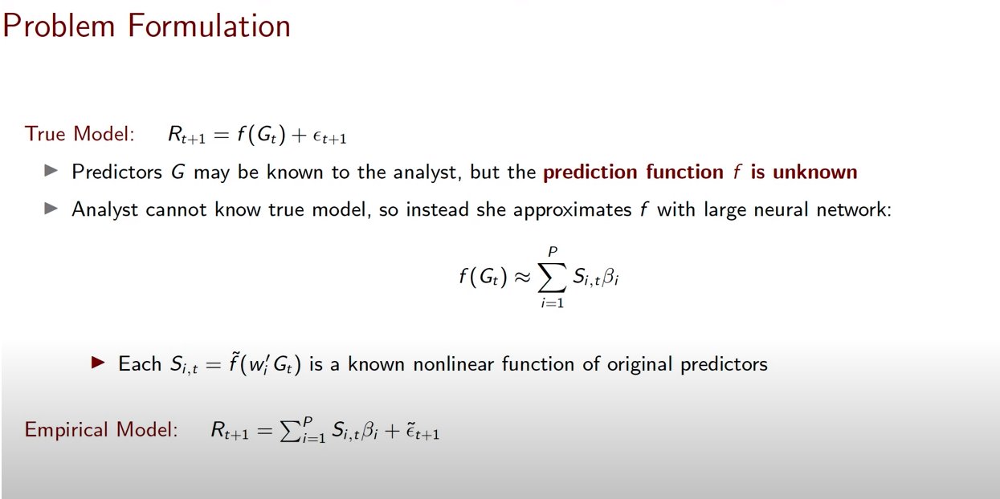

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_problem_formulation_I.png'))

## Nonlinear and High-Dimensional Modeling is a Crucial Compenent of Return Prediction
<br>
<font size="+1">
  <ul>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <font color="blue">
    <li>On a given day $t$, assume we can observe $T$ historical days, and over that period of observation, we can measure $p$ variables $(F_1, \dots, F_p)$.</li>
    <br>
    <li>Let's say that we want to use these $p$ variables measured over $T$ days of observation; how can we generate a model to do this?</li>
    <br>
    <li>In a traditional linear regression framework, it depends if $p>T$ or if $p\leq T$.</li>
    <ul>
      <font color="blue">
      <li>If $p \leq T$, then there is a unique solution for the weights $\widehat{w}$ are uniquely determined.</li>
      <br>
      <li>If $p > T$, then there are infinitely-many solutions, so this begs the question about how to choose such a solution?</li>
      <br>
      <ul>
        <font color="blue"><li>The short answer is to use deep neural networks (which is equivalent to a random feature transformation plugged into a ridge regression).</li>
        <br>
        <li>The long answer is to read about <i>benign overfitting</i>, <i>double descent</i>, and the <i>virtue of complexity</i> in <a href="https://onlinelibrary.wiley.com/doi/10.1111/jofi.13298">this paper</a>, as well as <a href="https://arxiv.org/pdf/2305.19377.pdf">this one</a>.</font>
        <br>
      </ul>
      <br>
    </ul>
    <li><b>This allows us to estimate expected future returns at a given point in time $t$ as a dense neural network, which can capture the non-linear relations and high-dimensional relations between the factors and the returns:</b> $$\mathbb{E}_{ \ t \ }\left[r_{i, \ t+1} \ | \ (F_1, \dots, F_p) \right] = f(F_1, \dots, F_p; w_i) = \sigma_{L}(W_L\sigma_{L-1}(W_{L-1}\sigma_{L-2}(W_{L-2} \cdots \sigma_2(W_2 \sigma_1(W_1\mathbf{F})) \cdots ))).$$</li>
    <br>
    <li>Note, when the target variable is for a regression, then the terminal activation function is $$\sigma_L(h) = h.$$</li>
    <br>
    <br>
    <li><b>But how can we actually build these complicated objects? That is the topic of this module.</b></li></font>
    <br>
    <br>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <ul>
      <li>In traditional finance, factors refer to portfolios formed from some characteristic related to a security.</li>
      <br>
      <li>Here, we are referring to a factor as any variable that has potentially predictive power.</li>
      <br>      
    </ul>
    <li><details>
    <summary>How can we think about different factors?</summary>
    <ul>
      <li>Frequently, academics and practitioners think of factors as coming from either risk premiums (i.e extra return due to bearing some sort of risk) or behavioral biases (i.e. repeated distortions in prices due to irrational preferences of market participants).</li>
      <br>
      <li>Factors can span a wide variety of different data sources to capture a variety of <b>risk premiums</b> such as the:</li>
      <br>
      <ul>
        <li>equity risk premium</li>
        <br>
        <li>bond risk premium</li>
        <br>
        <li>credit risk premium</li>
        <br>
        <li>alternative asset risk premium</li>
        <br>
        <li>value-oriented risk premium</li>
        <br>
        <li>currency carry risk premium</li>
        <br>
        <li>momentum risk premium</li>
        <br>
        <li>volatility risk premium</li>
        <br>
        <li>growth risk premium</li>
        <br>
        <li>inflation risk premium</li>
        <br>
        <li>illiquidity risk premium</li>
        <br>
        <li>tail-risk premium</li>
        <br>
        <li>etc.</li>
        <br>
        <li>For more on factors, see a quantitative investing course.</li>
        <br>
      </ul>
      <li>Can you think of any alternative data sources that could be of value?</li>
      <br>
      <li>For more, see the book: <a href="https://www.google.com/books/edition/Expected_Returns/WqFf6imwTsUC?hl=en&gbpv=1&printsec=frontcover">Expected Returns: An Investor's Guide to Harvesting Market Rewards</a> by Antti Ilmanen.</li>
      <br>
    </ul></details></li>
    <br>
  </ul>
  <font color="red"><li><b>In short, the management of financial portfolios requires a high-dimensional prediction model to earn favorable returns for clients.</b></li></font>
  <br>
  <li>For more, see <a href="https://www.blackrock.com/us/financial-professionals/products/factor-etfs">factor investing at BlackRock</a> or <a href="https://www.blackrock.com/us/individual/investment-ideas/what-is-factor-investing/factor-commentary/andrews-angle">Head of Factor Investing at BlackRock Andrew Ang</a>, as well as <a href="https://onlinelibrary.wiley.com/doi/full/10.1111/jofi.13298">here</a>.</li>
  <br>
</font>

$\square$

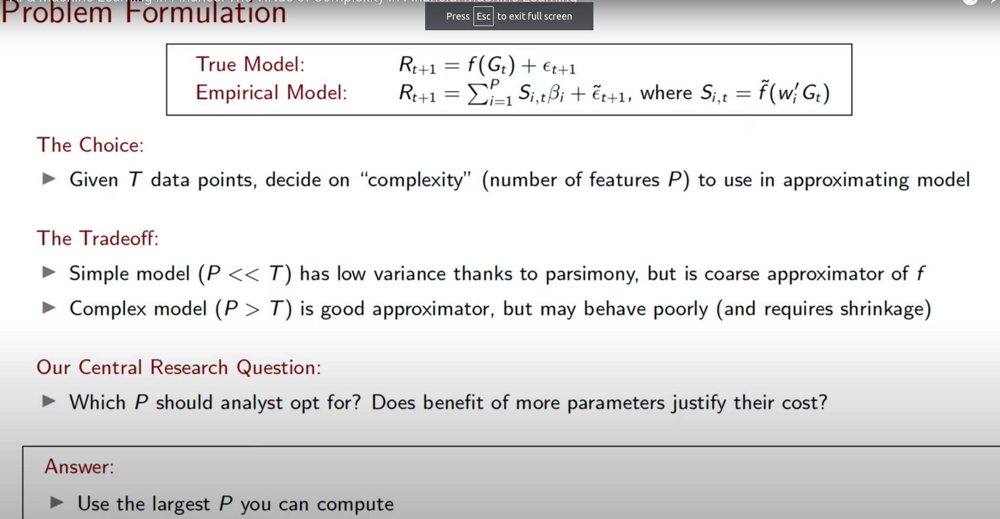

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_problem_formulation_II.png'))

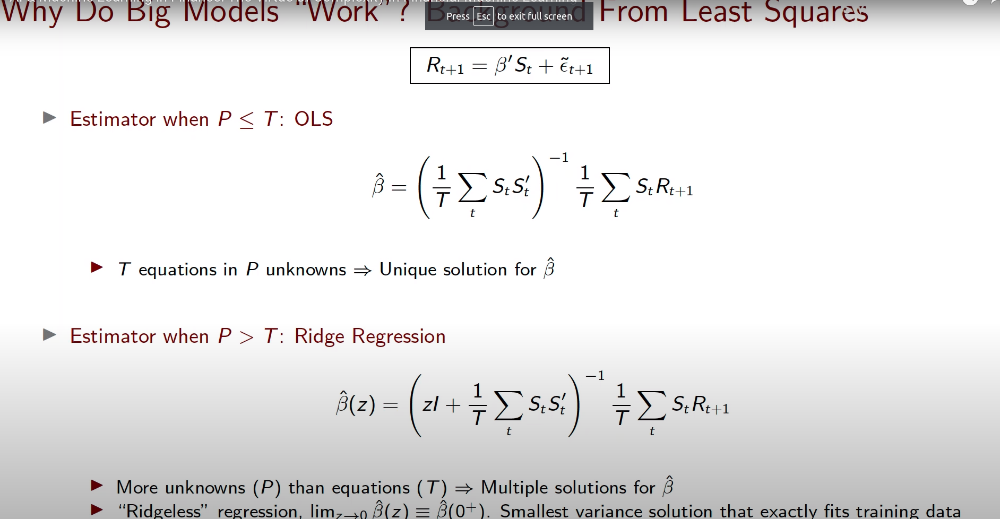

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_solution_from_OLS_I.png'))

## Prediction and Performance in the Machine Learning Regime
<font size="+1">
    <ul>
        <li>When estimating different predictive models, we typically estimate on different data sets known as a <b>training (in-sample)</b> data set and a <b>testing (out-of-sample)</b> data set.</li>
        <br>
        <li>The following is an example of data containing nonlinear signal and moderate noise.</li>
        <br>
    </ul>
</font>

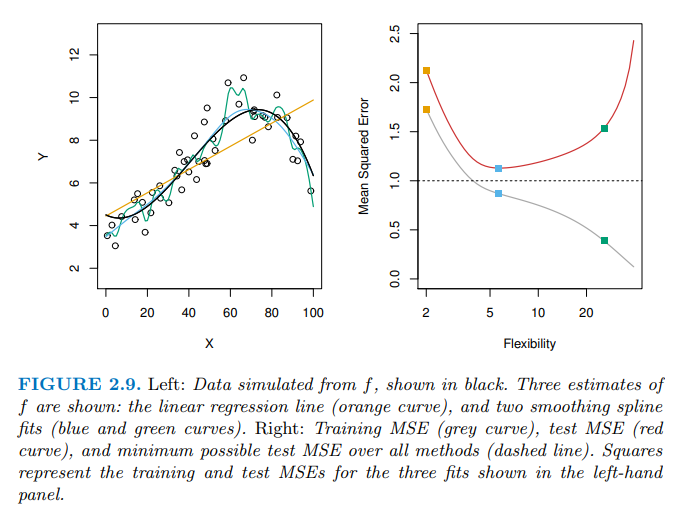

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'error_vs_flexibility_for_semi_nonlinear_data.PNG'))

<br>
<font size="+1">
    <ul>
        <li>Increasing the flexibility of a model typically leads to better error measurements using in-sample training data.</li>
        <br>
        <li>When evaluating a model on out-of-sample test data, increasing the flexibility of a model typically leads to better error measurements initially, but eventually the error worsens as the model flexibility gets too.</li>
        <br>
        <li>This is due to the model fitting the in-sample noise rather than the signal.</li>
        <br>
        <li>The following is an example of data containing linear signal and moderate noise.</li>
        <br>
    </ul>
</font>

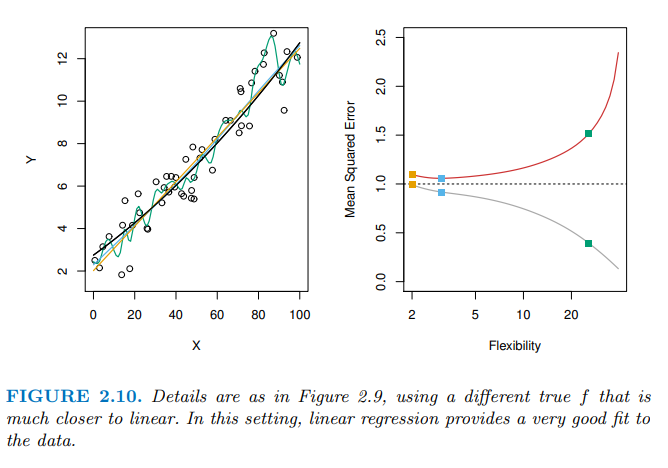

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'error_vs_flexibility_for_linear_data.PNG'))

<br>
<font size="+1">
    <ul>
        <li>We typically wish to find the model which minimizes the error over the out-of-sample testing data set.</li>
        <br>
        <li>The following is an example of data containing nonlinear signal and very small noise.</li>
        <br>
    </ul>
</font>

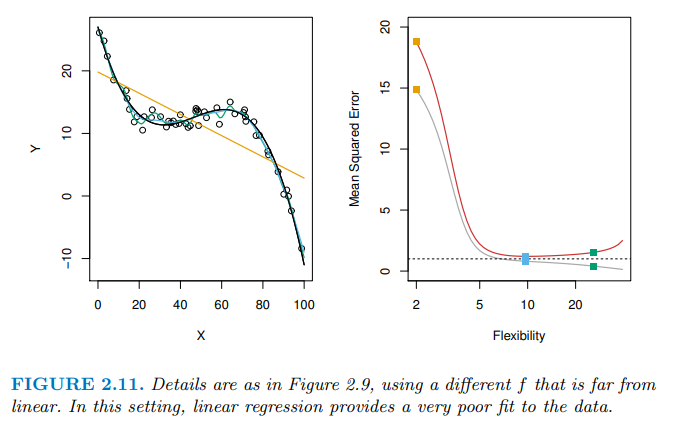

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'error_vs_flexibility_for_highly_nonlinear_data.PNG'))

In [ ]:
break

SyntaxError: 'break' outside loop (<ipython-input-1-6aaf1f276005>, line 1)

<br>
<font size="+1">
    <ul>
        <li>This <i>U-shaped</i> curve, also known as convexity, is typically seen in measures of the out-of-sample test error and is caused from a tradeoff between the <b>bias</b> and <b>variance</b> of the model's predictions ($\hat{f}$).</li>
        <br>
        <li>That is, every error measurement can be decomposed into the variance of model's predictions (i.e. the spread of the predictions) and the bias of the model's predictions (i.e. the shift of the predictions).</li>
        <br>
        <li>$$
        \text{average squared error} \approx MSE(\hat{Y}) := \mathbb{E}\left[(\hat{Y}-Y)^2\right] = Var(\hat{Y}) + \left(Bias(\hat{Y})\right)^2
        $$</li>
        <br>
        <li>A dream of building predictive models is to build a model that has <b>low variance</b> and <b>low bias</b>, however, these quantities are at odds with one another and typically as one goes up another goes down.</li>
        <br>
        <li>The relative magnitude of the up and down movements of the bias and variance result in the quality of error a model can hope to achieve out-of-sample on unseen data.</li>
        <br>
    </ul>
</font>

$\square$

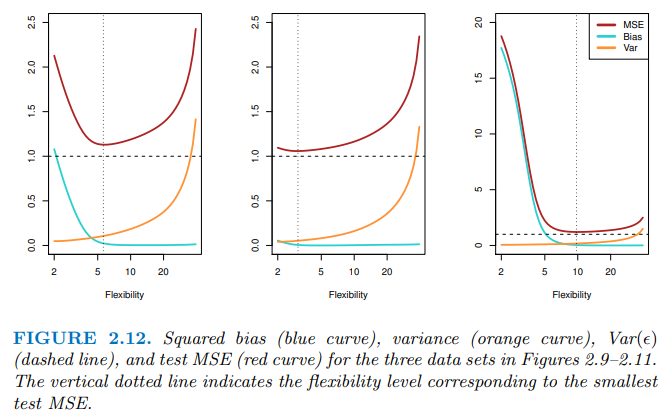

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'total_error_decomposition.PNG'))

### Bias-Variance Tradeoff
<br>
<font size="+1">
    <ul>
        <li>When our estimator is underperforming, how should we move forward?</li>
        <br>
        <ul>
            <li>Should we use a more flexible (complicated) model?</li>
            <br>
            <li>Should we use a less complicated (interpretable/biased) model?</li>
            <br>
            <li>Should we gather more data for estimation, if we can?</li>
            <br>
            <li>Should we gather more data to add predictor variables to every observation?</li>
            <br>
            <br>
        </ul>
        <li> $$
 MSE(\hat{Y}) = Var(\hat{Y}) + (Bias(\hat{Y}))^2
 $$</li>
        <br>
    </ul>
</font>

$\square$

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('ggplot')
import seaborn as sns

#set the random seed for reproducible results
rng = np.random.default_rng(42)

rng

Generator(PCG64) at 0x785620303300

In [ ]:
y_true = 4

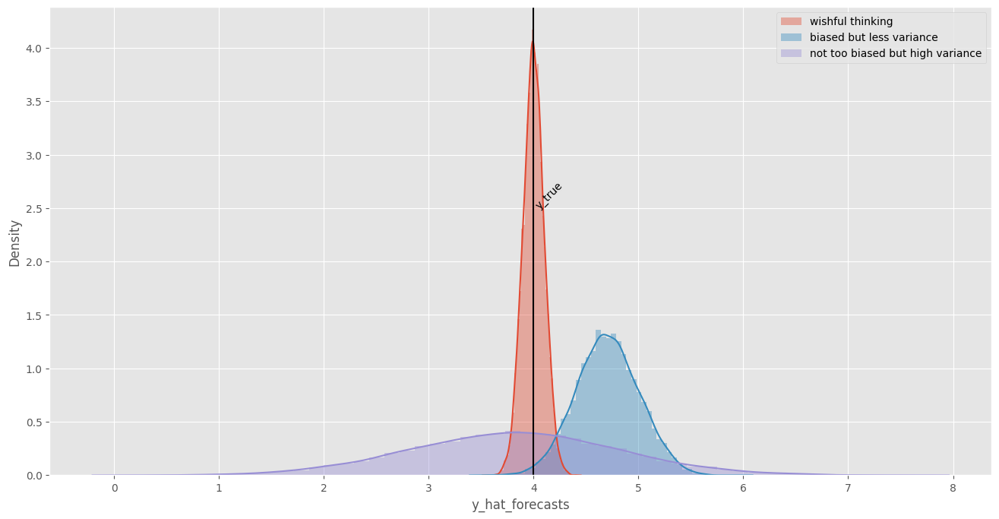

In [ ]:
import warnings
warnings.filterwarnings(action='ignore')

plt.figure(figsize=(16,8))

sns.distplot(rng.normal(loc=y_true, scale=0.1, size=10000),
             kde=True, hist=True, label="wishful thinking")

sns.distplot(rng.normal(loc=4.7, scale=0.3, size=10000),
             kde=True, hist=True, label="biased but less variance")

sns.distplot(rng.normal(loc=3.8, scale=1, size=10000),
             kde=True, hist=True, label="not too biased but high variance")

plt.xlabel('y_hat_forecasts')
plt.axvline(x=y_true, color="black")
plt.text(y_true,2.5,'y_true',rotation=45)
plt.legend()
plt.show()

<font size="+1">
    <ul>
        <li>Which estimator is better?</li>
        <br>
        <li>To learn more about mean-squared error, see the <a href="https://en.wikipedia.org/wiki/Mean_squared_error">Wikipedia</a> and for more on its decomposition, see <a href="https://agupubs.onlinelibrary.wiley.com/doi/full/10.1029/2021MS002681">Mean Squared Error, Deconstructed</a>.</li>
        <br>
    </ul>
</font>

### Relating Predictive Accuracy to Portfolio Performance
<br>
<font size="+1">
    <ul>
        <li>It turns out that there isn't just a nice statistical decomposition of MSE (in terms of estimator risk and bias), but there is also a financial interpretation as well (in terms of expected return and leverage): $$MSE(\widehat{R_{t+1}(w)}) = \mathbb{E}[(R_{t+1} - \widehat{R_{t+1}(w)})^2 \ \big| \ w] = \cdots = \mathbb{E}[R_{t+1}^2] - 2 \underbrace{\mathbb{E}[\widehat{\pi_t(w)} \ R_{t+1} \ \big| \ w]}_{\text{portfolio} \\ \text{expected return}} + \underbrace{\mathbb{E}[\widehat{\pi_t(w)^2} \ \big| \ w]}_{\text{portfolio} \\ \text{leverage}}$$</li>
        <br>
        <li>The above equation gives an expected return / leverage tradeoff using a <b>financial decomposition of the mean-squared error</b>.</li>
        <br>
        <br>
        <br>
        $\rule{800pt}{10pt}$
        <br>
        <br>
        <li>Another common way to measure model value from a statistical perspective is to use an adaptation of the traditional <a href="https://en.wikipedia.org/wiki/Coefficient_of_determination">in-sample (adjusted) $R^2$</a>, called the <a href="https://arxiv.org/pdf/2302.05131.pdf">out-of-sample $R^2$</a>, which is: $$R^2_{OOS}(t) = 1 - \frac{MSE(\widehat{R_t(w)})}{MSE(\bar{R_{t}})} = 1 - \frac{\sum_{j=1}^t (R_j - \widehat{R_j(w)})^2}{\sum_{j=1}^t (R_j - \bar{R_j})^2},$$ where $$\bar{R_{t}}$$ is just the historical average return up to time $t$, and $$\widehat{R_t(w)}$$ is the prediction model of returns at time $t$ with weights $w$.</li>
        <br>
        <ul>
          <li>This was popularized in <a href="https://dash.harvard.edu/bitstream/handle/1/2622619/Campbell_Predicting.pdf;jsessionid=9A74F5E5310874D3A297BA87FECBDCF5?sequence=2">Predicting Excess Stock Returns Out of Sample: Can Anything Beat the Historical Average?</a> by Campbell and Thompson (2008).</li>
          <br>
          <li> If the out-ofsample $R^2_{OOS}$ is positive, then the predictive model has lower average mean-squared error than the historical average return.</li>
          <br>
          <ul>
            <li><i>Clark and West (2005) point out that if the return series is truly unpredictable, then in a finite sample the predictive regression will on average have a higher mean squared prediction error because it must estimate an additional coefficient. Thus the expected out-of-sample $R^2_{OOS}$ under the null of unpredictability is negative, and a zero out-of-sample $R^2_{OOS}$ can be interpreted as weak evidence for predictability. This point can be muted if you ask whether predictive regressions or historical average return forecasts have delivered better out-of-sample forecasts, and not whether stock returns are truly predictable.</i></li>
            <br>
          </ul>
        </ul>
        <font color="red"><li><b>However, the out-of-sample $R^2$ is from a prediction model is an incomplete measure of its economic value.</b></li>
        <br>
        <li>It is possible to generate significant economic profits even when the predictive $R^2$ is negative.</li></font>
        <br>
        <ul>
          <font color="red"><li>This can be explained because the $R^2$ is heavily influenced by the variance of the forecasts.</li>
          <br>
          <ul>
            <font color="red"><li>i.e. $R^2$ is not just about the predictive correlation of a feature variable with the target.</li></font>
            <br>
          </ul>
          <li>A very low out-of-sample $R^2$ indicates a highly volatile portfolio strategy; however, the Sharpe ratio (and other measures of portfolio performance) can still be substantial!</li></font>
          <br>
        </ul>
        $\rule{800pt}{10pt}$
        <br>
        <br>
        <font color="blue"><li style="color:blue"><b>Predictive $R^2$ is not enough (and possibly inapproprate) for judging the commercial (economic) benefit of a deep learning model.</b></li>
        <br>
        <li><b>All statistical metrics must be judged by the business performance metric / KPI.</b></li></font>
        <br>
        <br>
        $\rule{800pt}{10pt}$
        <br>
    </ul>
</font>

$\square$

### An Aside: A Note on $R^2$

<details>
<summary> Click here for more remarks on the relationship between a predictor model's out-of-sample $R^2$ and its business / commercial / economic value.</summary>
<br>
<font size="+1">
  <ul>
    <li>Question: does economic value $\implies$ good $R^2_{OOS}$?</li>
    <br>
    <li>Equivalently, does a bad $R^2_{OOS}$ $\implies$ limited / no economic value?</li>
    <br>
    <li>The short answer is <b>NO</b>.</li>
    <br>
    <li>There is very new theory verifying this answer, as well as lots of empirical research observing this (including in my own research).</li>
    <br>
    <li>$R^2_{OOS}$ and Sharpe ratio measurements serve different purposes.</li>
    <br>
    <li>$R^2_{OOS}$ helps evaluate forecast accuracy, while the Sharpe ratio is appropriate for evaluating the economic value of forecasts in asset allocation contexts.</li>
    <br>
    <li>This research highlights the fact that in this business context, we can worry less about the positivity of $R^2_{OOS}$ from a prediction model, and focus more on the out-of-sample commercial metrics and KPIs based on those predictions.</li>
    <br>
    <li>For more on this see sections 4 adn 5 of <a href="https://onlinelibrary.wiley.com/doi/full/10.1111/jofi.13298">The Virtue of Complexity in Return Prediction</a> by Kelly, et al. (2023).</li>
    <br>
  </ul>
</font>

</details>

$\square$

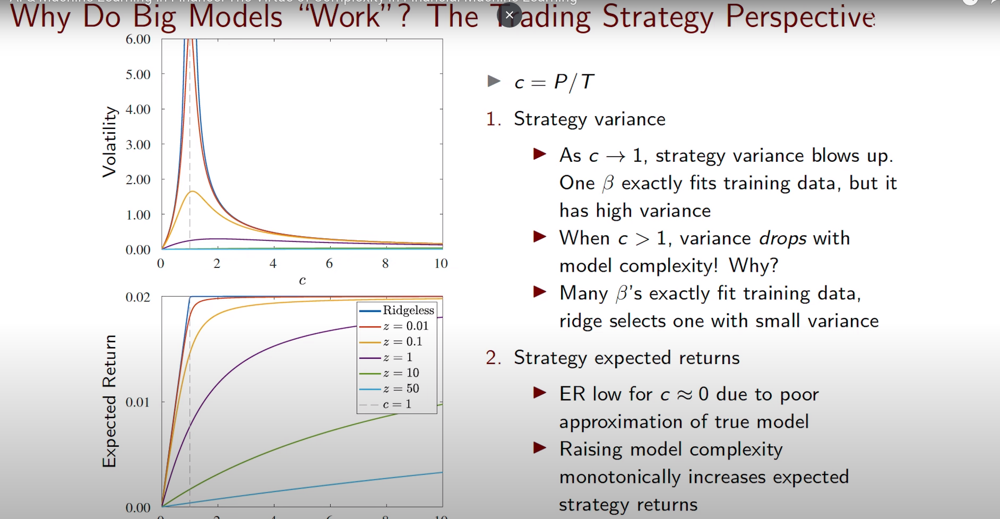

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_solution_from_trading_I.png'))

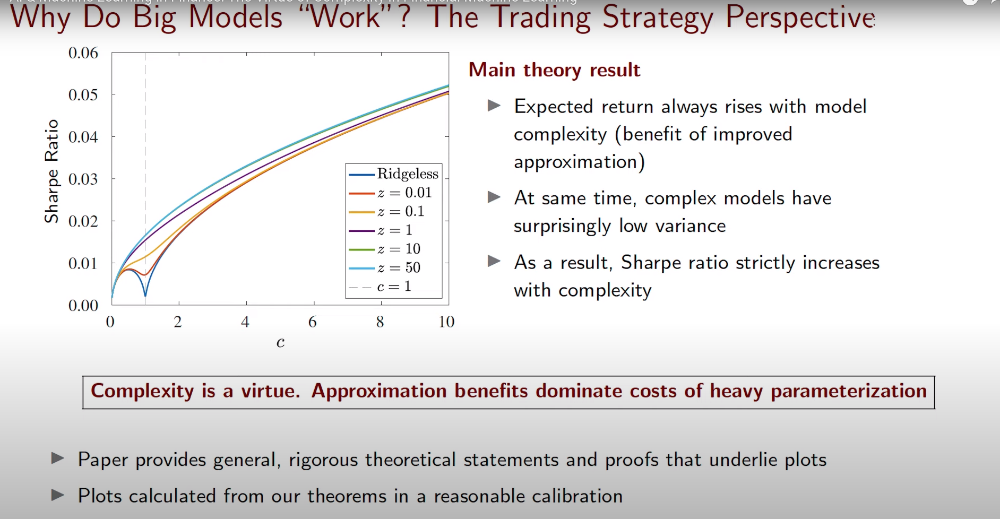

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_solution_from_trading_II.png'))

### Is a large number of parameters always a bad thing?
<br>
<font size="+1">
<details>
<summary>For more on this phenomenon, see here.</summary>
  <ul>
    <li>Double Descent</li>
    <br>
    <li>Benign Overfitting</li>
    <br>
    <ul>
      <li><a href="https://www.pnas.org/doi/epdf/10.1073/pnas.1907378117">Benign Overfitting in Linear Regression</a></li>
      <br>
      <li><a href="https://arxiv.org/pdf/2305.14077.pdf">Mind the spikes: Benign overfitting of kernels and neural networks in fixed dimension</a></li>
      <br>
    </ul>
    <li>Overparameterization</li>
    <br>
    <li>Interpolation Estimators</li>
    <br>
    <ul>
      <li><a href="https://www.youtube.com/watch?v=RYXNgksWXR0">Surprises in High-Dimensional (Overparameterized) Linear Classification</a></li>
      <br>
      <li>Least-2-norm interpolation can classify consistently even when the corresponding regression task fails,</li>
      <br>
      <li>The support-vector-machine and least-2-norm interpolation solutions exactly coincide in sufficiently high-dimensional models.</li>
      <br>
    </ul>
  </ul>
  </details
</font>


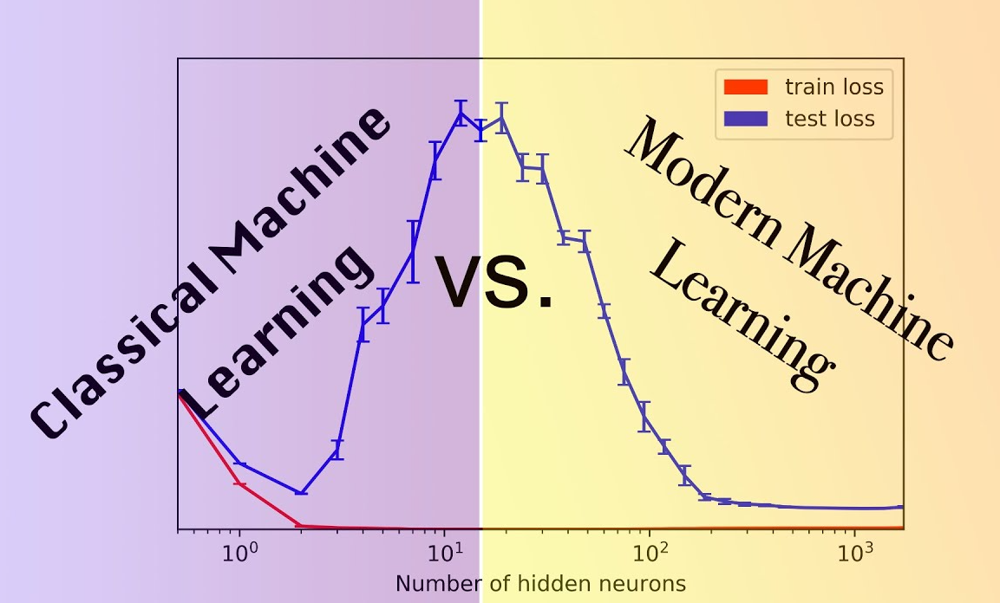

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'classical_vs_modern_ML.png'))

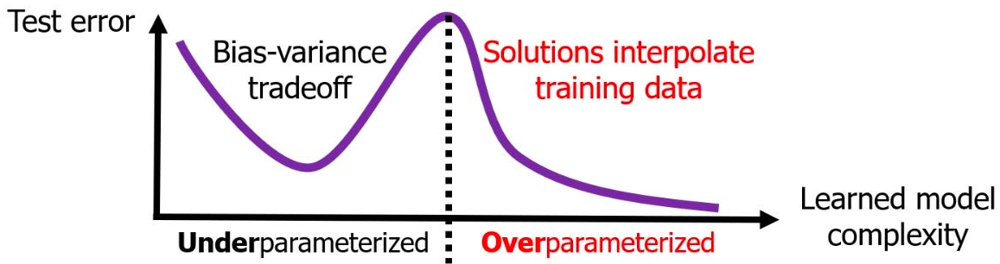

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'double_descent_II.png'))

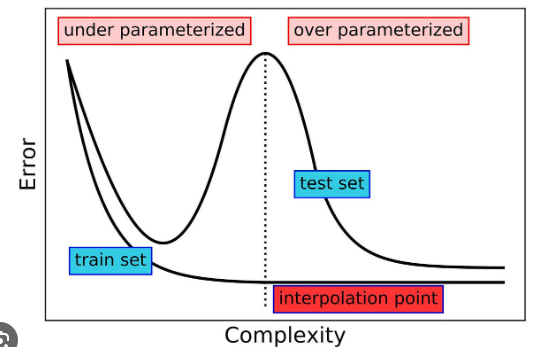

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'double_descent_III.png'))

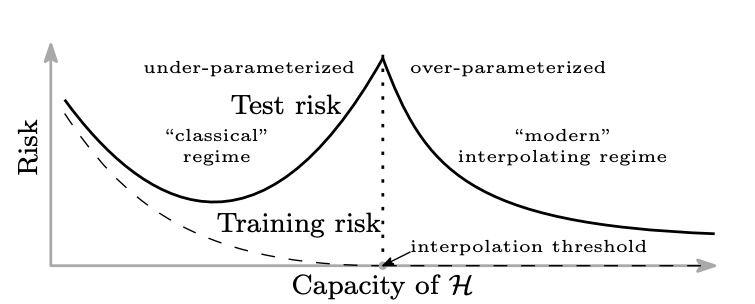

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'double_descent_I.png'))

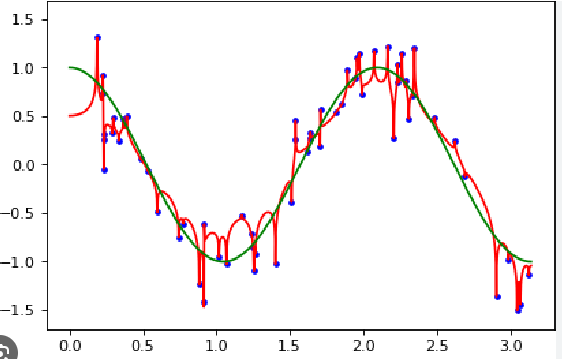

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'interpolation_estimators_II.png'))

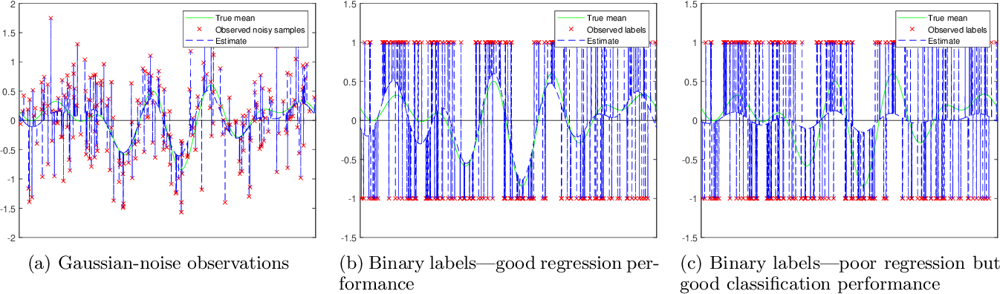

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'interpolation_estimators_I.png'))

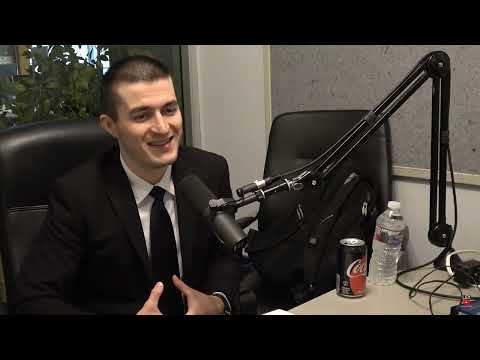

In [ ]:
from IPython.display import YouTubeVideo
# https://www.youtube.com/watch?v=W_TAKJRgrbs
YouTubeVideo('W_TAKJRgrbs', width=900, height=600)

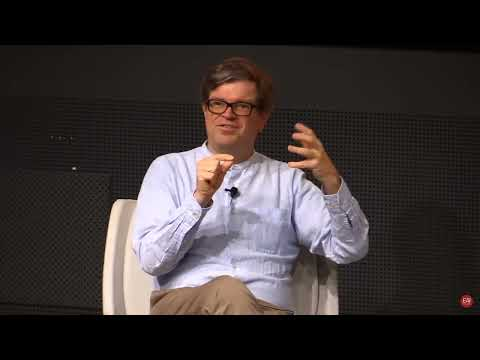

In [ ]:
from IPython.display import YouTubeVideo
# https://www.youtube.com/watch?v=5I7-ItaOZFU
YouTubeVideo('5I7-ItaOZFU', width=900, height=600)

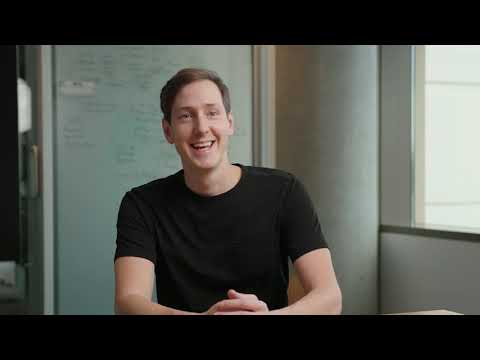

In [ ]:
from IPython.display import YouTubeVideo
# https://www.youtube.com/watch?v=ujMvnQpP528
YouTubeVideo('ujMvnQpP528', width=900, height=600)

- <a href="https://arxiv.org/abs/1912.02292">Deep Double Descent: Where Bigger Models and More Data Hurt by Ilya Sutskever, et al.</a>

- <a href="https://openai.com/research/deep-double-descent">OpenAI: Deep Double Descent</a>

$\rule{800pt}{20pt}$

$\rule{800pt}{20pt}$

# Virtue of Complexity in Return Prediction: Empirical Evidence from Market Timing
<br>
<font size="+1">
    <ul>
        <li>Most portfolio managers and quants realize empirically that you need complex models to predict well out-of-sample.</li>
        <br>
        <li>Intuitively, it feels like thousands of features, multiple horizons, highly nonlinear models, sophisticated optimization with a large number of constraints, and models with numerous parameters and hyperparameters may be overkill.</li>
        <br>
        <li>But empirically, most will quickly find that it's optimal if not necessary in context of live trading; at least when you have massive cross-sections or very fine-grained data.</li>
        <br>
        <li>It turns out this hard-earned experience is now something that you can mathematically prove.</li>
        <br>
        <li><b>The virtue of complexity refers to a theorem that says under sufficient regularity conditions on the signal covariance matrix, and under sufficient regularization of the predictive model, the Sharpe ratio and the out-of-sample $R^2$ are increasing and concave functions of a measure of model complexity.</b></li>
        <br>
    </ul>
</font>

$\square$

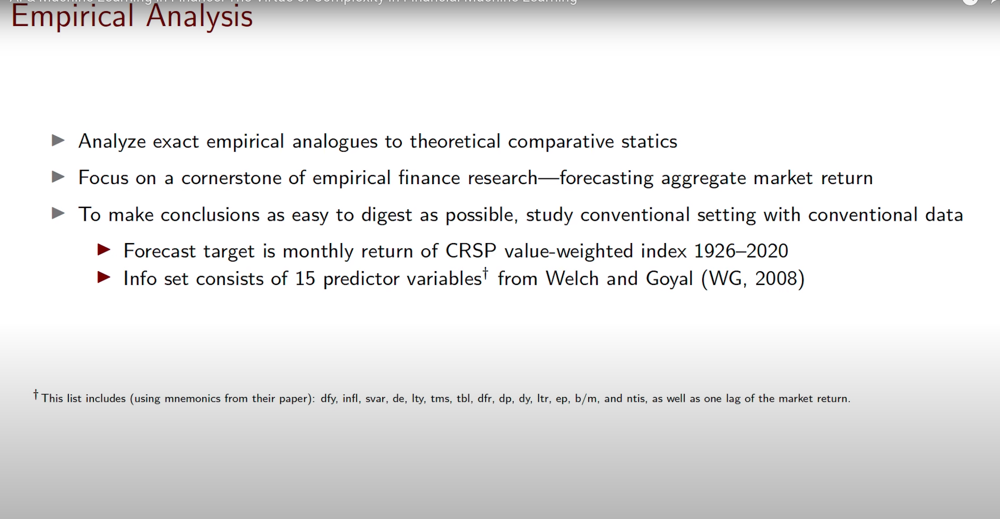

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_solution_empirical_investigation_I.png'))

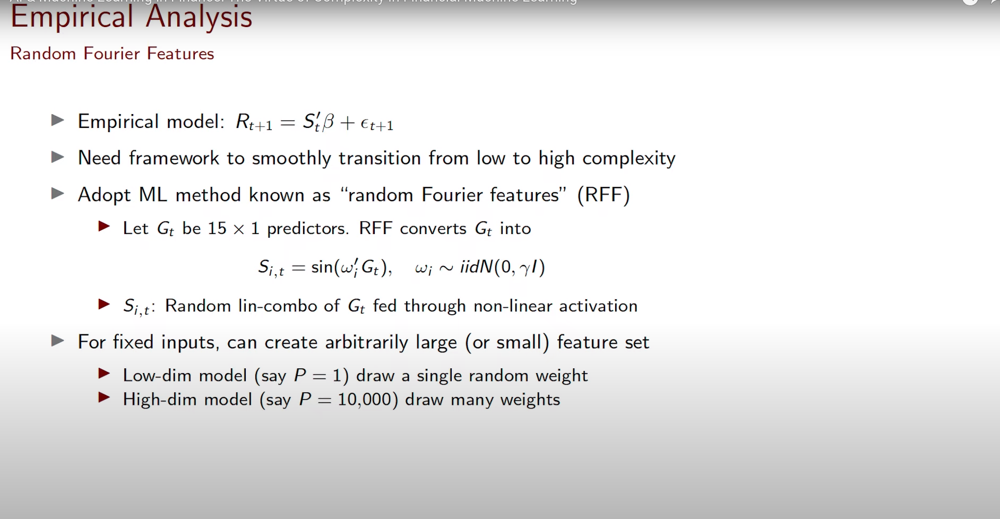

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_solution_empirical_investigation_II.png'))

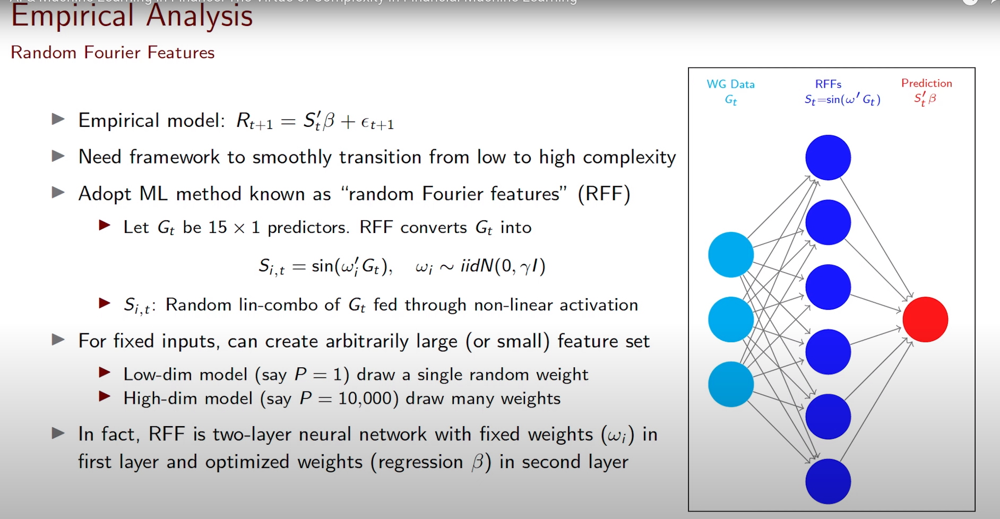

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_solution_empirical_investigation_III.png'))

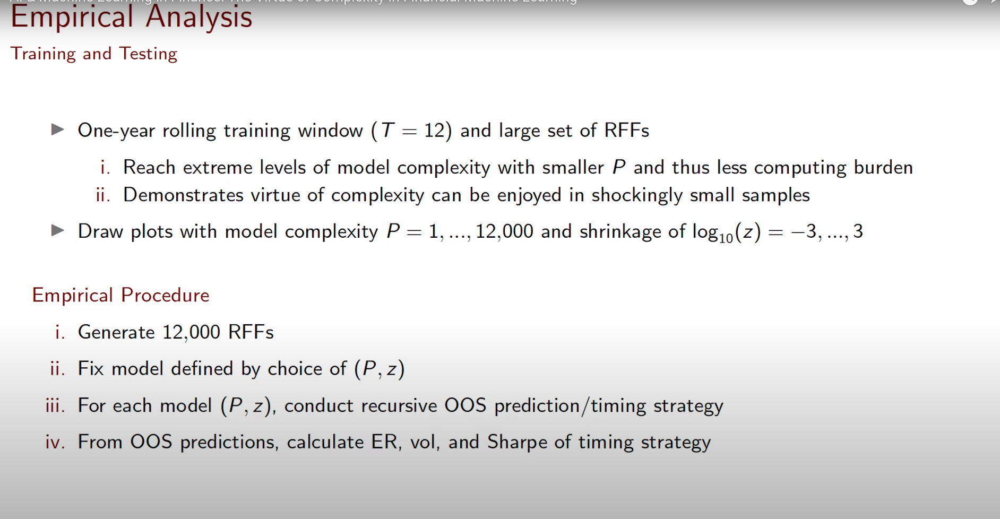

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_solution_empirical_investigation_IV.png'))

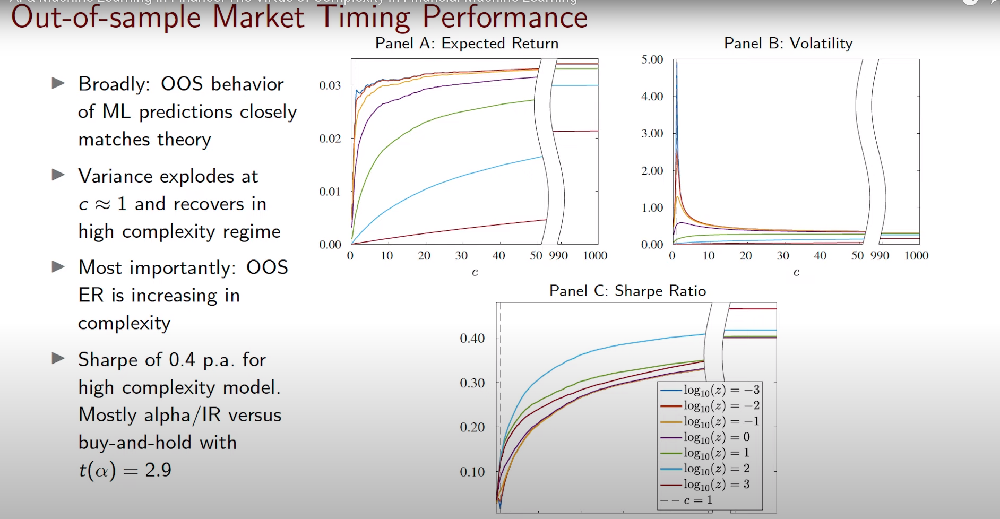

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_solution_empirical_investigation_V.png'))

## Data
<br>
<font size="+1">
    <ul>
        <li>The forecast target is the monthly return of the CRSP (Center for Research in Security Prices) S&P 500 value-weighted index. When you take the S&P 500 and subtract some measure of the risk-free rate, this target is called equity risk premium.</li>
        <br>
        <li>The features consist of 15 variables that are known to predict the stock market returns over time. They are fairly well known both in industry and in academia, and they were compiled by Goyal and Welch (2008).</li>
        <br>
        <li>The data sample ranges from 1926 to 2020.</li>
        <br>
        <li><details><summary>The following is a description of the variables from the 2008 Goyal & Welch paper.</summary>
        <br>
        <li>Variables used to construct the target variable.</li>
        <br>
        <ul>
          <li><b>Stock Returns:</b> We use S&P 500 index returns from 1926 to 2005 from Center for Research in Security Prices (CRSP) month-end values. Stock returns are the continuously compounded returns on the S&P 500 index, including dividends. For yearly and longer data frequencies, we can go back as far as 1871, using data from Robert Shiller's website. For monthly frequency, we can only begin in the CRSP period, that is, 1927.</li>
          <br>
          <li><b>Risk-free Rate:</b> The risk-free rate from 1920 to 2005 is the Treasury-bill rate. Treasury bills (or T-bills) are U.S. debt securities that mature over a time period of four weeks to one year. The most common terms for T-bills are for four, eight, 13, 17, 26 and 52 weeks. Because there was no risk-free short-term debt prior to the 1920s, we had to estimate it. Commercial paper rates for New York City are from the National Bureau of Economic Research (NBER) Macrohistory database. These are available from 1871 to 1970. We estimated a regression from 1920 to 1971, which yielded $$\text{Treasury-bill rate} = -0.004 + 0.886 \times \text{Commercial Paper Rate},$$ with an $R^2$ of $95.7\%$. Therefore, we <b>instrumented</b> the risk-free rate from 1871 to 1919 with the predicted regression equation. The correlation for the period 1920 to 1971 between the equity premium computed using the actual Treasury-bill rate and that computed using the predicted Treasury-bill rate (using the commercial paper rate) is $99.8\%$.</li>
          <br>
          <li>The equity premium had a mean (standard deviation) of $4.85\% (17.79%)$ over the entire sample from 1872 to 2005; $6.04\% (19.17\%)$ from 1927 to 2005; and $4.03\% (15.70\%)$ from 1965 to 2005.</li>
          <br>
        </ul>
        <li>Our first set of independent variables are primarily stock characteristics.</li>
        <br>
        <ul>
          <li><b>Dividends:</b> Dividends are 12-month moving sums of dividends paid on the S&P 500 index. The data are from Robert Shiller's website from 1871 to 1987. Dividends from 1988 to 2005 are from the S&P Corporation. The <b>Dividend Price Ratio (d/p)</b> is the difference between the log of dividends and the log of prices. The <b>Dividend Yield (d/y)</b> is the difference between the log of dividends and the log of lagged prices. (<i>See, e.g., Ball (1978), Campbell (1987), Campbell and Shiller (1988a, 1988b), Campbell and Viceira (2002), Campbell and Yogo (2006), the survey in Cochrane (1997), Fama and French (1988), Hodrick (1992), Lewellen (2004), Menzly, Santos, and Veronesi (2004), Rozeff (1984), and Shiller (1984).</i>)</li>
          <br>
          <li><b>Earnings:</b> Earnings are 12-month moving sums of earnings on the S&P 500 index. The data are again from Robert Shiller's website from 1871 to 1987. Earnings from 1988 to 2005 are our own estimates based on 1457 interpolation of quarterly earnings provided by the S&P Corporation. The <b>Earnings Price Ratio (e/p)</b> is the difference between the log of earnings and the log of prices. (We also consider variations, in which we explore multiyear moving averages of numerator or denominator, e.g., as in e10/p, which is the moving ten-year average of earnings divided by price.) The <b>Dividend Payout Ratio (d/e)</b> is the difference between the log of dividends and the log of earnings. (<i>See, e.g., Campbell and Shiller (1988a, 1998) and Lamont (1998).</i>)</li>
          <br>
          <li><b>Stock Variance (svar):</b> Stock Variance is computed as sum of squared daily returns on the S&P 500. G. William Schwert provided daily returns from 1871 to 1926; data from 1926 to 2005 are from CRSP. (<i>See Guo (2006).</i>)</li>
          <br>
          <li><b>Cross-Sectional Premium (csp):</b> The cross-sectional beta premium measures the relative valuations of high- and low-beta stocks and is proposed in Polk, Thompson, and Vuolteenaho (2006). The csp data are from Samuel Thompson from May 1937 to December 2002.</li>
          <br>
          <li>Book Value : Book values from 1920 to 2005 are from Value Line's website, specifically their Long-Term Perspective Chart of the Dow Jones Industrial Average. The <b>Book-to-Market Ratio (b/m)</b> is the ratio of book value to market value for the Dow Jones Industrial Average. For the months from March to December, this is computed by dividing book value at the end of the previous year by the price at the end of the current month. For the months of January and February, this is computed by dividing book value at the end of two years ago by the price at the end of the current month. (<i>See, e.g, Kothari and Shanken (1997) and Pontiff and Schall (1998).</i>)</li>
          <br>
          <li><b>Corporate Issuing Activity:</b> We entertain two measures osf corporate issuing activity. <b>Net Equity Expansion (ntis)</b> is the ratio of 12-month moving sums of net issues by NYSE listed stocks divided by the total end-of-year market capitalization of NYSE stocks. This dollar amount of net equity issuing activity (IPOs, SEOs, stock repurchases, less dividends) for NYSE listed stocks is computed from CRSP data as $$\text{Net Issue}_t = \text{Mcap}_t - \text{Mcap}_{t - 1} \times (1 + \text{vwretx}_t) ,$$ where Mcap is the total market capitalization, and vwretx is the value weighted return (excluding dividends) on the NYSE index. These data are available from 1926 to 2005. ntis is closely related, but not identical, to a variable proposed in Boudoukh, Michaely, Richardson, and Roberts (2007). The second measure, <b>Percent Equity Issuing (eqis)</b>, is the ratio of equity issuing activity as a fraction of total issuing activity. This is the variable proposed in Baker and Wurgler (2000). The authors provided us with the data, except for 2005, which we added ourselves. This calculation implicitly assumes that the delisting return is -100 percent. Using the actual delisting return, where available, or ignoring delistings altogether, has no impact on our results. The first equity issuing measure is relative to aggregate market cap, while the second is relative to aggregate corporate issuing.</li>
          <br>
        </ul>
        <li>Our next set of independent variables is interest-rate related.</li>
        <br>
        <ul>
          <li><b>Treasury Bills (tbl):</b> Treasury-bill rates from 1920 to 1933 are the U.S. Yields On Short-Term United States Securities, Three-Six Month Treasury Notes and Certificates, ThreeMonth Treasury series in the NBER Macrohistory data base. Treasury-bill rates from 1934 to 2005 are the 3-Month Treasury Bill: SecondaryMarket Rate from the economic research data base at the Federal Reserve Bank at St. Louis (FRED). (<i>See, e.g., Campbell (1987) and Hodrick (1992).</i>)</li>
          <br>
          <li><b>Long Term Yield (lty):</b> Our long-term government bond yield data from 1919 to 1925 is the U.S. Yield On Long-Term United States Bonds series in the NBER's Macrohistory data base. Yields from 1926 to 2005 are from Ibbotson's Stocks, Bonds, Bills and Inflation Yearbook, the same source that provided the <b>Long Term Rate of Returns (ltr)</b>. The <b>Term Spread (tms)</b> is the difference between the long term yield on government bonds and the Treasury-bill. (<i>See, e.g., Campbell (1987) and Fama and French (1989).</i>)</li>
          <br>
          <li><b>Corporate Bond Returns:</b> Long-term corporate bond returns from 1926 to 2005 are again from Ibbotson's Stocks, Bonds, Bills and Inflation Yearbook. Corporate Bond Yields on AAA and BAA-rated bonds from 1919 to 2005 are from FRED. The <b>Default Yield Spread (dfy)</b> is the difference between BAA and AAA-rated corporate bond yields. The <b>Default Return Spread (dfr)</b> is the difference between long-term corporate bond and long-term government bond returns. (<i>See, e.g., Fama and French (1989) and Keim and Stambaugh (1986).</i>)</li>
          <br>
          <li><b>Inflation (infl):</b> Inflation is the Consumer Price Index (All Urban Consumers) from 1919 to 2005 from the Bureau of Labor Statistics. Because inflation information is released only in the following month, we wait for one month before using it in our monthly regressions. <i>See, e.g., Campbell and Vuolteenaho (2004), Fama (1981), Fama and Schwert (1977), and Lintner (1975).</i>)</li>
          <br>
        </ul>
        <li>Like inflation, our next variable is also a common broad macroeconomic indicator.</li>
        <br>
        <ul>
          <li><b>Investment to Capital Ratio (i/k):</b> The investment to capital ratio is the ratio of aggregate (private nonresidential fixed) investment to aggregate capital for the whole economy. This is the variable proposed in Cochrane (1991). John Cochrane kindly provided us with updated data. Of course, many articles explore multiple variables. For example, Ang and Bekaert (2003) explore both interest rate and dividend related variables. In addition to simple univariate prediction models, we also entertain two methods that rely on multiple variables (all and ms), and two models that are rolling in their independent variable construction (cay and ms).</li>
          <br>
        </ul>
</li></details></li>
        <br>
        </ul>
    </ul>
</font>

$\square$

In [ ]:
# CRSP_SPvw includes dividends
# CRSP_SPvwx excluding dividends

# Note: Rapach, Zhou, Strauss calculate the equity premium using CRSP_SPvw (includes dividends) and lagged risk free rate
# Note: Goyal, Welch (2008) use Index and D12 and current risk free rate (not sure if they use lagged risk free rate or "current")

# This data list includes:
# b/m (book to market ratio),
# de (dividend payout ratio),
# dfr (default return spread; used to measure corporate bond returns relative to government bond returns),
# dfy (default yield spread; difference between BAA and AAA-rated corporate bond yields),
# dp (dividend price ratio),
# dy (dividend yield),
# ep (earnings price ratio),
# infl (inflation measured through the consumer price inded CPI),
# ltr (long-term bond rate of returns),
# lty (long-term bond yield),
# ntis (net equity expansion; a measure of corporate issuing activity),
# svar (stock variance),
# tbl (treasury bills),
# tms (term-spread),
# as well as one lag of the market return



COLUMNS = ["b/m", "de", "dfr", "dfy", "dp", "dy", "ep", "infl", "ltr", "lty", "ntis", "svar", "tbl", "tms", "returns_lag_1", "returns"]


# def load_nber(data_path, file_name):
#     """Used to create a data set that you can use to investigate trends around recessions and other business cycles."""
#     nber = pd.read_csv(os.path.join(data_path, file_name))[1:]
#     nber["peak"] = pd.to_datetime(nber["peak"])
#     nber["trough"] = pd.to_datetime(nber["trough"])
#     return nber

def load_data(data_path, file_name):
    data_raw = pd.read_csv(os.path.join(data_path, file_name))
    data_raw["yyyymm"] = pd.to_datetime(data_raw["yyyymm"], format='%Y%m', errors='coerce')
    data_raw["Index"] = data_raw["Index"].str.replace(",", "")
    data_raw.set_index("yyyymm", inplace=True)
    data_raw[data_raw.columns] = data_raw[data_raw.columns].astype(float)
    data_raw.rename(columns={"Index":"prices"}, inplace=True)

    # Calculate missing columns according to the explaination in m Welch and Goyal (2008)
    data_raw["dfy"] = data_raw["BAA"] - data_raw["AAA"]
    data_raw["tms"] = data_raw["lty"] - data_raw["tbl"]
    data_raw["de"] = np.log(data_raw["D12"]) - np.log(data_raw["E12"])
    data_raw["dfr"] = data_raw["corpr"] - data_raw["ltr"]
    data_raw["lag_prices"] = data_raw["prices"].shift()
    data_raw["dp"] = np.log(data_raw["D12"]) - np.log(data_raw["prices"])
    data_raw["dy"] = np.log(data_raw["D12"]) - np.log(data_raw["lag_prices"])
    data_raw["ep"] = np.log(data_raw["E12"])  - np.log(data_raw["prices"])

    # All the variables should be lagged by at least one period so we are using a predictive regression, and not an explanatory / contemporaneous regression
    data_raw = data_raw.shift().copy()

    data_raw["returns"] = data_raw["CRSP_SPvw"] # data_raw["prices"].pct_change() # Maybe use CRSP_SPvw - Value weighted return
    data_raw["returns_lag_1"] = data_raw["returns"].shift()
    # returns = data_raw["returns"].copy()

    data = data_raw[COLUMNS].dropna()
    # returns = returns[returns.index.isin(data.index)]
    return data # , returns

In [ ]:
# nber_data = load_nber(data_path, 'NBER_Cycle_Dates.csv') # if you want to investigate what the strategy does around recessions and other business cycles

data = load_data(data_path, 'Predictor_Data_Monthly_2022.csv')

In [ ]:
data

,b/m,de,dfr,dfy,dp,dy,ep,infl,ltr,lty,ntis,svar,tbl,tms,returns_lag_1,returns
yyyymm,,,,,,,,,,,,,,,,
1927-01-01,0.441476,-0.586175,-0.0022,0.0100,-2.973012,-2.956570,-2.386837,0.000000,0.0078,0.0354,0.050876,0.000465,0.0307,0.0047,0.026937,0.026047
1927-02-01,0.443706,-0.567601,-0.0019,0.0095,-2.942374,-2.963349,-2.374773,-0.011299,0.0075,0.0351,0.050824,0.000470,0.0323,0.0028,0.026047,-0.002910
1927-03-01,0.428501,-0.549182,-0.0019,0.0092,-2.979535,-2.932946,-2.430353,-0.005714,0.0088,0.0347,0.051668,0.000287,0.0329,0.0018,-0.002910,0.045522
1927-04-01,0.469765,-0.531456,-0.0170,0.0092,-2.976535,-2.970053,-2.445079,-0.005747,0.0253,0.0331,0.046357,0.000924,0.0320,0.0011,0.045522,0.007324
1927-05-01,0.456754,-0.512916,0.0060,0.0090,-2.984225,-2.967143,-2.471309,0.000000,-0.0005,0.0333,0.050514,0.000603,0.0339,-0.0006,0.007324,0.013021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-01,0.218187,-1.083898,0.0054,0.0115,-4.160174,-4.072973,-3.076276,-0.000118,0.0270,0.0290,-0.006121,0.003188,0.0223,0.0067,-0.081683,0.093766
2022-09-01,0.227429,-1.068101,0.0128,0.0108,-4.110113,-4.153480,-3.042012,-0.000354,-0.0421,0.0290,-0.009732,0.003349,0.0263,0.0027,0.093766,-0.040305
2022-10-01,0.249478,-1.052264,0.0243,0.0110,-4.005414,-4.103464,-2.953150,0.002151,-0.0769,0.0352,-0.011292,0.004934,0.0313,0.0039,-0.040305,-0.091495


In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
b/m,1152.0,0.552159,0.268291,0.120510,0.323772,0.529101,0.738709,2.028478
de,1152.0,-0.647478,0.327729,-1.244209,-0.869869,-0.636278,-0.501955,1.379530
dfr,1152.0,0.000452,0.014086,-0.097600,-0.005100,0.000600,0.005900,0.073700
dfy,1152.0,0.011160,0.006781,0.003200,0.007000,0.009000,0.013025,0.056400
dp,1152.0,-3.408696,0.476560,-4.523640,-3.846171,-3.374830,-3.043790,-1.873246
dy,1152.0,-3.403723,0.474459,-4.530894,-3.837779,-3.366198,-3.039178,-1.912904
ep,1152.0,-2.761218,0.420533,-4.836482,-2.986049,-2.810402,-2.481701,-1.774952
infl,1152.0,0.002467,0.005266,-0.020548,0.000000,0.002419,0.005081,0.058824
ltr,1152.0,0.004489,0.024952,-0.112400,-0.007625,0.003000,0.016100,0.152300
lty,1152.0,0.049656,0.028082,0.006200,0.027400,0.041000,0.067325,0.148200


In [ ]:
data.corr()

,b/m,de,dfr,dfy,dp,dy,ep,infl,ltr,lty,ntis,svar,tbl,tms,returns_lag_1,returns
b/m,1.000000,0.321992,-0.018015,0.470278,0.856144,0.850224,0.719272,0.079271,0.009850,0.193946,0.032674,0.168351,0.199496,-0.051681,-0.066065,-0.046667
de,0.321992,1.000000,0.079232,0.532143,0.504755,0.501938,-0.207317,-0.227249,-0.014028,-0.232012,0.149345,0.354825,-0.298266,0.203190,-0.028269,-0.014731
dfr,-0.018015,0.079232,1.000000,0.020125,-0.020064,-0.000065,-0.084483,0.028621,-0.464968,-0.013959,0.013728,-0.134023,-0.044052,0.074135,0.105883,0.176028
dfy,0.470278,0.532143,0.020125,1.000000,0.404732,0.400134,0.043944,-0.237192,0.073446,0.066711,-0.180011,0.535255,-0.060586,0.288617,-0.107358,-0.011734
dp,0.856144,0.504755,-0.020064,0.404732,1.000000,0.993535,0.739863,-0.031318,0.000820,0.007631,0.239645,0.166526,0.042364,-0.083878,-0.065032,-0.057368
dy,0.850224,0.501938,-0.000065,0.400134,0.993535,1.000000,0.734733,-0.029415,0.009206,0.006936,0.232634,0.137812,0.041209,-0.082651,-0.056418,0.055722
ep,0.719272,-0.207317,-0.084483,0.043944,0.739863,0.734733,1.000000,0.141610,0.011862,0.189460,0.155185,-0.087810,0.280452,-0.253403,-0.051666,-0.053531
infl,0.079271,-0.227249,0.028621,-0.237192,-0.031318,-0.029415,0.141610,1.000000,-0.102512,0.215544,-0.056484,-0.204887,0.247157,-0.117775,0.037878,0.007432
ltr,0.009850,-0.014028,-0.464968,0.073446,0.000820,0.009206,0.011862,-0.102512,1.000000,0.056426,-0.046408,0.092892,0.054060,-0.005597,-0.079497,0.076150
lty,0.193946,-0.232012,-0.013959,0.066711,0.007631,0.006936,0.189460,0.215544,0.056426,1.000000,-0.062641,-0.104896,0.906785,0.022438,-0.005148,-0.011348


In [ ]:
(abs(data.corr()[['returns']])).sort_values(by='returns', ascending=False)

,returns
returns,1.000000
svar,0.207513
dfr,0.176028
returns_lag_1,0.076971
ltr,0.076150
ntis,0.069922
dp,0.057368
dy,0.055722
ep,0.053531
b/m,0.046667


<Axes: xlabel='yyyymm'>

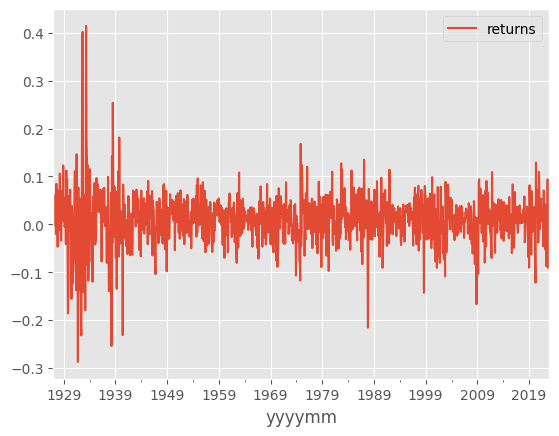

In [ ]:
data[['returns']].plot()

<Axes: xlabel='yyyymm'>

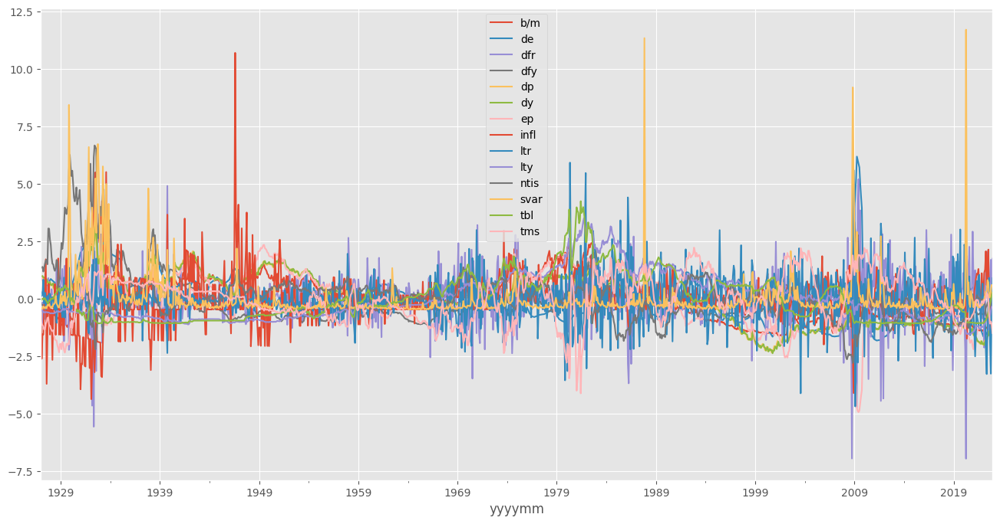

In [ ]:
((data.iloc[:, :-2] - data.iloc[:, :-2].mean()) / data.iloc[:, :-2].std()).plot(figsize=(16,8))

In [ ]:
# percentage of the data used to train in a time-series split
training_percentage = 0.9

# number of samples, number of training samples, number of years in training set, number of years in testing set
data.shape[0], round(data.shape[0]* training_percentage), round(data.shape[0]* training_percentage) / 12, (data.shape[0] - round(data.shape[0]* training_percentage)) / 12

(1152, 1037, 86.41666666666667, 9.583333333333334)

In [ ]:
# split data sample into (X_{t-1}, Y_t)
X = data.drop(columns=['returns'])
Y = data[['returns']]

# split (X_{t-1}, Y_t) into time-series training and testing sets
X_train = X.iloc[0: round(data.shape[0]* training_percentage)]
X_test = X.iloc[round(data.shape[0]* training_percentage):]

Y_train = Y.iloc[0: round(data.shape[0]* training_percentage)]
Y_test = Y.iloc[round(data.shape[0]* training_percentage):]

##########################################################################################
##########################################################################################
##########################################################################################

X_sub_train = X_train.iloc[0: round(X_train.shape[0]* training_percentage)]
Y_sub_train = Y_train.iloc[0: round(X_train.shape[0]* training_percentage)]

X_validation = X_train.iloc[round(X_train.shape[0]* training_percentage):]
Y_validation = Y_train.iloc[round(X_train.shape[0]* training_percentage):]



## NOTE: in practice, you would do rolling predictions where you build a sequence of models, rather than just a single model at a single time-series split.

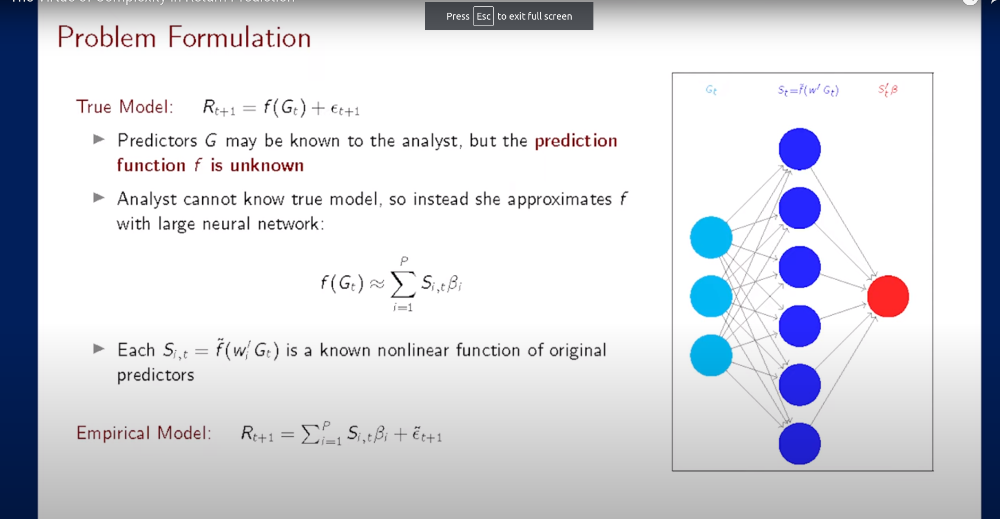

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction.png'))

$\rule{800pt}{20pt}$

# Implementing MLPs with <a href="https://keras.io/api/">Keras API</a>
<br>
<font size="+1">
  <ul>
    <li><a href="https://www.tensorflow.org/guide/keras">Keras is TensorFlow's high-level deep learning API</a> that allows you to build, train, evaluate, and execute all sorts of neural networks; TensorFlow and Keras were open-sourced by Google.</li>
    <br>
    <li>Another popular deep learning library includes <a href="https://pytorch.org/">PyTorch</a>, which was open-sourced by Facebook / Meta.</li>
    <br>
  </ul>
</font>
$̇\square$

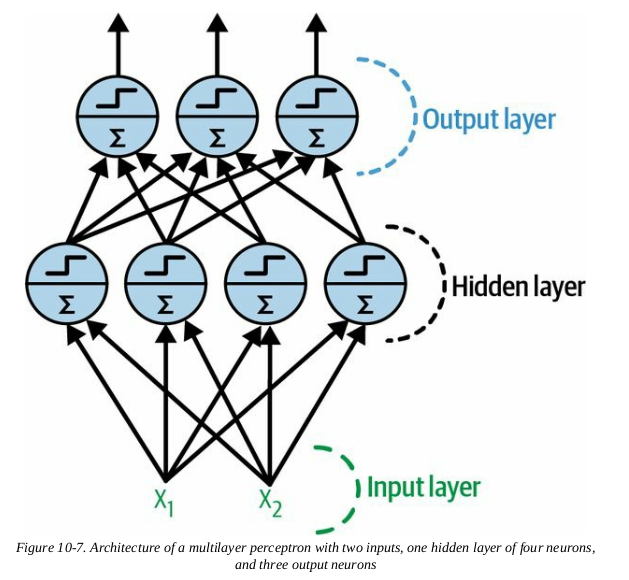

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'multi_layer_perceptron.png'))

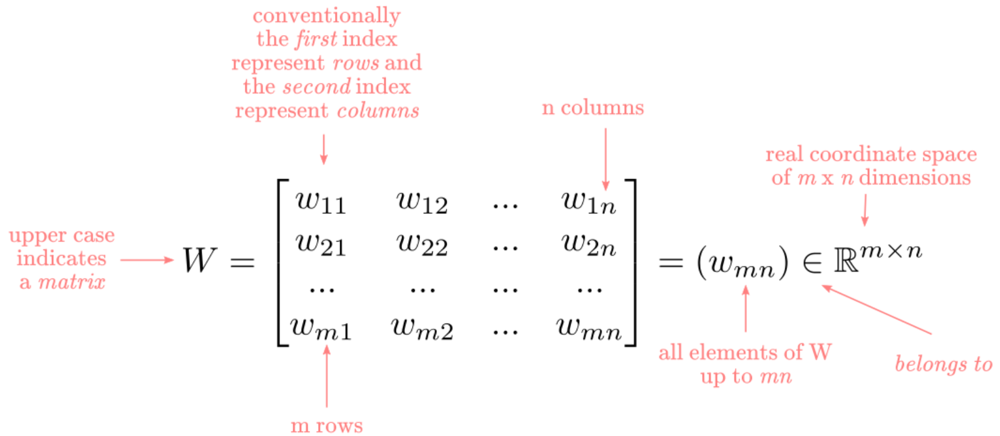

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'weight_matrix_for_dense_networks.png'))

## The Multi-Layer Perceptron Algorithm
<br>
<font size="+1">
  <ul>
    <li>A multi-layer perceptron, more commonly referred to as a <b>dense neural network</b> or a <b>fully-connected feed-forward neural network</b>, is composed of one <b>input layer</b>, one or more layers called <b>hidden layers</b>, which consists of neurons / units, and one final layer of units called the <b>output layer</b>.</li>
    <br>
    <li>The layers close to the input layer are usually called the <b>lower layers</b> and the ones close to the outputs are usually called the <b>upper layers</b>.</li>
    <br>
  </ul>
</font>
$̇\square$

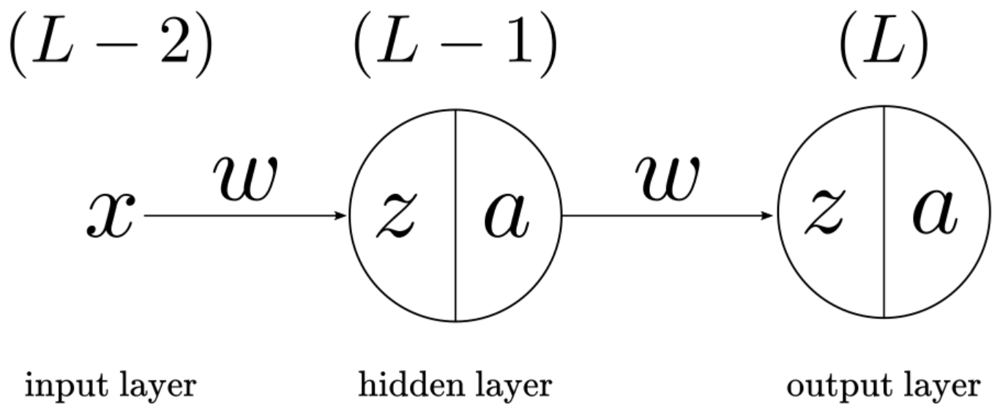

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'general_structure_for_dense_neural_network_input_hidden_output.png'))

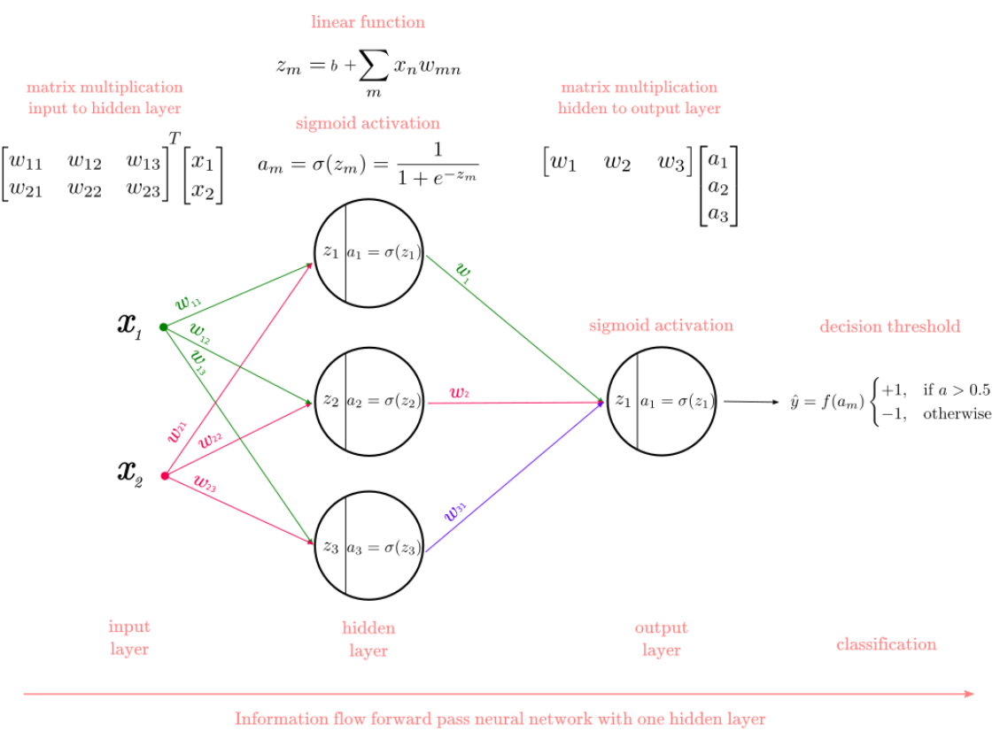

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'two_layer_dense_neural_network.png'))

<br>
<font size="+1">
  <ul>
    <li>These dense neural networks can be expressed quantitatively as the linear regressions repeatedly plugged into nonlinear activation functions over and over again until the final layer.</li>
    <br>
    <ul>
      <li>Consider a two-layer dense neural network: $$\widehat{R_{t+1}} = \sum_{i=1}^p \beta_i \ \sigma\left(w_i^T X_t\right) \approx R_{t+1}.$$</li>
      <br>
      <li><b>More generally, a dense neural network, which can capture the non-linear relations and high-dimensional relations between the input variables and the targets, can be expressed as:</b> $$ \sigma_{L}(W_L\sigma_{L-1}(W_{L-1}\sigma_{L-2}(W_{L-2} \cdots \sigma_2(W_2 \sigma_1(W_1\mathbf{X})) \cdots ))).$$</li>
      <br>
      <li>Note, when the target variable is a continuous variable, i.e. a regression prediction problem, then the terminal activation function is $$\sigma_L(h) = h.$$</li>
      <br>
    </ul>
    <br>
  </ul>
</font>
$̇\square$

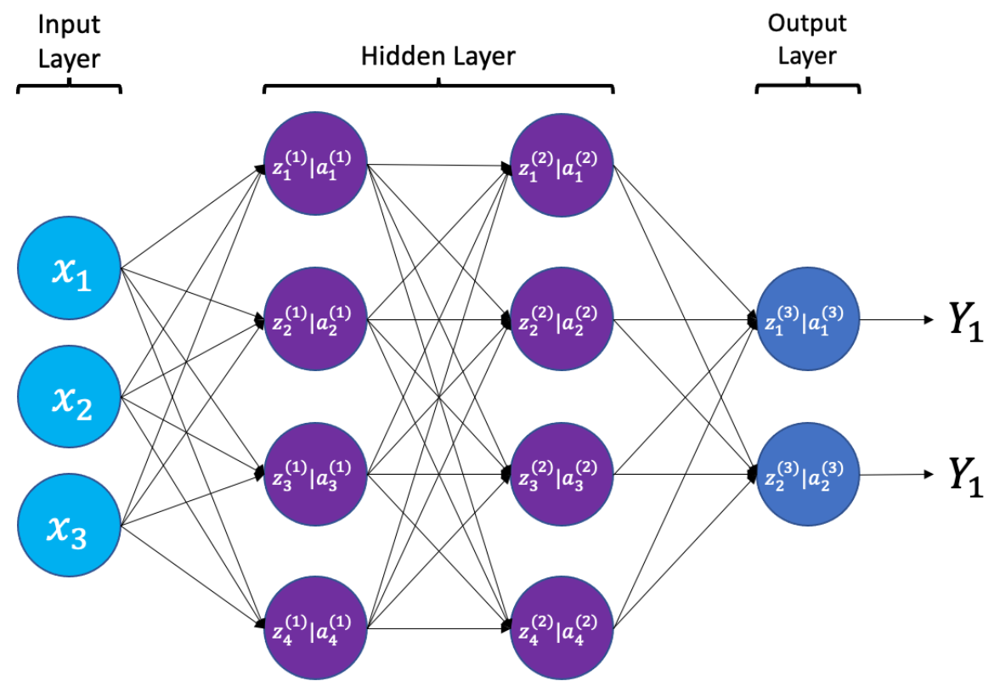

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'dense_neural_network_1.png'))

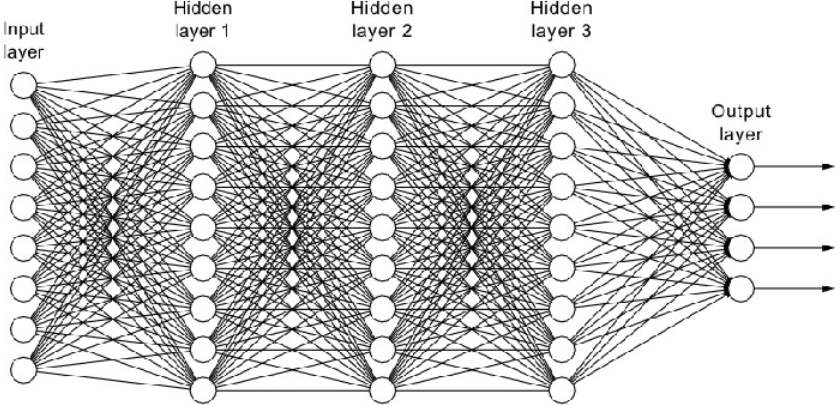

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'dense_neural_network_2.png'))

<br>
<font size="+1">
  <ul>
    <li>The <b>signal</b> flows only in one direction (from the inputs to the outputs), which is why this architecture frequently called a <b>feed-forward neural network</b>.</li>
    <br>
    <li>When a neural network contains a deep stack of hidden layers, it is called a deep neural network (DNN).</li>
    <br>
    <li>In the 1990s, a NN with more than two hidden layers was considered deep.</li>
    <br>
    <li>Currently, it is common to see NNs with dozens of layers, or even hundreds.</li>
    <br>
  </ul>
</font>
$̇\square$

$\rule{800pt}{20pt}$

In [ ]:
X_train

,b/m,de,dfr,dfy,dp,dy,ep,infl,ltr,lty,ntis,svar,tbl,tms,returns_lag_1
yyyymm,,,,,,,,,,,,,,,
1927-01-01,0.441476,-0.586175,-0.0022,0.0100,-2.973012,-2.956570,-2.386837,0.000000,0.0078,0.0354,0.050876,0.000465,0.0307,0.0047,0.026937
1927-02-01,0.443706,-0.567601,-0.0019,0.0095,-2.942374,-2.963349,-2.374773,-0.011299,0.0075,0.0351,0.050824,0.000470,0.0323,0.0028,0.026047
1927-03-01,0.428501,-0.549182,-0.0019,0.0092,-2.979535,-2.932946,-2.430353,-0.005714,0.0088,0.0347,0.051668,0.000287,0.0329,0.0018,-0.002910
1927-04-01,0.469765,-0.531456,-0.0170,0.0092,-2.976535,-2.970053,-2.445079,-0.005747,0.0253,0.0331,0.046357,0.000924,0.0320,0.0011,0.045522
1927-05-01,0.456754,-0.512916,0.0060,0.0090,-2.984225,-2.967143,-2.471309,0.000000,-0.0005,0.0333,0.050514,0.000603,0.0339,-0.0006,0.007324
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-01-01,0.349032,-1.018340,0.0140,0.0098,-3.820842,-3.813798,-2.802502,-0.002693,-0.0202,0.0246,-0.011549,0.001036,0.0007,0.0239,0.005326
2013-02-01,0.329984,-1.013728,0.0019,0.0093,-3.860852,-3.811654,-2.847124,0.002957,-0.0332,0.0291,-0.008017,0.000907,0.0007,0.0284,0.008508
2013-03-01,0.325431,-1.009180,-0.0021,0.0095,-3.862751,-3.851751,-2.853571,0.008190,0.0114,0.0285,-0.008864,0.001243,0.0010,0.0275,0.052361


In [ ]:
Y_train

,returns
yyyymm,
1927-01-01,0.026047
1927-02-01,-0.002910
1927-03-01,0.045522
1927-04-01,0.007324
1927-05-01,0.013021
...,...
2013-01-01,0.008508
2013-02-01,0.052361
2013-03-01,0.013013


## <h2>Building a Regression Dense Neural Network with the Sequential API</h2>
<br>
<font size="+1">
  <ul>
    <li><b>How can we actually build these complicated objects?</b></li>
    <br>
    <li>If we are using dense neural networks for regression tasks where we only need to predict a single value, say market return, then the output layer only requires a single output unit.</li>
    <br>
    <li>If we wanted to predict many different returns of stocks, then we would need one output unit for each output dimension.</li>
    <br>
    <ul>
      <li>For example, if you wanted to locate the center of an object in an image, you need to predict 2D coordinates, so you need two output units.</li>
      <br>
      <li>If you want to place a bounding box around the object, then you need two more numbers: the width and the height of the object $\implies$ you will end up with four output units.</li>
      <br>
    </ul>
    <li>Before you start, it might not be clear how to <i>initialize</i> your neural network; i.e. how many hidden layers should you use, how many neurons per hidden layer, what activation function should you use for the hidden layers and the output layer, what loss function should you use, etc.?</li>
    <br>
    <li>These decisions are known as <b>hyperparameters</b>.</li>
    <br>
    <li><table>
  <tr>
    <th>Hyperparameter</th>
    <th>Typical Value</th>
  </tr>
  <tr>
    <td>Number of hidden layers</td>
    <td>Depends on the problem, but typically 1 to 5 hidden layers</td>
  </tr>
  <tr>
    <td>Number of units per hidden layer</td>
    <td>Depends on the problem, but typically 10 to 100</td>
    <td></td>
  </tr>
  <tr>
    <td>Number of output units</td>
    <td>1 per prediction dimension</td>
  </tr>
  <tr>
    <td>Hidden layer activation functions</td>
    <td>ReLU</td>
  </tr>
  <tr>
    <td>Output layer activation function for regression</td>
    <td>None (linear), or ReLU / softplus (if positive outputs), or sigmoid / tanh (if bounded outputs) </td>
  </tr>
  <tr>
    <td>Loss function for regression</td>
    <td>MSE, MAE, or Huber if outliers</td>
  </tr>
</table>
  </ul>
</font>
$̇\square$

$\rule{800pt}{20pt}$

## An Aside: Dense NNs for Classification
<br>
<font size="+1">
  <ul>
    <li>We have predominantly discussed deep learning in the context of regression problems, but we frequently also want to classify data into discrete or categorical targets.</li>
    <br>
    <li>For binary classification problems, you just need a single output unit using the sigmoid activation function: the output will be a number between 0 and 1, which can be interpreted as the estimated probability of the positive class.</li>
    <br>
    <li>Recall: $$\text{Sigmoid}(z) = \frac{1} {1 + e^{-z}}$$</li>
    <br>
    <li>Dense neural networks can also easily handle multi-label binary classification tasks.</li>
    <br>
    <ul>
      <li>For example, you could have an email classification system that predicts whether each incoming email is valid or spam, and simultaneously classifies whether it is an urgent or non-urgent email.</li>
      <br>
      <li>In this case, you would need two output units, both using the sigmoid activation function, the first would output the probability of being spam and the second would output the probability of being urgent.</li>
      <br>
      <li>Note that the output probabilities do not necessarily add up to one.</li>
      <br>
    </ul>
    <li><b>If each observation can only belong to a single class, out of three or more possible classes, then you need to have one output unit per class, and you should use the softmax activation function for the whole output layer.</b></li>
    <br>
    <li>The softmax function will ensure that all the estimated probabilities are between 0 and 1 and that they add up to 1, since the classes are exclusive; this is known as <b>multi-class classification</b>.</li>
    <br>
    <li>Recall: $$ \text{Softmax}(z)_{i} = \frac{\exp(z_i)}{\sum_{j=1}^K \exp(x_j)} \ .$$</li>
    <br>
    <li>Also note that because we are predicting probability distributions, the loss function should be the cross-entropy loss function (log-loss): $$-{(y\log(\widehat{p}) + (1 - y)\log(1 - \widehat{p}))} \quad (\text{binary cross-entropy}),$$ or $$ -\sum_{k=1}^K y_{k}\log(\widehat{p_{k}}) \quad (\text{multi-class cross-entropy}).$$</li>
    <br>
    <li>Before you start, it might not be clear how to <i>initialize</i> your neural network; i.e. how many hidden layers should you use, how many neurons per hidden layer, what activation function should you use for the hidden layers and the output layer, what loss function should you use, etc.?</li>
    <br>
    <li>These decisions are known as <b>hyperparameters</b>.</li>
    <br>
    <li><table>
  <tr>
    <th>Hyperparameter</th>
    <th>Binary Classification</th>
    <th>Multi-Label Binary Classification</th>
    <th>Multi-Class Classification</th>
  </tr>
  <tr>
    <td>Number of hidden layers</td>
    <td>Depends on the problem, but typically 1 to 5 hidden layers</td>
    <td>Depends on the problem, but typically 1 to 5 hidden layers</td>
    <td>Depends on the problem, but typically 1 to 5 hidden layers</td>
  </tr>
  <tr>
    <td>Number of units per hidden layer</td>
    <td>Depends on the problem, but typically 10 to 100</td>
    <td>Depends on the problem, but typically 1 to 5 hidden layers</td>
    <td>Depends on the problem, but typically 1 to 5 hidden layers</td>
    <td></td>
  </tr>
  <tr>
    <td>Number of output units</td>
    <td>1</td>
    <td>1 per binary label</td>
    <td>1 per class</td>
  </tr>
  <tr>
    <td>Hidden layer activation functions</td>
    <td>ReLU</td>
    <td>ReLU</td>
    <td>ReLU</td>
  </tr>
  <tr>
    <td>Output layer activation function for classification</td>
    <td>Sigmoid</td>
    <td>Sigmoid</td>
    <td>Softmax</td>
  </tr>
  <tr>
    <td>Loss function for classification</td>
    <td>Cross-entropy</td>
    <td>Cross-entropy</td>
    <td>Cross-entropy</td>
  </tr>
</table>
  </ul>
</font>
$̇\square$

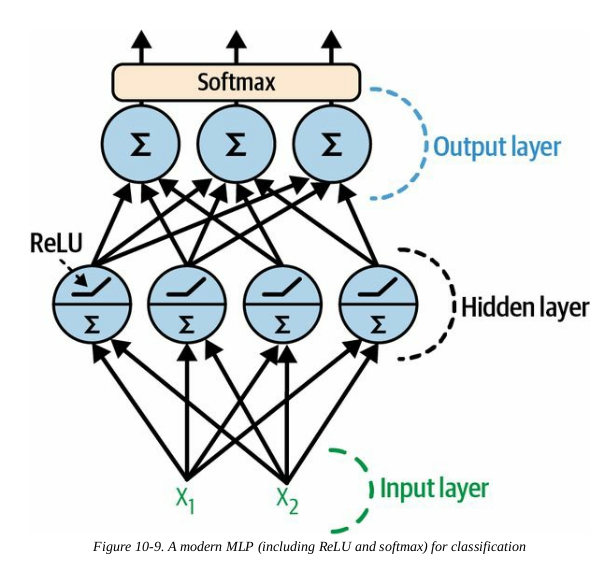

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'MLP_with_ReLu_and_Softmax.png'))

$\rule{800pt}{20pt}$

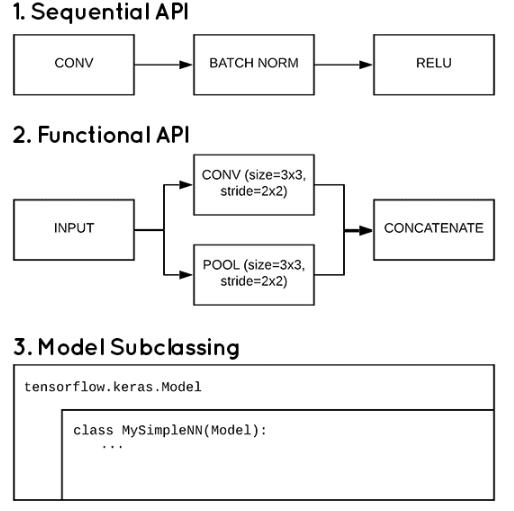

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'different_ways_to_build_models_in_Keras.png'))

## Building Complex Models with the <a href="https://keras.io/guides/sequential_model/">Sequential API</a>
<br>
<font size="+1">
  <ul>
    <li>A sequential model is appropriate for a plain stack of layers, where each layer has exactly one input tensor and one output tensor.</li>
    <br>
    <li>A sequential model is <b>not</b> appropriate when:</li>
    <br>
    <ul>
      <li>the model has multiple different sets of input variables, or if it has multiple output variables coming from different processing layers,</li>
      <br>
      <li>the model needs to do layer sharing,</li>
      <br>
      <li>you have a sequence of layers that aren't in a step-by-step organization (such as a residual connection or a multi-branch model).</li>
      <br>
  </ul>
  <li>There are at least <b>two</b> ways of creating the sequential model:</li>
  <br>
  <ul>
    <li>adding a layer one-by-one to the sequential model,</li>
    <br>
    <li>passing a list of layers to the sequential model.</li>
    <br>
  </ul>
</font>
$̇\square$

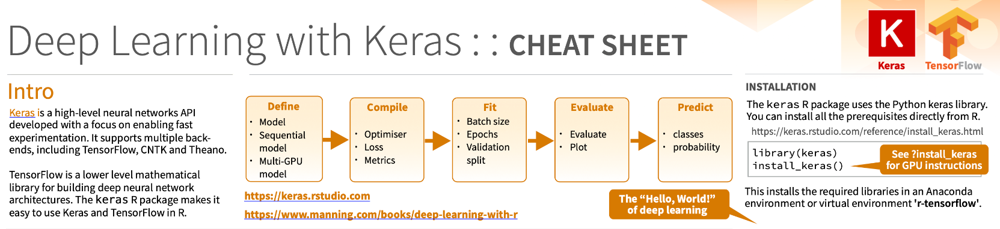

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'keras_deep_learning.png'))

### Method 1: Adding a layer one-by-one

In [ ]:
## METHOD 1: adding a layer one-by-one

# set the random seed for reproducible results
# the random weights of the hidden layers and the output layer will be the same
tf.keras.utils.set_random_seed(42)

- Create the sequential model

In [ ]:
model = tf.keras.Sequential()

- Build the input layer

  - You need to specify the input shape of a single observation, which isn't including the size of the sample of observations (i.e. the batch).

  - This shape is used to create the weight matrix mapping the input data to the units in the first hidden layer.

In [ ]:
# build the first layer (which is an Input layer) and add it to the model
# specify the input shape, which doesn't include the batch size, only the shape of a single observation
# the shape is used to create the connection weight matrix of the first hidden layer

model.add(tf.keras.layers.Input(shape=(X_train.shape[1],)))

- Add a normalization layer that takes every feature and computes the **batch** sample's mean and standard deviation, and then takes the Z-score of each feature in the batch.

- This is a preprocessing step without trainable weights.

- We do this to help convergence of gradient descent.

In [ ]:
# next add a preprocessing layer that normalizes continuous features to help convergence of gradient descent
'''The axis or axes that should have a separate mean and variance for each observation in the shape.
For example, if shape is (None, 5) and axis=1, the layer will track 5 separate mean and variance values for the last axis.
When -1, the last axis of the input is assumed to be a feature dimension and is normalized per observation.'''

model.add(tf.keras.layers.Normalization()) # defaults to: axis=-1

- Now we can finally start to process our features and attempt to extract signals.

- We will use a dense hidden layer with 10 units and a ReLU activation function.

- See the <a href="https://keras.io/api/layers/core_layers/dense/">Dense layer documentation</a>.

- Note: specifying **activation="relu"** is equivalent to specifying **activation=tf.keras.activations.relu**.

  - For more, see <a href="https://keras.io/api/layers/activations">Keras activation function documentation</a>.

In [ ]:
# next add a feature processing layer; i.e. a dense hidden layer

# units: Positive integer, dimensionality of the output space.
# activation: Activation function to use. If you don't specify anything, no activation is applied (ie. "linear" activation: a(x) = x).

model.add(tf.keras.layers.Dense(units=10, activation="relu"))

- Each Dense layer manages its own weight matrix (TF Keras calls it a **kernel**).

- It also manages its own bias vector (where there is one per unit)

- At this step, the model computes activation function for each unit in the hidden layer: $$h^{[1]}_{\mathbf{W_1}, b_1}(\mathbf{X}) = \sigma(\mathbf{X}\mathbf{W}_1 + b_1).$$

- We will then add another feature extraction hidden layer to the sequential model which will compute the subsequent hidden layer as follows: $$h^{[2]}_{\mathbf{W}_2, b_2}(\mathbf{h^{[1]}}) = \sigma(\mathbf{h^{[1]}}\mathbf{W}_2 + b_2).$$

In [ ]:
model.add(tf.keras.layers.Dense(units=10, activation="relu"))

- We sill add one more hidden layer to process the signals through the model.

- By adding another feature extraction hidden layer to the sequential model, the dense neural network will compute the subsequent hidden layer as follows: $$h^{[3]}_{\mathbf{W}_3, b_3}(\mathbf{h^{[2]}}) = \sigma(\mathbf{h^{[2]}}\mathbf{W}_3 + b_3).$$

In [ ]:
model.add(tf.keras.layers.Dense(units=10, activation="relu"))

- Lastly, we will add a final dense layer for the output layer with a single unit and the linear activation function as we are predicting a single return for the SPX index.

- By adding the output layer to the sequential model, the dense neural network will compute the output as follows: $$\widehat{y}^{[4]}_{\mathbf{W}_4, b_4}(\mathbf{h^{[3]}}) = \mathbf{h^{[3]}}\mathbf{W}_4 + b_4,$$ since the final activation function is just a linear regression.

In [ ]:
model.add(tf.keras.layers.Dense(units=1)) # defaults to: activation="linear"

- You can look through the layers since they are stored in a list.

In [ ]:
model.layers

[<Normalization name=normalization, built=True>,
 <Dense name=dense, built=True>,
 <Dense name=dense_1, built=True>,
 <Dense name=dense_2, built=True>,
 <Dense name=dense_3, built=True>]

- You can investigate a single hidden layer's trainable weights.

- Notice the dense layer initialized the connection weights randomly, and the biases are initialized to zero.

- If you want to use a different initialization method, you can set the keyword **kernel_initializer** or **bias_initializer** when creating the layer.

- For different types of random initializations, see <a href="https://keras.io/api/layers/initializers/">Keras Layers Initializers</a>.

In [ ]:
# analyze the weights in the first hidden layer
first_hidden_layer = model.layers[1]

In [ ]:
first_hidden_layer.get_weights()

[array([[ 0.35095218,  0.15934274, -0.13843462,  0.4408979 , -0.413414  ,
          0.14925459,  0.46099386, -0.32537833,  0.02330866,  0.12811771],
        [-0.40522566, -0.05255872,  0.45661792, -0.02905968,  0.00288686,
          0.26029846, -0.47144845, -0.30140394,  0.01395383, -0.42481527],
        [-0.45301354,  0.3409362 ,  0.40703455, -0.23266152,  0.35226783,
         -0.3649989 , -0.03695261,  0.06145462,  0.06534442, -0.29377997],
        [-0.2844419 ,  0.47928074, -0.38222528, -0.05524746, -0.23016527,
         -0.3713218 ,  0.2284325 , -0.31124133,  0.17763284,  0.1473799 ],
        [-0.44812846,  0.06235012, -0.16252688, -0.11086705,  0.44533822,
         -0.08779553,  0.03083435, -0.23973674, -0.3695622 ,  0.21146932],
        [ 0.11406168,  0.00779483, -0.4626969 , -0.3726371 ,  0.2855048 ,
          0.3587809 , -0.06677324, -0.18247807, -0.45750743, -0.45198697],
        [ 0.25382957,  0.3219776 , -0.12151298,  0.21512154, -0.1801931 ,
          0.27328393, -0.1809858

In [ ]:
kernel, bias = first_hidden_layer.get_weights()

In [ ]:
kernel.shape

(15, 10)

In [ ]:
pd.DataFrame(kernel)

,0,1,2,3,4,5,6,7,8,9
0,0.350952,0.159343,-0.138435,0.440898,-0.413414,0.149255,0.460994,-0.325378,0.023309,0.128118
1,-0.405226,-0.052559,0.456618,-0.029060,0.002887,0.260298,-0.471448,-0.301404,0.013954,-0.424815
2,-0.453014,0.340936,0.407035,-0.232662,0.352268,-0.364999,-0.036953,0.061455,0.065344,-0.293780
3,-0.284442,0.479281,-0.382225,-0.055247,-0.230165,-0.371322,0.228433,-0.311241,0.177633,0.147380
4,-0.448128,0.062350,-0.162527,-0.110867,0.445338,-0.087796,0.030834,-0.239737,-0.369562,0.211469
5,0.114062,0.007795,-0.462697,-0.372637,0.285505,0.358781,-0.066773,-0.182478,-0.457507,-0.451987
6,0.253830,0.321978,-0.121513,0.215122,-0.180193,0.273284,-0.180986,-0.074993,0.347613,0.320774
7,0.182752,0.388874,0.345670,-0.268864,0.132734,-0.401860,0.444945,0.214485,0.059358,-0.305924
8,-0.295758,0.463096,-0.440237,-0.180799,-0.257464,-0.336194,0.356106,0.331060,0.123065,0.035402
9,0.044339,0.210005,-0.018029,-0.361574,0.391612,-0.128149,0.296940,0.349996,-0.116406,-0.430235


In [ ]:
bias.shape

(10,)

In [ ]:
pd.DataFrame(bias)

,0
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0
5,0.0
6,0.0
7,0.0
8,0.0
9,0.0


- We can also look at a summary and a graphical diagram of the sequential model that gives the input and output shapes of each hidden layer, as well as the number of parameters per layer and across the entire model.

- The model's **summary()** method displays all the model's layers, including each layer's name, its output shape, and its number of parameters

In [ ]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ normalization (Normalization)        │ (None, 15)                  │              31 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 10)                  │             160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 10)                  │             110 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 10)                  │             110 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 1)                   │              11 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 422 (1.65 KB)

 Trainable params: 391 (1.53 KB)

 Non-trainable params: 31 (128.00 B)

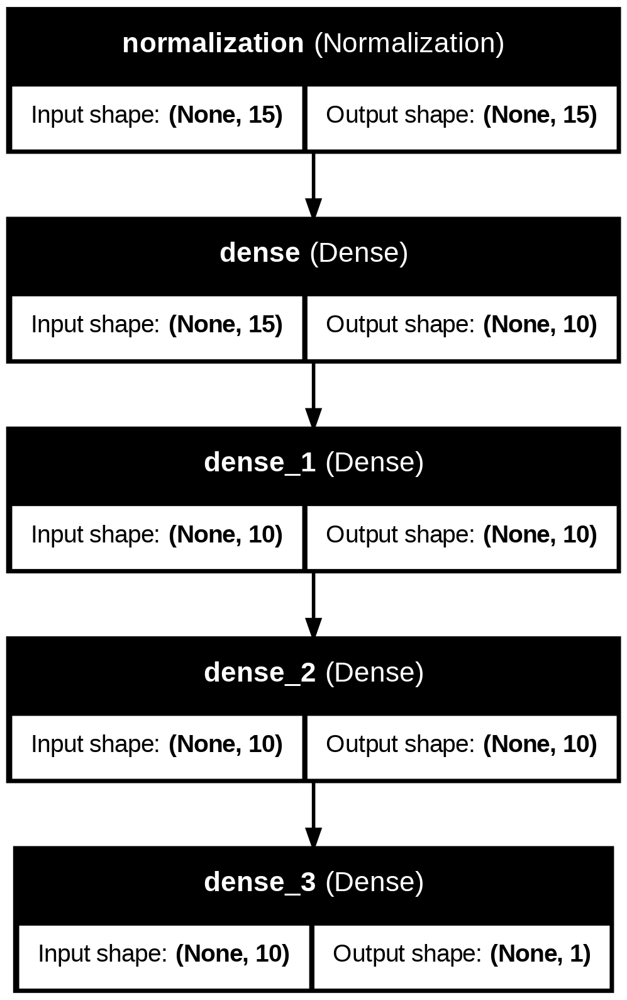

In [ ]:
# https://keras.io/api/utils/model_plotting_utils/
tf.keras.utils.plot_model(model, show_shapes=True, show_layer_names=True) # to_file='model_plot.png'

- **Note: dense layers have a LOT of parameters! This can be a problem.**

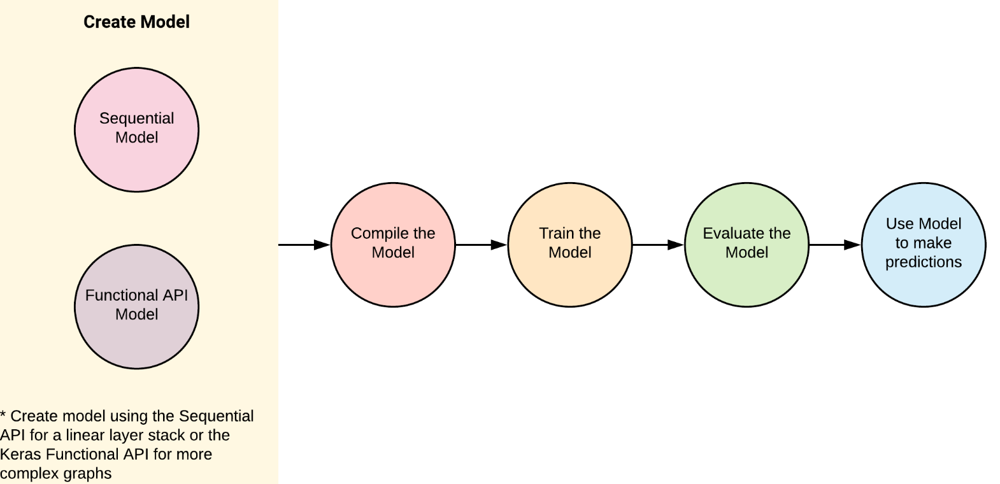

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'keras_workflow.png'))

### Method 2: Passing a list of layers

In [ ]:
## METHOD 2: passing a list of layers to the Sequential model

# set the random seed for reproducible results
# the random weights of the hidden layers and the output layer will be the same
tf.keras.utils.set_random_seed(42)

- Create the sequential model

In [ ]:
model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(X_train.shape[1],)),
    tf.keras.layers.Normalization(),
    tf.keras.layers.Dense(units=10, activation="relu"),
    tf.keras.layers.Dense(units=10, activation="relu"),
    tf.keras.layers.Dense(units=10, activation="relu"),
    tf.keras.layers.Dense(units=1)
])

# it is possible to drop the input layer and instead specify the input_shape in the first layer
# you can also rename the layers and the model by passing the keyword: "name='Layer_Name_for_Interpretability'"
# model = tf.keras.Sequential([
#     tf.keras.layers.Normalization(input_shape=[X_train.shape[1]]),
#     tf.keras.layers.Dense(units=10, activation="relu"),
#     tf.keras.layers.Dense(units=10, activation="relu"),
#     tf.keras.layers.Dense(units=10, activation="relu"),
#     tf.keras.layers.Dense(units=1)
# ])

- Each Dense layer manages its own weight matrix (TF Keras calls it a **kernel**).

- It also manages its own bias vector (where there is one per unit)

- At this step, the model computes activation function for each unit in the hidden layer: $$h^{[1]}_{\mathbf{W_1}, b_1}(\mathbf{X}) = \sigma(\mathbf{X}\mathbf{W}_1 + b_1).$$

- We will then add another feature extraction hidden layer to the sequential model which will compute the subsequent hidden layer as follows: $$h^{[2]}_{\mathbf{W}_2, b_2}(\mathbf{h^{[1]}}) = \sigma(\mathbf{h^{[1]}}\mathbf{W}_2 + b_2).$$

- We sill add one more hidden layer to process the signals through the model.

- By adding another feature extraction hidden layer to the sequential model, the dense neural network will compute the subsequent hidden layer as follows: $$h^{[3]}_{\mathbf{W}_3, b_3}(\mathbf{h^{[2]}}) = \sigma(\mathbf{h^{[2]}}\mathbf{W}_3 + b_3).$$

- Lastly, we will add a final dense layer for the output layer with a single unit and the linear activation function as we are predicting a single return for the SPX index.

- By adding the output layer to the sequential model, the dense neural network will compute the output as follows: $$\widehat{y}^{[4]}_{\mathbf{W}_4, b_4}(\mathbf{h^{[3]}}) = \mathbf{h^{[3]}}\mathbf{W}_4 + b_4,$$ since the final activation function is just a linear regression.

- You can look through the layers since they are stored in a list.

In [ ]:
model.layers

[<Normalization name=normalization_1, built=True>,
 <Dense name=dense_4, built=True>,
 <Dense name=dense_5, built=True>,
 <Dense name=dense_6, built=True>,
 <Dense name=dense_7, built=True>]

- You can investigate a single hidden layer's trainable weights, just as before.

In [ ]:
# analyze the weights in the first hidden layer
first_hidden_layer = model.layers[1]

In [ ]:
first_hidden_layer.get_weights()

[array([[ 0.35095218,  0.15934274, -0.13843462,  0.4408979 , -0.413414  ,
          0.14925459,  0.46099386, -0.32537833,  0.02330866,  0.12811771],
        [-0.40522566, -0.05255872,  0.45661792, -0.02905968,  0.00288686,
          0.26029846, -0.47144845, -0.30140394,  0.01395383, -0.42481527],
        [-0.45301354,  0.3409362 ,  0.40703455, -0.23266152,  0.35226783,
         -0.3649989 , -0.03695261,  0.06145462,  0.06534442, -0.29377997],
        [-0.2844419 ,  0.47928074, -0.38222528, -0.05524746, -0.23016527,
         -0.3713218 ,  0.2284325 , -0.31124133,  0.17763284,  0.1473799 ],
        [-0.44812846,  0.06235012, -0.16252688, -0.11086705,  0.44533822,
         -0.08779553,  0.03083435, -0.23973674, -0.3695622 ,  0.21146932],
        [ 0.11406168,  0.00779483, -0.4626969 , -0.3726371 ,  0.2855048 ,
          0.3587809 , -0.06677324, -0.18247807, -0.45750743, -0.45198697],
        [ 0.25382957,  0.3219776 , -0.12151298,  0.21512154, -0.1801931 ,
          0.27328393, -0.1809858

In [ ]:
kernel, bias = first_hidden_layer.get_weights()

In [ ]:
kernel.shape

(15, 10)

In [ ]:
pd.DataFrame(kernel)

,0,1,2,3,4,5,6,7,8,9
0,0.350952,0.159343,-0.138435,0.440898,-0.413414,0.149255,0.460994,-0.325378,0.023309,0.128118
1,-0.405226,-0.052559,0.456618,-0.029060,0.002887,0.260298,-0.471448,-0.301404,0.013954,-0.424815
2,-0.453014,0.340936,0.407035,-0.232662,0.352268,-0.364999,-0.036953,0.061455,0.065344,-0.293780
3,-0.284442,0.479281,-0.382225,-0.055247,-0.230165,-0.371322,0.228433,-0.311241,0.177633,0.147380
4,-0.448128,0.062350,-0.162527,-0.110867,0.445338,-0.087796,0.030834,-0.239737,-0.369562,0.211469
5,0.114062,0.007795,-0.462697,-0.372637,0.285505,0.358781,-0.066773,-0.182478,-0.457507,-0.451987
6,0.253830,0.321978,-0.121513,0.215122,-0.180193,0.273284,-0.180986,-0.074993,0.347613,0.320774
7,0.182752,0.388874,0.345670,-0.268864,0.132734,-0.401860,0.444945,0.214485,0.059358,-0.305924
8,-0.295758,0.463096,-0.440237,-0.180799,-0.257464,-0.336194,0.356106,0.331060,0.123065,0.035402
9,0.044339,0.210005,-0.018029,-0.361574,0.391612,-0.128149,0.296940,0.349996,-0.116406,-0.430235


In [ ]:
bias.shape

(10,)

In [ ]:
pd.DataFrame(bias)

,0
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0
5,0.0
6,0.0
7,0.0
8,0.0
9,0.0


In [ ]:
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ normalization_1 (Normalization)      │ (None, 15)                  │              31 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 10)                  │             160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 10)                  │             110 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 10)                  │             110 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 1)                   │              11 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 422 (1.65 KB)

 Trainable params: 391 (1.53 KB)

 Non-trainable params: 31 (128.00 B)

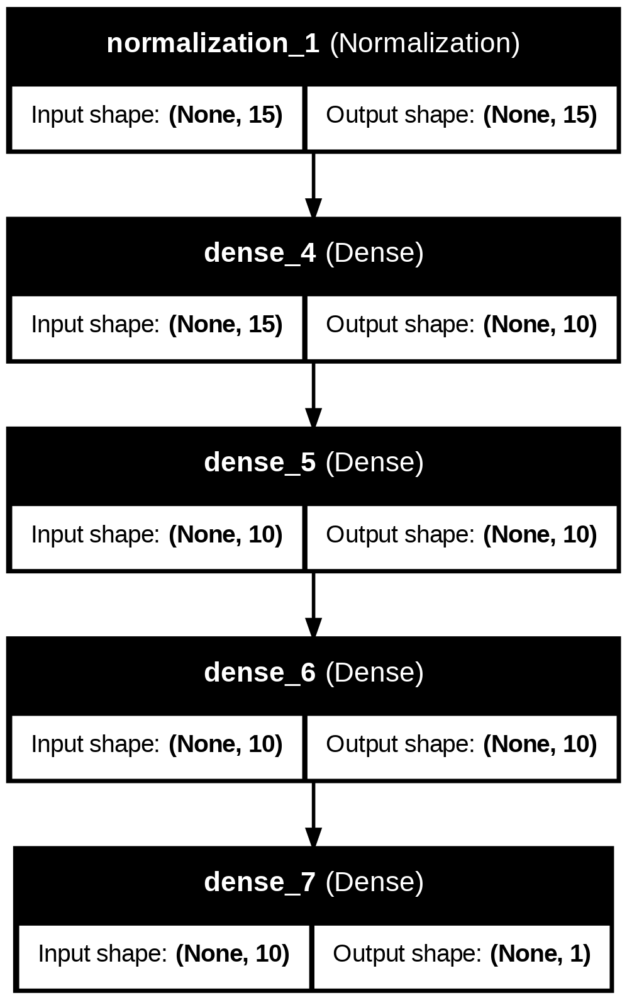

In [ ]:
# https://keras.io/api/utils/model_plotting_utils/
tf.keras.utils.plot_model(model, show_shapes=True, show_layer_names=True) # to_file='model_plot.png'

### A Common Debugging Workflow: add() + summary()

- When building a new Sequential architecture, it's useful to incrementally stack layers with **add()** and frequently print model summaries.

- This enables you to monitor how a stack of layers is extracting signals from the features.

In [ ]:
# set the random seed for reproducible results
# the random weights of the hidden layers and the output layer will be the same
tf.keras.utils.set_random_seed(42)

In [ ]:
model = tf.keras.Sequential()

model.add(tf.keras.layers.Input(shape=(X_train.shape[1],)))
print(model.summary())

model.add(tf.keras.layers.Normalization())
print(model.summary())

model.add(tf.keras.layers.Dense(units=10, activation="relu"))
print(model.summary())

model.add(tf.keras.layers.Dense(units=10, activation="relu"))
print(model.summary())

model.add(tf.keras.layers.Dense(units=10, activation="relu"))
print(model.summary())

model.add(tf.keras.layers.Dense(units=1))
print(model.summary())

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

None


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ normalization_2 (Normalization)      │ (None, 15)                  │              31 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 31 (128.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 31 (128.00 B)

None


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ normalization_2 (Normalization)      │ (None, 15)                  │              31 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 10)                  │             160 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 191 (768.00 B)

 Trainable params: 160 (640.00 B)

 Non-trainable params: 31 (128.00 B)

None


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ normalization_2 (Normalization)      │ (None, 15)                  │              31 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 10)                  │             160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 10)                  │             110 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 301 (1.18 KB)

 Trainable params: 270 (1.05 KB)

 Non-trainable params: 31 (128.00 B)

None


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ normalization_2 (Normalization)      │ (None, 15)                  │              31 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 10)                  │             160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 10)                  │             110 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 10)                  │             110 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 411 (1.61 KB)

 Trainable params: 380 (1.48 KB)

 Non-trainable params: 31 (128.00 B)

None


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ normalization_2 (Normalization)      │ (None, 15)                  │              31 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 10)                  │             160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 10)                  │             110 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 10)                  │             110 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 1)                   │              11 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 422 (1.65 KB)

 Trainable params: 391 (1.53 KB)

 Non-trainable params: 31 (128.00 B)

None


<br>
<br>
$\rule{800pt}{10pt}$


### What To Do Once We Have Specified A Model Architecture?

- Now we can **train** our model, **evaluate** our model, and **run inference** (i.e. predict) with our model.

- We might also like to save our model to disk, so it can be reused later without having to re-train the model.

- We might also like to restore the model once it is saved.

<br>
<br>
$\rule{800pt}{10pt}$
<br>
<br>

- The **compile()** method is used to specify

  - the **loss function**,
  
  - the **optimizer** to use,

  - you can also specify a list of extra **metrics** to compute during training and evaluation,

  - and <a href="https://keras.io/api/models/model_training_apis/#compile-method">more</a>.

In [ ]:
model.compile(loss="mse",
              optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
              metrics=[tf.keras.metrics.R2Score()])

- To train the model, we will use a built-in training loop, which we can access by calling the **.fit()** method.

- We pass it the **X_train** and the **Y_train** data, as well as the number of epochs to train (default is 1, which is not enough to converge to a good solution)

- We also can pass a validation set (though its optional).

  - Keras will measure the loss and any extra metrics on this set at the end of each epoch, which is useful to see how the model performs.

  - If your performance is much better than on the training set than on the validation set, then your model is probably overfitting the training set, or there is a bug, or some sort of data leakage (a lookahead bias).

- The **fit()** method is used to specify  
  
  - the **training set**,
  
  - the **validation set**,
  
  - the **number of epochs**,

  - the **batch size**,

  - and <a href="https://keras.io/api/models/model_training_apis/#fit-method">more</a>.

In [ ]:
'''
validation_split: Float between 0 and 1. Fraction of the training data to be used as validation data.
                  The model will set apart this fraction of the training data, will not train on it, and will evaluate the loss and any model metrics on this data at the end of each epoch.
                  The validation data is selected from the last samples in the x and y data provided, before shuffling. This argument is not supported when x is a dataset, generator or keras.utils.PyDataset instance.
                  If both validation_data and validation_split are provided, validation_data will override validation_split.

validation_data: Data on which to evaluate the loss and any model metrics at the end of each epoch.
                 The model will not be trained on this data.
                 Thus, note the fact that the validation loss of data provided using validation_split or validation_data is not affected by regularization layers like noise and dropout.
                 validation_data will override validation_split.
                 It could be:
                      A tuple (x_val, y_val) of NumPy arrays or tensors.
                      A tuple (x_val, y_val, val_sample_weights) of NumPy arrays.
                      A tf.data.Dataset.
                      A Python generator or keras.utils.PyDataset returning (inputs, targets) or (inputs, targets, sample_weights).

shuffle: Boolean, whether to shuffle the training data before each epoch.
         This argument is ignored when x is a generator or a tf.data.Dataset.'''

history = model.fit(X_train, Y_train, epochs=150, batch_size=32, validation_split=0.1, verbose=True, shuffle=False)

# history = model.fit(X_sub_train, Y_sub_train, epochs=150, batch_size=32, validation_data=(X_validation, Y_validation))

Epoch 1/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - loss: 2.1245 - r2_score: -482.1206 - val_loss: 0.3940 - val_r2_score: -204.3035
Epoch 2/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0916 - r2_score: -19.6075 - val_loss: 0.0415 - val_r2_score: -20.6076
Epoch 3/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0131 - r2_score: -1.9637 - val_loss: 0.0158 - val_r2_score: -7.2297
Epoch 4/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0081 - r2_score: -0.7374 - val_loss: 0.0084 - val_r2_score: -3.3669
Epoch 5/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0070 - r2_score: -0.4724 - val_loss: 0.0055 - val_r2_score: -1.8513
Epoch 6/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0067 - r2_score: -0.3751 - val_loss: 0.0040 - val_r2_score: -1.1079
Epoch 7/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0065 - r2_score: -0.3234 - val_loss: 0.0032 - val_r2_score: -0.6832
Epoch 8/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0063 - r2_score: -0.2890 - va

- The **fit()** method returns a **History object** containing

  -  the training parameters (history.params),
  
  - the list of epochs it went through (history.epoch),
  
  - and most importantly a dictionary (history.history) containing the loss and extra metrics it measured at the end of each epoch on the training set and on the validation set (if any).
  
- If you use this dictionary to create a Pandas DataFrame and call its plot() method, you get the learning curves, which we have done.

In [ ]:
history.params

{'verbose': True, 'epochs': 150, 'steps': 30}

In [ ]:
history = pd.DataFrame(history.history)

history

,loss,r2_score,val_loss,val_r2_score
0,1.524119,-475.236267,0.394043,-204.303467
1,0.068123,-20.286217,0.041472,-20.607588
2,0.013099,-3.092876,0.015795,-7.229683
3,0.007165,-1.238848,0.008381,-3.366858
4,0.005652,-0.766019,0.005473,-1.851305
...,...,...,...,...
145,0.003249,-0.015141,0.001993,-0.038218
146,0.003247,-0.014693,0.001991,-0.037575
147,0.003246,-0.014244,0.001990,-0.036933
148,0.003244,-0.013793,0.001989,-0.036295


<Axes: >

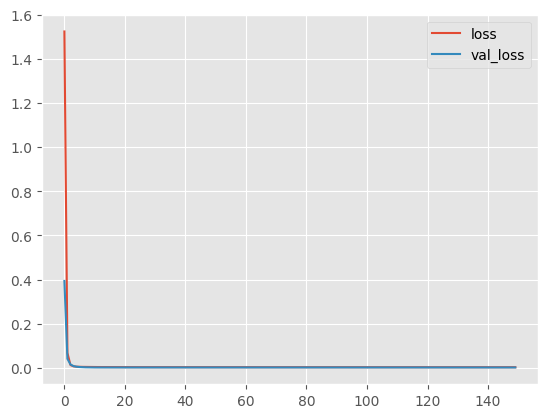

In [ ]:
history[['loss', 'val_loss']].plot()

<Axes: >

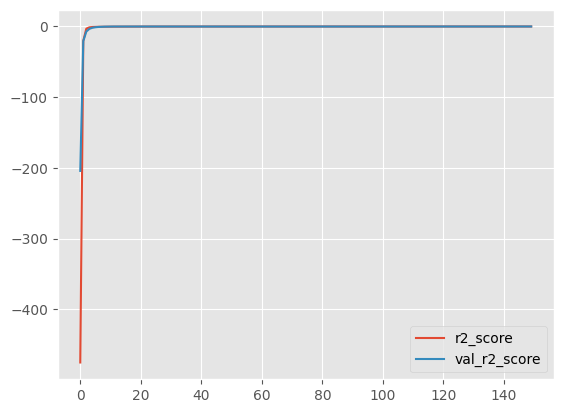

In [ ]:
history[['r2_score', 'val_r2_score']].plot()

<Axes: >

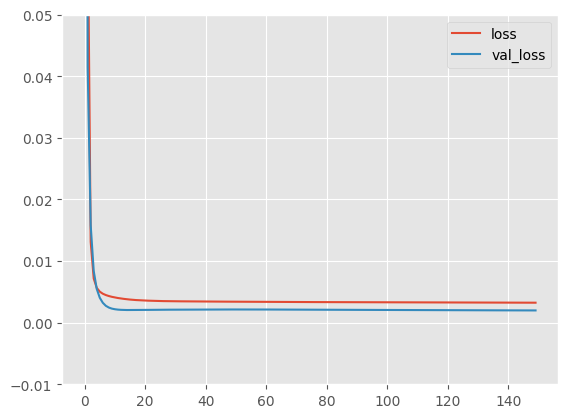

In [ ]:
history[['loss', 'val_loss']].plot(ylim=[-0.01, 0.05])

<Axes: >

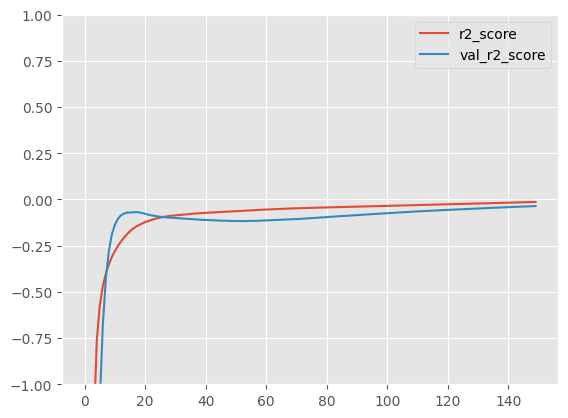

In [ ]:
history[['r2_score', 'val_r2_score']].plot(ylim=[-1,1])

- At each epoch of training, Keras displays the number of mini-batches processed on the left-side of the progress bar.

  - The batch size defaults to samples of size 32.

  - After the progress bar, you can see the average training time **per sample** (not per batch of samples), and the loss and other metrics on both the training set and validation set.

- Instead of passing a validation set using the validation_data argument, you could set validation_split to the ratio of the training set that you want Keras to use for validation. For example, validation_split=0.1 tells Keras to use the last 10% of the data (before shuffling) for validation.

  - We must be very careful not to introduce a lookahead bias with our validation set choices.

- **Note:** The validation error is computed at the end of each epoch, while the training error is computed using a running mean during each epoch.

In [ ]:
'''
validation_split: Float between 0 and 1. Fraction of the training data to be used as validation data.
                  The model will set apart this fraction of the training data, will not train on it, and will evaluate the loss and any model metrics on this data at the end of each epoch.
                  The validation data is selected from the last samples in the x and y data provided, before shuffling. This argument is not supported when x is a dataset, generator or keras.utils.PyDataset instance.
                  If both validation_data and validation_split are provided, validation_data will override validation_split.

validation_data: Data on which to evaluate the loss and any model metrics at the end of each epoch.
                 The model will not be trained on this data.
                 Thus, note the fact that the validation loss of data provided using validation_split or validation_data is not affected by regularization layers like noise and dropout.
                 validation_data will override validation_split.
                 It could be:
                      A tuple (x_val, y_val) of NumPy arrays or tensors.
                      A tuple (x_val, y_val, val_sample_weights) of NumPy arrays.
                      A tf.data.Dataset.
                      A Python generator or keras.utils.PyDataset returning (inputs, targets) or (inputs, targets, sample_weights).

shuffle: Boolean, whether to shuffle the training data before each epoch.
         This argument is ignored when x is a generator or a tf.data.Dataset.'''

history = model.fit(X_train, Y_train, epochs=150, batch_size=32, validation_split=0.1, verbose=True, shuffle=False)

# history = model.fit(X_sub_train, Y_sub_train, epochs=150, batch_size=32, validation_data=(X_validation, Y_validation))

Epoch 1/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0052 - r2_score: -0.0136 - val_loss: 0.0020 - val_r2_score: -0.0350
Epoch 2/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0052 - r2_score: -0.0133 - val_loss: 0.0020 - val_r2_score: -0.0342
Epoch 3/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0052 - r2_score: -0.0129 - val_loss: 0.0020 - val_r2_score: -0.0336
Epoch 4/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0052 - r2_score: -0.0125 - val_loss: 0.0020 - val_r2_score: -0.0330
Epoch 5/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0052 - r2_score: -0.0121 - val_loss: 0.0020 - val_r2_score: -0.0324
Epoch 6/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0052 - r2_score: -0.0117 - val_loss: 0.0020 - val_r2_score: -0.0317
Epoch 7/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0052 - r2_score: -0.0113 - val_loss: 0.0020 - val_r2_score: -0.0311
Epoch 8/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0051 - r2_score: -0.0109 - val_loss:

In [ ]:
history = pd.DataFrame(history.history)

history

,loss,r2_score,val_loss,val_r2_score
0,0.003242,-0.012888,0.001987,-0.035024
1,0.003240,-0.012467,0.001985,-0.034173
2,0.003239,-0.012013,0.001984,-0.033630
3,0.003237,-0.011551,0.001983,-0.032975
4,0.003236,-0.011090,0.001981,-0.032365
...,...,...,...,...
145,0.001556,0.513694,0.003038,-0.582597
146,0.001519,0.525307,0.002981,-0.552977
147,0.001462,0.543018,0.002906,-0.513819
148,0.001413,0.558444,0.002903,-0.512354


<Axes: >

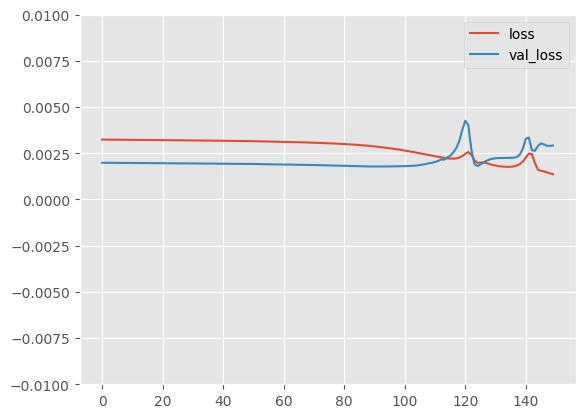

In [ ]:
history[['loss', 'val_loss']].plot(ylim=[-0.01, 0.01])

<Axes: >

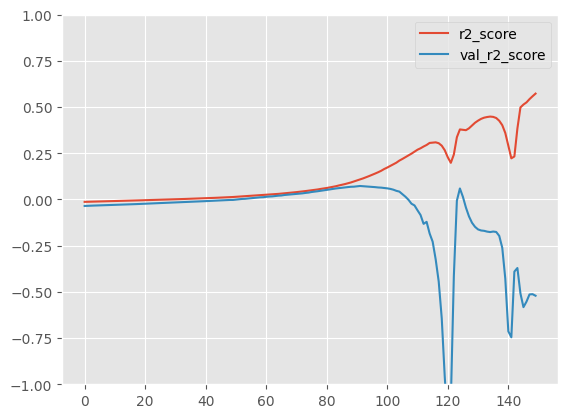

In [ ]:
history[['r2_score', 'val_r2_score']].plot(ylim=[-1,1])

- If you observe the validation loss is still going down, you should probably continue training, because this is a sign that the model hasn't quite converged yet.

  - This is as simple as calling the fit() method again, since Keras just continues training where it left off.


- If you are not satisfied with the performance of your model, you should go
back and tune the hyperparameters.

  - The first one to check is the learning rate.

  - If that doesn't help, try another optimizer (and always retune the learning rate after changing any hyperparameter).
  
  - If the performance is still not great, then try tuning model hyperparameters such as the number of layers, the number of units per layer, and the types of activation functions to use for each hidden layer.
  
  - You can also try tuning other hyperparameters, such as the batch size (it can be set in the fit() method using the batch_size argument, which defaults to 32).
  
  - **We will get back to hyperparameter tuning at the end of this module.**
  
  - **Once you are satisfied with your model's validation score, you should evaluate it on the test set to <u>estimate the generalization error</u> before you deploy the model to production.**
  
  - You can easily do this using the **predict()** or **evaluate()** method (it also supports several other arguments, such as batch_size and sample_weight; see the documentation for more details).

- We can use the **.predict()** method for doing model inference, i.e. generating predictions from the estimated model.

- Note, model.predict(data) $\iff$ model(data).


- For more, see the <a href="https://keras.io/api/models/model_training_apis/#predict-method">Keras API documentation for the predict method</a>

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


<Axes: xlabel='yyyymm'>

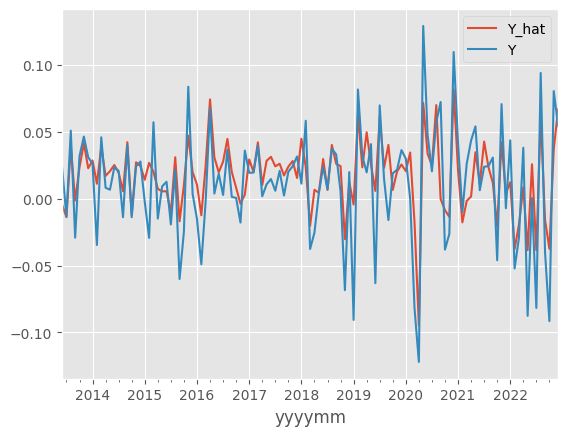

In [ ]:
Y_hat_Y_test_set = pd.DataFrame(model.predict(X_test), index=X_test.index, columns=['Y_hat'])  # note to predict, you can also call model(X_test); i.e. model(data) <=> model.predict(data)

Y_hat_Y_test_set['Y'] = Y_test
Y_hat_Y_test_set['error'] = Y_hat_Y_test_set['Y_hat'] - Y_hat_Y_test_set['Y']

Y_hat_Y_test_set[['Y_hat', 'Y']].plot()

<Axes: xlabel='yyyymm'>

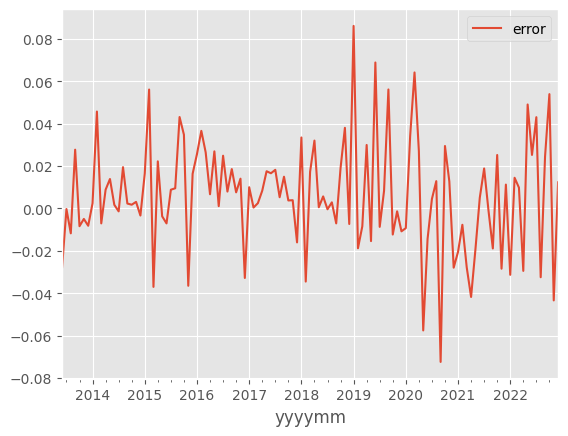

In [ ]:
Y_hat_Y_test_set[['error']].plot()

- Rather than using the predict method, and then evaluating the error by passing $Y$ and $\widehat{Y}$ into some error function, we can just use the **.evaluate()** method, which will generate the predictions and pass them to the loss and metric functions specified in the compile step.

- For more, see the <a href="https://keras.io/api/models/model_training_apis/#evaluate-method">Keras API documentation for the evaluate method</a>.

In [ ]:
model.evaluate(X_test, Y_test)

4/4 [==============================] - 0s 3ms/step - loss: 7.0776e-04 - r2_score: 0.6102


[0.0007077627815306187, 0.610183835029602]

- **Remember to resist the temptation to tweak the hyperparameters on the test set, or else your estimate of the generalization error will be too optimistic.**

Streaming output truncated to the last 5000 lines.
Epoch 1251/3750
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0050 - r2_score: -0.0317 - val_loss: 0.0020 - val_r2_score: -0.0446
Epoch 1252/3750
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0050 - r2_score: -0.0316 - val_loss: 0.0020 - val_r2_score: -0.0444
Epoch 1253/3750
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0050 - r2_score: -0.0316 - val_loss: 0.0020 - val_r2_score: -0.0443
Epoch 1254/3750
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0050 - r2_score: -0.0315 - val_loss: 0.0020 - val_r2_score: -0.0441
Epoch 1255/3750
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0050 - r2_score: -0.0315 - val_loss: 0.0020 - val_r2_score: -0.0439
Epoch 1256/3750
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0050 - r2_score: -0.0314 - val_loss: 0.0020 - val_r2_score: -0.0438
Epoch 1257/3750
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0050 - r2_score: -0.0314 - val_loss: 0.0020 - val_r2_score: -0.0436
Epoch 1258/3750
8/8 ━━━━━━━━━━━

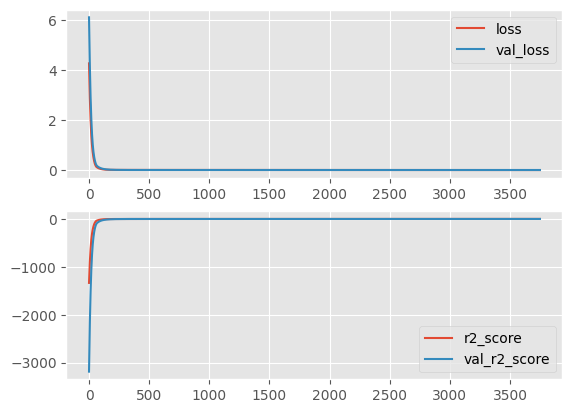

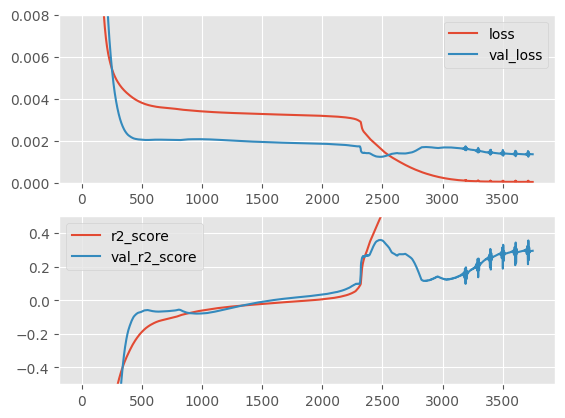

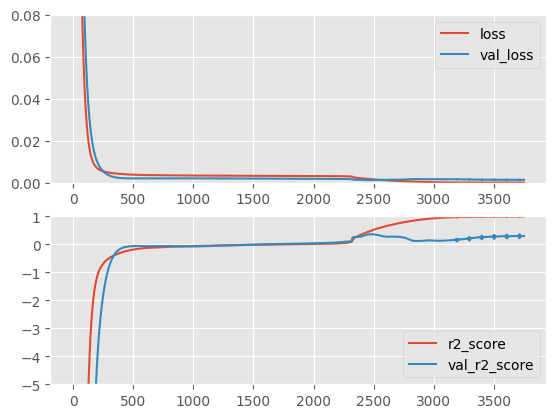

In [ ]:
## Try smaller learning rates and bigger batch sizes

learning_rate = 1e-4
batch_size = 128
epochs_multiplier = 25

tf.keras.utils.set_random_seed(42)

model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(X_train.shape[1],)),
    tf.keras.layers.Normalization(),
    tf.keras.layers.Dense(units=10, activation="relu"),
    tf.keras.layers.Dense(units=10, activation="relu"),
    tf.keras.layers.Dense(units=10, activation="relu"),
    tf.keras.layers.Dense(units=1)
])

model.compile(loss="mse",
              optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
              metrics=[tf.keras.metrics.R2Score()])

############################################################################
# for fit in range(num_training):
history = model.fit(X_train, Y_train,
                    epochs=150*epochs_multiplier,
                    batch_size=batch_size,
                    validation_split=0.1,
                    verbose=True,
                    shuffle=False)

history = pd.DataFrame(history.history)

fig, axes = plt.subplots(nrows=2, ncols=1)
axes = axes.flatten()
history[['loss', 'val_loss']].plot(ax=axes[0])
history[['r2_score', 'val_r2_score']].plot(ax=axes[1])

plt.show()

fig, axes = plt.subplots(nrows=2, ncols=1)
axes = axes.flatten()
history[['loss', 'val_loss']].plot(ax=axes[0], ylim=[0,0.008])
history[['r2_score', 'val_r2_score']].plot(ax=axes[1], ylim=[-0.5, 0.5])

plt.show()

fig, axes = plt.subplots(nrows=2, ncols=1)
axes = axes.flatten()
history[['loss', 'val_loss']].plot(ax=axes[0], ylim=[0,0.08])
history[['r2_score', 'val_r2_score']].plot(ax=axes[1], ylim=[-5, 1])

plt.show()
############################################################################

### Try Different Dense Architectures

- We should experiment with different

  - number of hidden layers,

  - number of units per hidden layer,

  - activation functions,

  - optimizers,

  - loss functions,

  - etc.

In [ ]:
## Model 1: Less complex model

# set the random seed for reproducible results
# the random weights of the hidden layers and the output layer will be the same
tf.keras.utils.set_random_seed(42)

model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(X_train.shape[1],)),
    tf.keras.layers.Normalization(),
    tf.keras.layers.Dense(units=15, activation="relu"),
    tf.keras.layers.Dense(units=15, activation="relu"),
    tf.keras.layers.Dense(units=1)
])

model.compile(loss="mse",
              optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
              metrics=[tf.keras.metrics.R2Score()])

In [ ]:
history = model.fit(X_sub_train, Y_sub_train, epochs=150, batch_size=32, validation_data=(X_validation, Y_validation))

history = pd.DataFrame(history.history)

Epoch 1/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0225 - r2_score: -6.8015 - val_loss: 0.0097 - val_r2_score: -4.0467
Epoch 2/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0062 - r2_score: -1.0401 - val_loss: 0.0052 - val_r2_score: -1.7256
Epoch 3/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0044 - r2_score: -0.4420 - val_loss: 0.0031 - val_r2_score: -0.6136
Epoch 4/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0036 - r2_score: -0.1686 - val_loss: 0.0023 - val_r2_score: -0.1856
Epoch 5/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0032 - r2_score: -0.0369 - val_loss: 0.0019 - val_r2_score: -0.0152
Epoch 6/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0030 - r2_score: 0.0213 - val_loss: 0.0019 - val_r2_score: 0.0047
Epoch 7/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0029 - r2_score: 0.0449 - val_loss: 0.0019 - val_r2_score: 0.0164
Epoch 8/150
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0029 - r2_score: 0.0620 - val_loss: 0.0

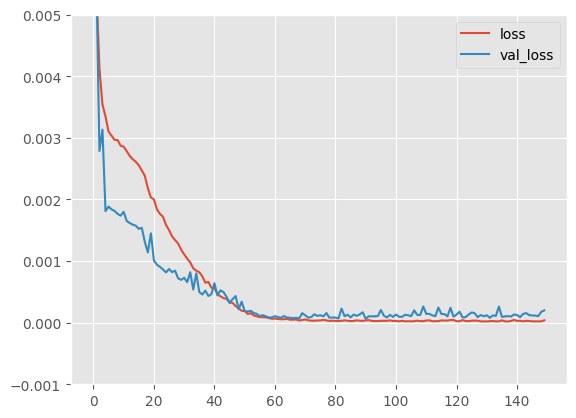

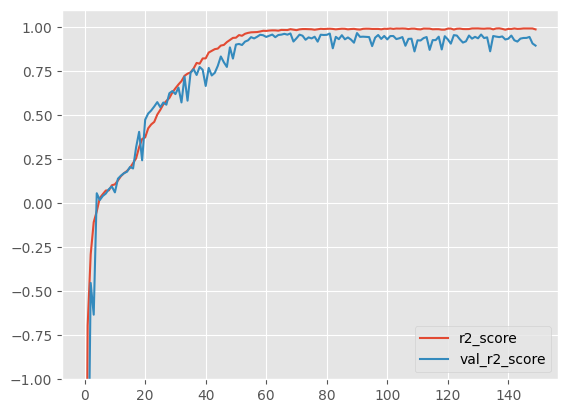

In [ ]:
history[['loss', 'val_loss']].plot(ylim=[-0.001, 0.005])
plt.show()

history[['r2_score', 'val_r2_score']].plot(ylim=[-1,1.1])
plt.show()

In [ ]:
history = model.fit(X_sub_train, Y_sub_train, epochs=150, batch_size=32, validation_data=(X_validation, Y_validation))

history = pd.DataFrame(history.history)

Epoch 1/150
30/30 [==============================] - 0s 5ms/step - loss: 2.0876e-05 - r2_score: 0.9935 - val_loss: 9.9821e-05 - val_r2_score: 0.9480
Epoch 2/150
30/30 [==============================] - 0s 3ms/step - loss: 2.9810e-05 - r2_score: 0.9907 - val_loss: 1.2139e-04 - val_r2_score: 0.9368
Epoch 3/150
30/30 [==============================] - 0s 3ms/step - loss: 1.9928e-05 - r2_score: 0.9938 - val_loss: 1.2152e-04 - val_r2_score: 0.9367
Epoch 4/150
30/30 [==============================] - 0s 3ms/step - loss: 2.3263e-05 - r2_score: 0.9927 - val_loss: 1.0843e-04 - val_r2_score: 0.9435
Epoch 5/150
30/30 [==============================] - 0s 3ms/step - loss: 2.2475e-05 - r2_score: 0.9930 - val_loss: 1.0780e-04 - val_r2_score: 0.9438
Epoch 6/150
30/30 [==============================] - 0s 3ms/step - loss: 1.8993e-05 - r2_score: 0.9941 - val_loss: 1.1050e-04 - val_r2_score: 0.9424
Epoch 7/150
30/30 [==============================] - 0s 3ms/step - loss: 2.3501e-05 - r2_score: 0.9927 - v

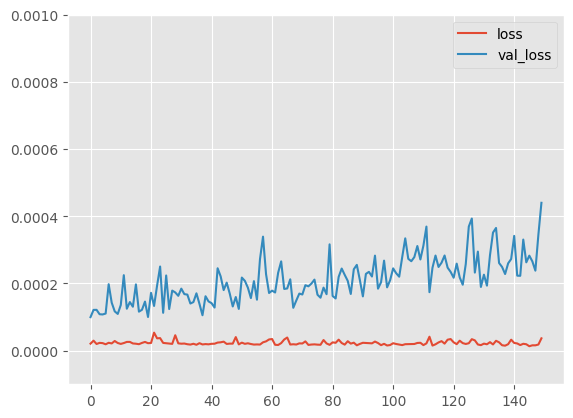

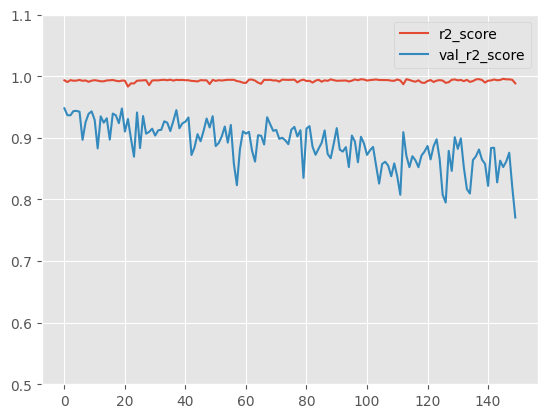

In [ ]:
history[['loss', 'val_loss']].plot(ylim=[-0.0001, 0.001])
plt.show()

history[['r2_score', 'val_r2_score']].plot(ylim=[0.5,1.1])
plt.show()

In [ ]:
## Model 2: More complex model

# set the random seed for reproducible results
# the random weights of the hidden layers and the output layer will be the same
tf.keras.utils.set_random_seed(42)

model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(X_train.shape[1],)),
    tf.keras.layers.Normalization(),
    tf.keras.layers.Dense(units=15, activation="relu"),
    tf.keras.layers.Dense(units=15, activation="relu"),
    tf.keras.layers.Dense(units=15, activation="relu"),
    tf.keras.layers.Dense(units=15, activation="relu"),
    tf.keras.layers.Dense(units=15, activation="relu"),
    tf.keras.layers.Dense(units=1)
])

model.compile(loss="mse",
              optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
              metrics=[tf.keras.metrics.R2Score()])

In [ ]:
history = model.fit(X_sub_train, Y_sub_train, epochs=150, batch_size=32, validation_data=(X_validation, Y_validation))

history = pd.DataFrame(history.history)

Epoch 1/150
30/30 [==============================] - 1s 10ms/step - loss: 0.0035 - r2_score: -0.0786 - val_loss: 0.0020 - val_r2_score: -0.0453
Epoch 2/150
30/30 [==============================] - 0s 4ms/step - loss: 0.0031 - r2_score: 0.0256 - val_loss: 0.0016 - val_r2_score: 0.1416
Epoch 3/150
30/30 [==============================] - 0s 5ms/step - loss: 0.0028 - r2_score: 0.1198 - val_loss: 0.0016 - val_r2_score: 0.1465
Epoch 4/150
30/30 [==============================] - 0s 6ms/step - loss: 0.0026 - r2_score: 0.1858 - val_loss: 0.0016 - val_r2_score: 0.1659
Epoch 5/150
30/30 [==============================] - 0s 6ms/step - loss: 0.0024 - r2_score: 0.2428 - val_loss: 0.0015 - val_r2_score: 0.2063
Epoch 6/150
30/30 [==============================] - 0s 6ms/step - loss: 0.0021 - r2_score: 0.3452 - val_loss: 0.0018 - val_r2_score: 0.0592
Epoch 7/150
30/30 [==============================] - 0s 6ms/step - loss: 0.0018 - r2_score: 0.4397 - val_loss: 0.0018 - val_r2_score: 0.0540
Epoch 8/15

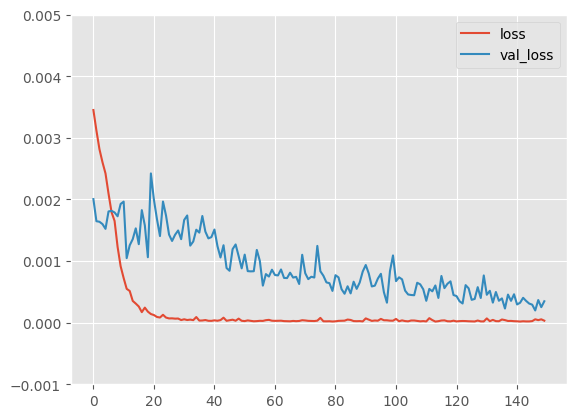

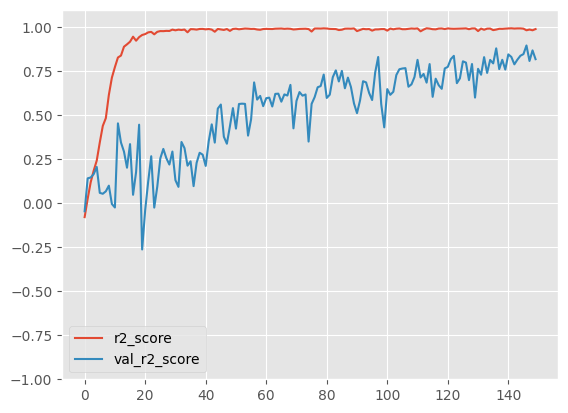

In [ ]:
history[['loss', 'val_loss']].plot(ylim=[-0.001, 0.005])
plt.show()

history[['r2_score', 'val_r2_score']].plot(ylim=[-1,1.1])
plt.show()

In [ ]:
history = model.fit(X_sub_train, Y_sub_train, epochs=150, batch_size=32, validation_data=(X_validation, Y_validation))

history = pd.DataFrame(history.history)

Epoch 1/150
30/30 [==============================] - 0s 8ms/step - loss: 2.9526e-05 - r2_score: 0.9908 - val_loss: 3.9725e-04 - val_r2_score: 0.7930
Epoch 2/150
30/30 [==============================] - 0s 5ms/step - loss: 5.0461e-05 - r2_score: 0.9842 - val_loss: 3.1702e-04 - val_r2_score: 0.8348
Epoch 3/150
30/30 [==============================] - 0s 5ms/step - loss: 3.0979e-05 - r2_score: 0.9903 - val_loss: 3.9140e-04 - val_r2_score: 0.7961
Epoch 4/150
30/30 [==============================] - 0s 6ms/step - loss: 1.9414e-05 - r2_score: 0.9939 - val_loss: 2.7096e-04 - val_r2_score: 0.8588
Epoch 5/150
30/30 [==============================] - 0s 7ms/step - loss: 1.7277e-05 - r2_score: 0.9946 - val_loss: 4.7806e-04 - val_r2_score: 0.7509
Epoch 6/150
30/30 [==============================] - 0s 6ms/step - loss: 2.3845e-05 - r2_score: 0.9925 - val_loss: 2.2622e-04 - val_r2_score: 0.8821
Epoch 7/150
30/30 [==============================] - 0s 8ms/step - loss: 2.1958e-05 - r2_score: 0.9931 - v

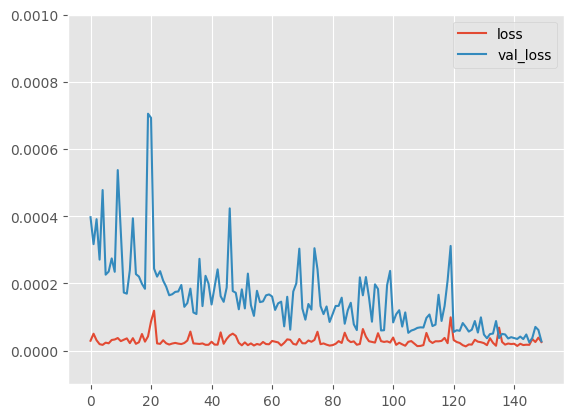

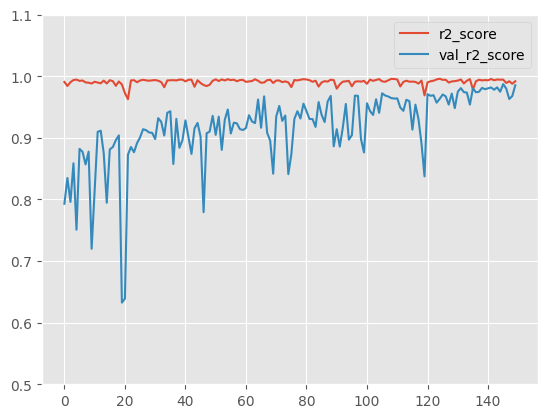

In [ ]:
history[['loss', 'val_loss']].plot(ylim=[-0.0001, 0.001])
plt.show()

history[['r2_score', 'val_r2_score']].plot(ylim=[0.5,1.1])
plt.show()

In [ ]:
history = model.fit(X_sub_train, Y_sub_train, epochs=150, batch_size=32, validation_data=(X_validation, Y_validation))

history = pd.DataFrame(history.history)

Epoch 1/150
30/30 [==============================] - 0s 5ms/step - loss: 2.3857e-05 - r2_score: 0.9925 - val_loss: 1.0894e-04 - val_r2_score: 0.9432
Epoch 2/150
30/30 [==============================] - 0s 3ms/step - loss: 5.2536e-05 - r2_score: 0.9836 - val_loss: 1.8367e-04 - val_r2_score: 0.9043
Epoch 3/150
30/30 [==============================] - 0s 3ms/step - loss: 2.7185e-05 - r2_score: 0.9915 - val_loss: 9.5937e-05 - val_r2_score: 0.9500
Epoch 4/150
30/30 [==============================] - 0s 4ms/step - loss: 1.7840e-05 - r2_score: 0.9944 - val_loss: 2.8483e-05 - val_r2_score: 0.9852
Epoch 5/150
30/30 [==============================] - 0s 4ms/step - loss: 1.6298e-05 - r2_score: 0.9949 - val_loss: 8.3198e-05 - val_r2_score: 0.9567
Epoch 6/150
30/30 [==============================] - 0s 4ms/step - loss: 1.8969e-05 - r2_score: 0.9941 - val_loss: 2.6212e-05 - val_r2_score: 0.9863
Epoch 7/150
30/30 [==============================] - 0s 3ms/step - loss: 1.8382e-05 - r2_score: 0.9943 - v

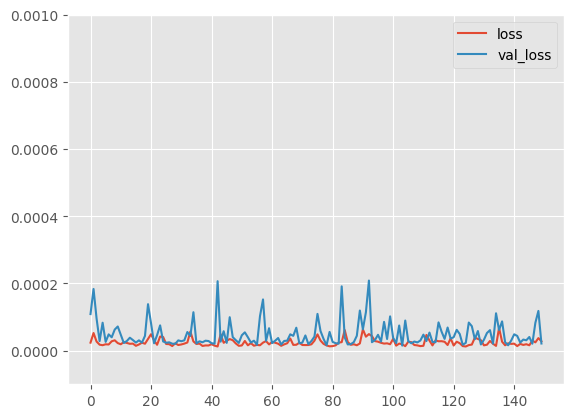

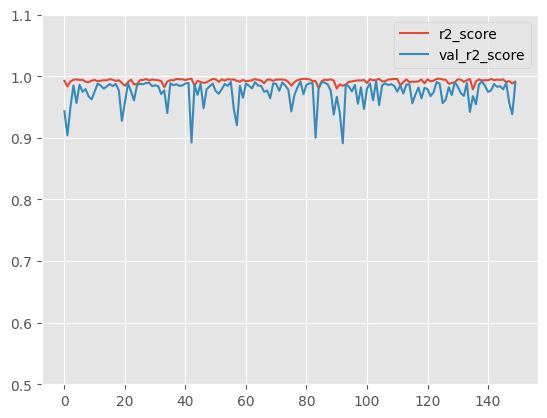

In [ ]:
history[['loss', 'val_loss']].plot(ylim=[-0.0001, 0.001])
plt.show()

history[['r2_score', 'val_r2_score']].plot(ylim=[0.5,1.1])
plt.show()

### Feature Extraction with a Sequential Model

- Once a sequential model has been built, we can access each layer like a function.

- This means each layer has an **input** and **output** attribute.

- These attributes can be used to quickly extract the outputs of all intermediate layers.

  - You might use this if you wanted to see what was happening layer-by-layer.

  - You could try to explain what the layers are doing, doing model diagnostics, apply SHAP values, run correlations, etc.

- We will use the <a href="https://keras.io/api/models/model/">Keras Model class</a> while implementing this feature extractor.

  - The Model class allows you to write more complicated models that don't easily fit into the Sequential API class.

    - The Sequential API is a special case of the Model class where the model is purely a stack of single input and single output layers.

  - It allows you to pass differnt layers in an **input** and **output** argument that can be treated as a a single model and fully specifys the model's **forward pass**.

    - Note that it allows for more than one input layer and more than one output layer.

In [ ]:
model

In [ ]:
model.inputs

[<KerasTensor: shape=(None, 15) dtype=float32 (created by layer 'input_6')>]

In [ ]:
model.layers

In [ ]:
model.layers[3].output

<KerasTensor: shape=(None, 15) dtype=float32 (created by layer 'dense_21')>

In [ ]:
feature_extractor = tf.keras.Model(inputs=model.inputs,
                                   outputs=[model.layers[0].output, # normalization layer
                                            model.layers[1].output, model.layers[2].output, model.layers[3].output, model.layers[4].output, model.layers[5].output, # hidden layers
                                            model.layers[6].output]) # output layer

## Note you can replace "outputs" with the list comprehension [layer.output for layer in model.layers]

In [ ]:
# Call the feature extractor model on a single point of data

sample_data = X_train.iloc[0]

feature_extractor(sample_data)

[<tf.Tensor: shape=(1, 15), dtype=float32, numpy=
 array([[ 4.4147584e-01, -5.8617508e-01, -2.2000000e-03,  9.9999998e-03,
         -2.9730124e+00, -2.9565694e+00, -2.3868372e+00,  0.0000000e+00,
          7.7999998e-03,  3.5399999e-02,  5.0876178e-02,  4.6461780e-04,
          3.0700000e-02,  4.6999999e-03,  2.6937000e-02]], dtype=float32)>,
 <tf.Tensor: shape=(1, 15), dtype=float32, numpy=
 array([[0.159461  , 0.        , 0.        , 0.10428891, 0.20863517,
         0.32075563, 0.        , 0.33697847, 0.        , 0.4153801 ,
         0.        , 0.        , 0.        , 1.1500658 , 0.08518482]],
       dtype=float32)>,
 <tf.Tensor: shape=(1, 15), dtype=float32, numpy=
 array([[0.5790099 , 0.13266136, 0.        , 0.        , 0.08304926,
         0.06694373, 0.15953909, 0.        , 0.1682482 , 0.        ,
         0.        , 0.        , 0.        , 0.12028425, 0.        ]],
       dtype=float32)>,
 <tf.Tensor: shape=(1, 15), dtype=float32, numpy=
 array([[0.09934507, 0.        , 0.    

In [ ]:
processed_features = feature_extractor(sample_data)

np.squeeze(processed_features[0].numpy())

array([ 4.4147584e-01, -5.8617508e-01, -2.2000000e-03,  9.9999998e-03,
       -2.9730124e+00, -2.9565694e+00, -2.3868372e+00,  0.0000000e+00,
        7.7999998e-03,  3.5399999e-02,  5.0876178e-02,  4.6461780e-04,
        3.0700000e-02,  4.6999999e-03,  2.6937000e-02], dtype=float32)

- This allows us to look how each layer is processing a single point of data.

In [ ]:
pd.DataFrame({'Input_Layer':sample_data,
              'Normalization_Layer': np.squeeze(processed_features[0].numpy()),
              'Processing_Layer_1': np.squeeze(processed_features[1].numpy()),
              'Processing_Layer_2': np.squeeze(processed_features[2].numpy()),
              'Processing_Layer_3': np.squeeze(processed_features[3].numpy()),
              'Processing_Layer_4': np.squeeze(processed_features[4].numpy()),
              'Processing_Layer_5': np.squeeze(processed_features[5].numpy()),
              'Output_Layer': np.squeeze(processed_features[6].numpy()),})

,Input_Layer,Normalization_Layer,Processing_Layer_1,Processing_Layer_2,Processing_Layer_3,Processing_Layer_4,Processing_Layer_5,Output_Layer
b/m,0.441476,0.441476,0.159461,0.579010,0.099345,0.277597,0.107343,0.020368
de,-0.586175,-0.586175,0.000000,0.132661,0.000000,0.116154,0.000000,0.020368
dfr,-0.002200,-0.002200,0.000000,0.000000,0.000000,0.052368,0.045271,0.020368
dfy,0.010000,0.010000,0.104289,0.000000,0.000000,0.000000,0.004031,0.020368
dp,-2.973012,-2.973012,0.208635,0.083049,0.061936,0.084742,0.091378,0.020368
dy,-2.956570,-2.956569,0.320756,0.066944,0.243689,0.000000,0.000000,0.020368
ep,-2.386837,-2.386837,0.000000,0.159539,0.000000,0.000000,0.000000,0.020368
infl,0.000000,0.000000,0.336978,0.000000,0.033845,0.000000,0.000000,0.020368
ltr,0.007800,0.007800,0.000000,0.168248,0.000000,0.080184,0.118500,0.020368
lty,0.035400,0.035400,0.415380,0.000000,0.000000,0.000000,0.000000,0.020368


- We can also treat each layer as algorithmically generating new features.

- Thinking about each layer as a new feature representation allows us to do the same type of descriptive analytics of the layers that we can do with the original data set.

  - This includes correlating the newly represented features with eachother, with the target, and with the original feature variables.

  - It can also include any types of plots, linear regressions, scatter plots, univariate or multivariate analysis, etc.

- Hopefully wou will be able to understand what the layers are doing to the features, but it is more likely that they won't be easily interpreted.

#### Layers vs Target

- We will look at how the layer representations of the data relate to eachother and to the target.

In [ ]:
layer_1_feature_representations = pd.DataFrame(feature_extractor(X_train)[1].numpy(), index=X_train.index)

layer_1_data = pd.concat([layer_1_feature_representations, Y_train], axis=1)

layer_1_data

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,returns
yyyymm,,,,,,,,,,,,,,,,
1927-01-01,0.159461,0.0,0.0,0.104289,0.208635,0.320756,0.0,0.336978,0.0,0.415380,0.0,0.0,0.0,1.150066,0.085185,0.026047
1927-02-01,0.174229,0.0,0.0,0.103666,0.204236,0.330675,0.0,0.349632,0.0,0.429725,0.0,0.0,0.0,1.140669,0.087533,-0.002910
1927-03-01,0.149384,0.0,0.0,0.104877,0.203174,0.319424,0.0,0.333395,0.0,0.435977,0.0,0.0,0.0,1.184457,0.093695,0.045522
1927-04-01,0.185099,0.0,0.0,0.137962,0.140704,0.309815,0.0,0.340904,0.0,0.445743,0.0,0.0,0.0,1.164353,0.072102,0.007324
1927-05-01,0.175238,0.0,0.0,0.122932,0.175480,0.317771,0.0,0.341166,0.0,0.474108,0.0,0.0,0.0,1.187016,0.094027,0.013021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-01-01,0.075399,0.0,0.0,0.000000,0.538577,0.491825,0.0,0.466398,0.0,0.343754,0.0,0.0,0.0,1.399977,0.072070,0.008508
2013-02-01,0.057837,0.0,0.0,0.000000,0.513485,0.477928,0.0,0.460951,0.0,0.337170,0.0,0.0,0.0,1.429006,0.069219,0.052361
2013-03-01,0.079656,0.0,0.0,0.000000,0.496539,0.457544,0.0,0.472673,0.0,0.339330,0.0,0.0,0.0,1.404546,0.052869,0.013013


In [ ]:
layer_1_data.describe().T

,count,mean,std,min,25%,50%,75%,max
0,1037.0,0.207224,0.102222,0.000000,0.154511,0.212753,0.255965,0.801943
1,1037.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,1037.0,0.000103,0.001753,0.000000,0.000000,0.000000,0.000000,0.046597
3,1037.0,0.170485,0.134418,0.000000,0.081060,0.172779,0.233457,0.917386
4,1037.0,0.229260,0.183920,0.000000,0.096063,0.196529,0.303969,0.743401
5,1037.0,0.370403,0.079502,0.000000,0.326903,0.370847,0.412972,0.561057
6,1037.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,1037.0,0.373447,0.109323,0.000000,0.294010,0.378116,0.444060,0.642131
8,1037.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
9,1037.0,0.508635,0.183076,0.184613,0.389791,0.495196,0.573589,1.768667


<Axes: xlabel='yyyymm'>

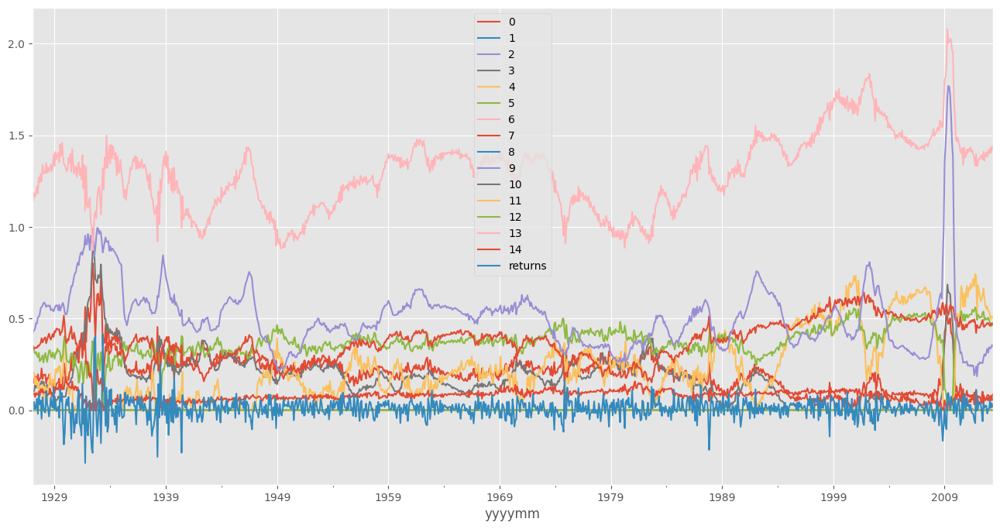

In [ ]:
layer_1_data.plot(figsize=(16,8))

In [ ]:
layer_1_data.corr()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,returns
0,1.000000,NaN,-0.105073,0.954981,-0.792503,-0.650358,NaN,-0.644774,NaN,0.561223,NaN,NaN,NaN,-0.453440,-0.411165,-0.242646
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,-0.105073,NaN,1.000000,-0.074673,0.147655,0.122185,NaN,0.036209,NaN,-0.081302,NaN,NaN,NaN,0.033065,0.037348,0.073148
3,0.954981,NaN,-0.074673,1.000000,-0.760886,-0.701927,NaN,-0.679357,NaN,0.567144,NaN,NaN,NaN,-0.428108,-0.428119,-0.005627
4,-0.792503,NaN,0.147655,-0.760886,1.000000,0.842818,NaN,0.555822,NaN,-0.567935,NaN,NaN,NaN,0.361316,0.374380,-0.012354
5,-0.650358,NaN,0.122185,-0.701927,0.842818,1.000000,NaN,0.309916,NaN,-0.764377,NaN,NaN,NaN,0.070424,0.399400,-0.174019
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,-0.644774,NaN,0.036209,-0.679357,0.555822,0.309916,NaN,1.000000,NaN,0.152399,NaN,NaN,NaN,0.916316,0.160888,-0.161821
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,0.561223,NaN,-0.081302,0.567144,-0.567935,-0.764377,NaN,0.152399,NaN,1.000000,NaN,NaN,NaN,0.425899,-0.324645,-0.058123


In [ ]:
layer_1_data.corr()[['returns']].sort_values(by='returns')

,returns
0,-0.242646
5,-0.174019
7,-0.161821
9,-0.058123
4,-0.012354
3,-0.005627
13,0.068199
14,0.068861
2,0.073148
returns,1.000000


#### Layers vs Features

- We will look at how the layer representations of the data relate to the original features, which are "layer 0" / "input layer" representations.

- Note that we can also compare the layers with eachother, not just the input layer variables.

In [ ]:
layer_5_feature_representations = pd.DataFrame(feature_extractor(X_train)[5].numpy(), index=X_train.index)

layer_5_book_to_market = pd.concat([layer_5_feature_representations, X_train[['b/m']]], axis=1)

layer_5_book_to_market

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,b/m
yyyymm,,,,,,,,,,,,,,,,
1927-01-01,0.107343,0.0,0.045272,0.004031,0.091379,0.0,0.0,0.0,0.118500,0.0,0.0,0.049408,0.097931,0.098073,0.0,0.441476
1927-02-01,0.090949,0.0,0.039861,0.019725,0.073579,0.0,0.0,0.0,0.128982,0.0,0.0,0.046228,0.117831,0.099847,0.0,0.443706
1927-03-01,0.121640,0.0,0.049723,0.000000,0.105347,0.0,0.0,0.0,0.109842,0.0,0.0,0.053001,0.082183,0.097868,0.0,0.428501
1927-04-01,0.102556,0.0,0.036400,0.006805,0.090579,0.0,0.0,0.0,0.118450,0.0,0.0,0.045670,0.104613,0.101840,0.0,0.469765
1927-05-01,0.108619,0.0,0.039313,0.001819,0.095459,0.0,0.0,0.0,0.115660,0.0,0.0,0.047657,0.098833,0.101494,0.0,0.456754
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-01-01,0.121637,0.0,0.086233,0.002813,0.066200,0.0,0.0,0.0,0.153616,0.0,0.0,0.084298,0.111622,0.096319,0.0,0.349032
2013-02-01,0.139675,0.0,0.093603,0.000000,0.084283,0.0,0.0,0.0,0.141212,0.0,0.0,0.088660,0.088445,0.094027,0.0,0.329984
2013-03-01,0.118654,0.0,0.080960,0.001790,0.069519,0.0,0.0,0.0,0.147301,0.0,0.0,0.079663,0.108544,0.093727,0.0,0.325431


In [ ]:
layer_5_book_to_market.describe().T

,count,mean,std,min,25%,50%,75%,max
0,1037.0,0.114126,0.024857,0.000000,0.101927,0.114790,0.128136,0.276440
1,1037.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,1037.0,0.041217,0.027492,0.000000,0.022962,0.039153,0.053779,0.120540
3,1037.0,0.007399,0.012804,0.000000,0.000000,0.000000,0.010578,0.110875
4,1037.0,0.093695,0.031429,0.000000,0.076116,0.092643,0.108970,0.319339
5,1037.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,1037.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,1037.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,1037.0,0.132430,0.023592,0.000000,0.116514,0.130663,0.146910,0.231568
9,1037.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


<Axes: xlabel='yyyymm'>

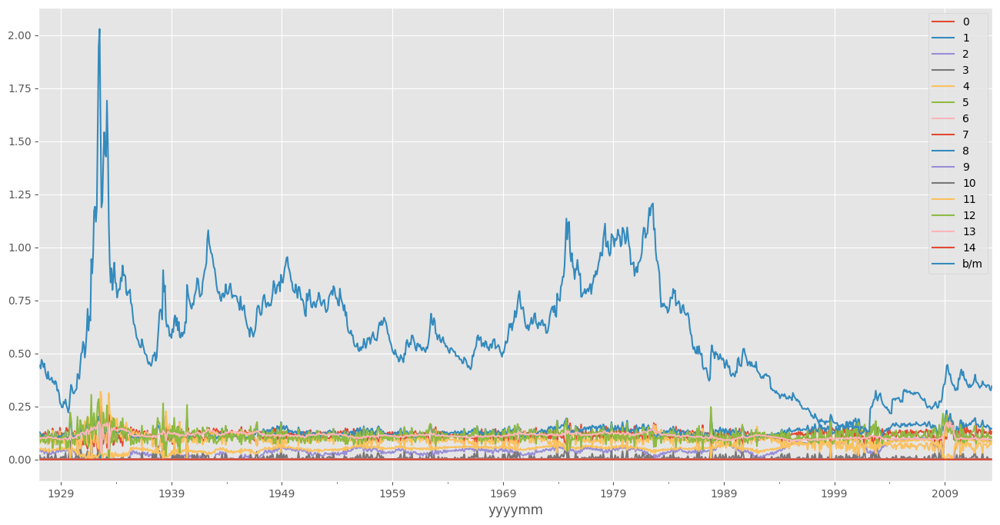

In [ ]:
layer_5_book_to_market.plot(figsize=(16,8))

In [ ]:
layer_5_book_to_market.corr()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,b/m
0,1.000000,NaN,0.282222,-0.763789,0.745760,NaN,NaN,NaN,-0.485525,NaN,NaN,0.386201,-0.849997,-0.220338,NaN,-0.000020
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.282222,NaN,1.000000,-0.165722,-0.388909,NaN,NaN,NaN,0.373277,NaN,NaN,0.940269,-0.279438,-0.694503,NaN,-0.537795
3,-0.763789,NaN,-0.165722,1.000000,-0.628177,NaN,NaN,NaN,0.523104,NaN,NaN,-0.202965,0.765066,0.121122,NaN,0.048147
4,0.745760,NaN,-0.388909,-0.628177,1.000000,NaN,NaN,NaN,-0.703844,NaN,NaN,-0.298321,-0.609051,0.253007,NaN,0.371855
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,-0.485525,NaN,0.373277,0.523104,-0.703844,NaN,NaN,NaN,1.000000,NaN,NaN,0.211302,0.713088,0.147039,NaN,-0.091877
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
layer_5_book_to_market.corr()[['b/m']].sort_values(by='b/m')

,b/m
2,-0.537795
11,-0.510763
8,-0.091877
0,-0.000020
3,0.048147
12,0.156659
4,0.371855
13,0.701637
b/m,1.000000
1,NaN


- For more on the Sequential API from Keras, see the <a href="https://keras.io/guides/sequential_model/">Sequential model developer docs from Keras</a>.

$\rule{800pt}{20pt}$

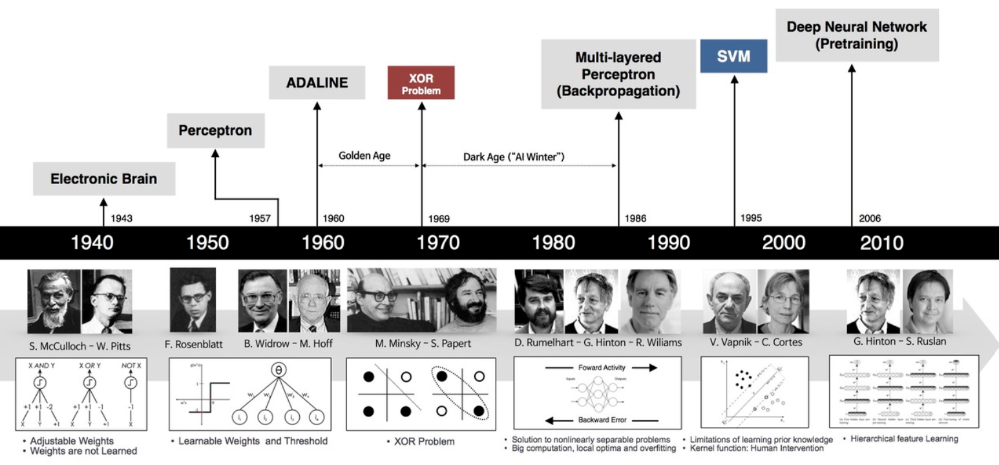

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'history_of_deep_learning_and_backpropagation.png'))

## Back to Training: The Backpropagation Algorithm
<br>
<font size="+1">
<ul>
  <li>We need to revisit training again because it is a fundamental component of actually making AI systems work in the real world.</li>
  <br>
  <ul>
    <li>Many of the business applications we study require us to make tweaks to the models; unfortunately it is very rare that the <i>out-of-the-box</i> solution will work as intended on the first try.</li>
    <br>
    <li>This means we need to understand the appropriate concepts that impact the development of these deep learning models.</li>
    <br>
    <li>One major concept that makes deep learning models work is the <b>backpropagation algorithm</b>, which powers one-half of the training loop (the other half is forward propagation).</li>
    <br>
  </ul>
<br>
$\rule{800pt}{10pt}$
<br>
<br>
  <li><details><summary><a href="https://www.linkedin.com/pulse/history-neural-networks-datta-dharanikota/">An interesting history of backpropagation</a></summary>
  <br>
  <li>As we have seen, the field of deep learning is interested in models containing deep stacks of computations.</li>
    <br>
    <li>For many years, researchers struggled to find a way to train dense neural networks (multi-layer perceptrons).</li>
    <br>
    <li>In the early 1960s several researchers discussed the possibility of using gradient descent to estimate neural networks, which requires computing the gradients of the model's error with regard to the model parameters.</li>
    <br>
    <li><b>At the time, it wasn't clear how to compute the gradients efficiently with such a complex model.</b></li>
    <br>
    <ul>
      <li>In 1970, a researcher (<b>Seppo Linnainmaa</b>) introduced in his master's thesis a technique to compute all the gradients automatically and efficiently.</li>
      <br>
      <li>This algorithm is now called <b>reverse-mode automatic differentiation</b>.</li>
      <br>
      <li><b>In just two passes through the network (one forward and one backward), it is able to compute the gradients of the NN's error with regard to every single model parameter.</b></li>
      <br>
      <li>I.e. it can find out how each connection weight and each bias needs to be tweaked in order to reduce the neural network's error.</li>
      <br>
      <li>These gradients can then be used to perform a gradient descent step.</li>
      <br>
      <li>Doing this repeatedly will change the error gradually until it eventually reaches a minimum.</li>
      <br>
      <li><b>This combination of reverse-mode autodifferentiation and gradient descent is now called <i>backpropagation</i></b></li>
      <br>
    </ul>
    <font color="red"><li>Backpropagation can actually be applied to all sorts of computational graphs, not just neural networks.</li></font>
    <br>
    <li>In 1985, Geoffrey Hinton, et al., <a href="https://stanford.edu/~jlmcc/papers/PDP/Volume%201/Chap8_PDP86.pdf">published a paper</a> analyzing how backpropagation allowed neural networks to learn useful internal representations.</li>
    <br>
    <li>Their results were so impressive that backpropagation was quickly popularized and is by far the most popular training technique for neural networks.</li>
    <br>
    <li>For more, see <a href="https://people.idsia.ch/~juergen/who-invented-backpropagation.html">"Who Invented Backpropagation" by  Jürgen Schmidhuber (the researcher who invented LSTM)</a></li></details></li>
    <br>
    <br>
    $\rule{800pt}{10pt}$
    <br>
    <br>
  </ul>
</font>

$\square$


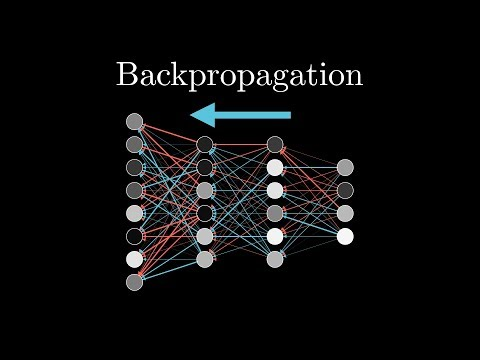

In [ ]:
from IPython.display import YouTubeVideo
# https://www.youtube.com/watch?v=Ilg3gGewQ5U&t=627s
YouTubeVideo('Ilg3gGewQ5U', width=1200, height=800)

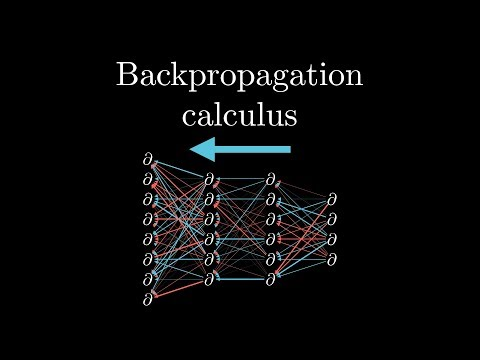

In [ ]:
## YOU CAN IGNORE THIS VIDEO, it is about the math of the backpropagation algorithm and how it computes the chain rule in an automated way

from IPython.display import YouTubeVideo
# https://www.youtube.com/watch?v=tIeHLnjs5U8&t=12s
YouTubeVideo('tIeHLnjs5U8', width=1200, height=800)

### Recall: Computing Gradients with TensorFlow's Gradient Tape API (TF's implementation of the backpropagation algorithm)
<br>
<font size="+1">
  <ul>
    <font color="blue"><li>All this talk of the gradient of a loss function $$\nabla L(w)$$ begs the question of <b>how to actually compute this quantity</b> in the first place, without having to learn Calculus III and do a lot of hand computations</li></font>
    <br>
    <li>As with everything in deep learning, there is an algorithm behind the methodology to automatically compute the gradient of loss functions coming from neural networks; this methodology is known as the backpropagation algorithm (we will discuss this in the next module).</li>
    <br>
    <ul>
      <li>This leads to <b>reverse-mode autodifferentiation</b> $\iff$ <b>backpropagation</b>. For more, see <a href="https://www.tensorflow.org/guide/autodiff">TensorFlow's introduction to gradients and automatic differentiation</a>.</li>
      <br>
    </ul>
    <li><details><summary>Recall TensorFlow's GradientTape API for computing derivatives using reverse-mode autodifferentiation, i.e. backpropagation.</summary>
    <br>
    <li>We have learned to use software that will automatically differentiate a loss function with respect to weights.</li>
    <br>
    <li>The API through which we can access TensorFlow's powerful automatic differentiation software is known as the <a href="https://www.tensorflow.org/api_docs/python/tf/GradientTape">Gradient Tape API</a>.</li>
    <br>
    <ul>
      <li>In other words, GradientTape is TensorFlow's software implementation of the backpropagation algorithm for computing gradients of functions.</li>
      <br>
    </ul>
    <font color="red"><li>GradientTape is a Python <b>scope</b> that will <b>record</b> the operations (e.g. the loss function) that run inside of the scope in thet form of a computation graph (flowchart, also called a <i>tape</i>).</li>
    <br>
    <li>This graph can be used to retrieve the gradient of any output with respect to any variable(s) (e.g. the parameter weights) that must be <b>tf.Variable() objects</b>.</li></font>
    <br></details>
    <br>
    <br>
    $\rule{800pt}{10pt}$
    <br>
    <br>
  </ul>
</font>

$\square$

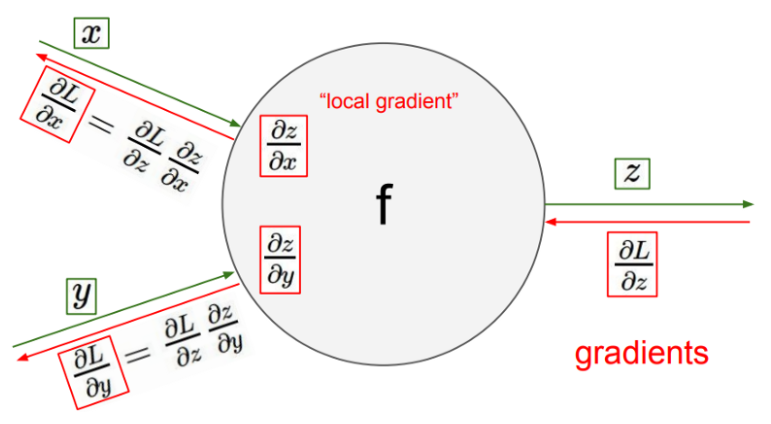

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'autodiff_1.png'))

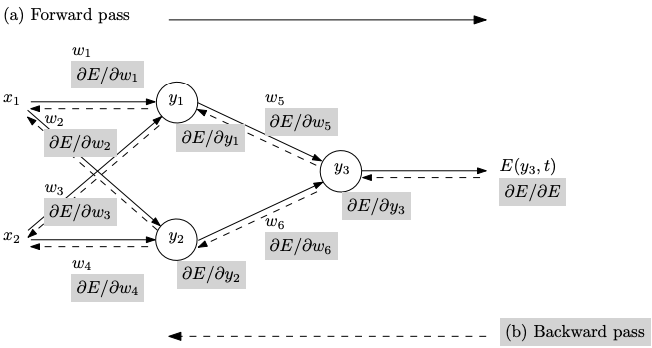

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'autodiff_2.png'))

### How does Backpropagation Work?
<br>
<font size="+1">
  <ul>
    <ol>
      <li>It handles one mini-batch at a time (e.g. containing 32 instances each), and it goes through the full training set multiple times (many epochs), where each pass through the full training set is called an <i>epoch</i>.</li>
      <br>
      <li>The <b>forward-pass</b>.</li>
      <br>
      <ul>
        <li>Each mini-batch enters the network through the input layer. The algorithm then computes the output of all the neurons in the first hidden layer for every instance in the mini-batch. The result is passed on to the next layer, and so on until we get the output of the last (output) layer.</li>
        <br>
        <li>This is exactly like making predictions, except all intermediate results are preserved since they are needed for the backward pass.</li>
        <br>
      </ul>
      <li>The algorithm measures the network's output error, i.e. it computes the loss function for the mini-batch.</li>
      <br>
      <li>The <b>backward-pass</b>.</li>
      <br>
      <ul>
        <li>The algorithm then computes how much each output bias and each connection weight contributed to the error, which is done by using the chain rule.</li>
        <br>
        <li>The algorithm then measures how much of these errors contributions came from each connection in the layer below, working backward until it reaches the input layer.</li>
        <br>
        <li>The reverse pass efficiently measures the error gradient across all the connection weights and biases in the network by propagating the error gradient backward through the network.</li>
        <br>
      </ul>
      <li>Finally, the algorithm performs a gradient descent step to tweak all the connection weights in the network, using the error gradients that were just computed.</li>
      <br>
    </ol>
    <li><b>It is important to initialize all the hidden layers' connection weights randomly, or else training will fail.</b></li>
    <br>
    <ul>
      <li>If you initialize all weights and biases to zero, then all neurons in a given layer will be identically equal, and so backpropagation will affect them in exactly the same way, so they will remain identical.</li>
      <br>
      <li>Even if you have hundreds of neurons per layer, your model will act as if it had only one neuron per layer.</li>
      <br>
    </ul>
  </ul>
</font>
$̇\square$

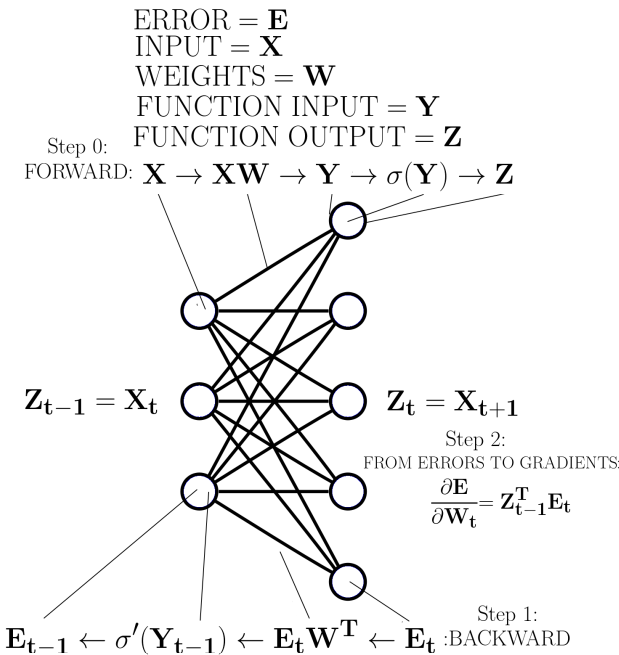

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'from_errors_to_gradients.png'))

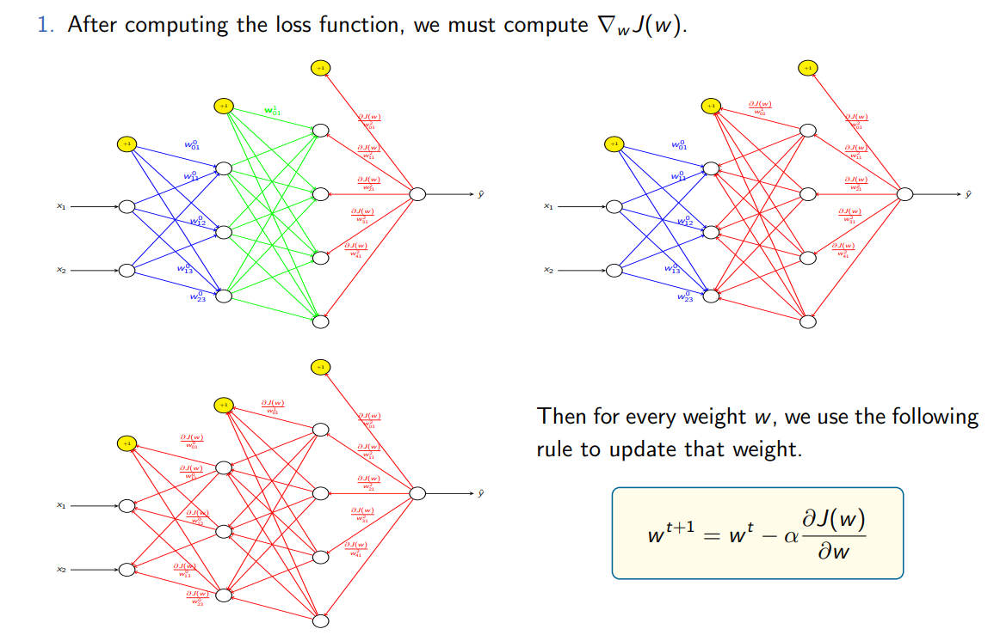

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'backpropagation_of_errors.png'))

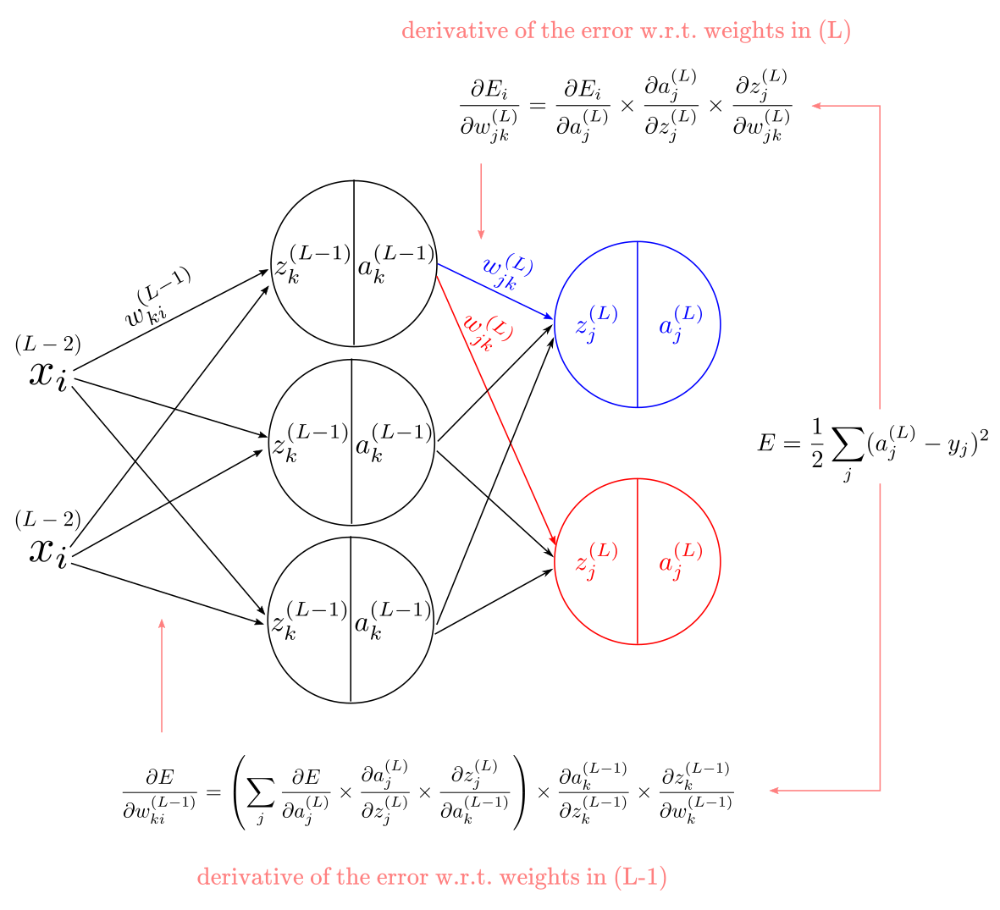

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'backprop.png'))

<br>
<font size="+1">
  <ul>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <li>Backpropagation</li>
    <br>
    <ul>
      <li>makes predictions for a mini-batch (forward pass),</li>
      <br>
      <li>measures the error on the mini-batch,</li>
      <br>
      <li>then goes through each layer in reverse to measure the error contribution from each parameter (reverse pass),</li>
      <br>
      <li>and finally tweaks the connection weights and biases to reduce the error (gradient descent step).</li>
      <br>
    </ul>
    <li>In order for backpropagation to work properly, Hinton, et al. made a key change to the dense neural network's architecture:</li>
    <br>
    <ul>
      <li>they replaced the step function with the logistic (sigmoid) function $\sigma(z) = \frac{1}{1 + e^{-z}}$.</li>
      <br>
    </ul>
    <li>This was essential because the step function contains only flat segments, so there is no gradient to compute (gradient descent cannot move on a flat surface).</li>
    <br>
    <br>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <li>Backpropagation algorithm works well with other activation functions as well:</li>
    <br>
    <ul>
      <li>The hyperbolic tangent function: $ tanh(z) = 2 \sigma(2z) - 1$.</li>
      <br>
      <ul>
        <li>This activation function ranges between -1 and 1, which tends to make each layer's output roughly centered around zero at the beginning of training, which often helps speed up convergence.</li>
        <br>
      </ul>
      <li>The rectified linear unit function: $ ReLU(z) = max\{0, z\} = 0 \vee z.$</li>
      <br>
      <ul>
        <li>This activation function has a slope that can change abruptly, which can make gradient descent bounce around, but it works very well in practice and has the advantage of being fast to compute.</li>
        <br>
        <li>It also has the advantage of being unbounded from above, which can help some issues during gradient descent.</li>
        <br>
      </ul>
    </ul>
    <li><a href="https://developer.nvidia.com/blog/deep-learning-nutshell-history-training/">NVIDIA's post: Deep Learning in a Nutshell: History and Training</a>, which is from their very interesting <a href="https://developer.nvidia.com/blog">tech blog</a>.</li>
    <br>
    <br>
    $\rule{800pt}{10pt}$
    <br>
    <br>
  </ul>
</font>
$̇\square$

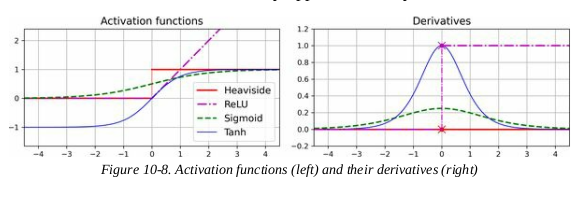

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'activation_functions_and_their_derivatives.png'))

<br>
<font size="+1">
  <ul>
    <li><b>Why do we need activation functions at all?</b></li>
    <br>
    <li>If you chain several linear transformations, you end up with a linear transformation.</li>
    <br>
    <li>If you don't have some nonlinearity between layers, then even a deep stack of layers is equivalent to a single layer.</li>
    <br>
    <li><b>At this point we know:</b></li>
    <br>
    <ul>
      <li>where neural networks came from,</li>
      <br>
      <li>what their architecture is,</li>
      <br>
      <li>how to compute their outputs,</li>
      <br>
      <li>and how the backpropagation algorithm works.</li>
      <br>
    </ul>
    <li>For more, see these <a href="https://sharif.edu/~beigy/courses/13992/40719/Lect-4to5.pdf">great set of notes</a>, which come from <a href="https://sharif.edu/~beigy/courses/13992/40719/">this set of course notes</a>.</li>
    <br>
    <li><b>How can we take what we know and build even better models with dense neural networks?</b></li>
    <br>
  </ul>
</font>
$̇\square$

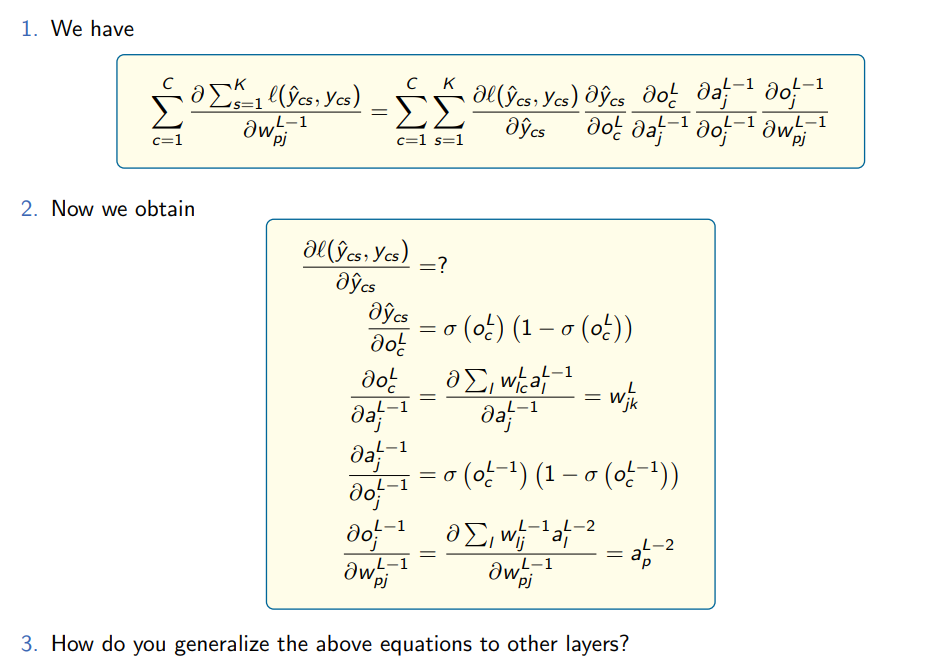

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'the_math_of_backpropagation_of_errors.png'))

$\rule{800pt}{20pt}$

$\rule{800pt}{20pt}$

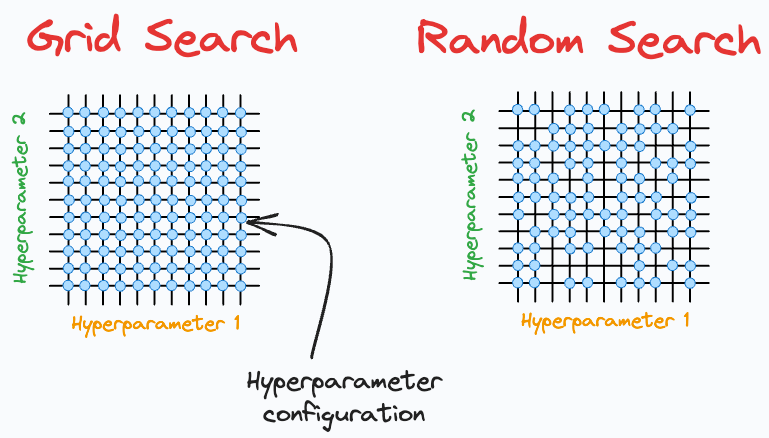

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'hyperparameter_tuning_I.png'))

# <h1>Fine-Tuning Neural-Network Hyperparameters</h1>
<br>
<font size="+1">
  <ul>
    <li>One of the greatest strengths of neural networks is their <b>flexibility</b>, but it  is also one of their greatest weaknesses if left unmanaged.</li>
    <br>
    <li>How is the flexibility of neural networks a weakness?</li>
    <br>
    <ul>
      <li>There are <b>so many hyperparameters</b> to tweak!</li>
      <br>
      <li>Not only can you use any imaginable network architecture, but even in a basic dense network you can change</li>
      <br>
      <ul>
        <li>the number of layers,</li>
        <br>
        <li>the number of neurons per layer,</li>
        <br>
        <li> and the type of activation function to use in each layer,</li>
        <br>
        <li>the weight initialization logic,</li>
        <br>
        <li>the type of optimizer to use</li>
        <br>
        <li>the optimizer's learning rate,</li>
        <br>
        <li>the optimizer's batch size,</li>
        <br>
        <li>the number of epochs,</li>
        <br>
        <li>etc.</li>
        <br>
      </ul>
      <li>How do you know what combination of hyperparameters is the best for your task?</li>
      <br>
    </ul>
    <li>An older workflow is to convert your Keras model to a Scikit-Learn estimator, and then use <a href="https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html">GridSearchCV</a> or <a href="https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.RandomizedSearchCV.html">RandomizedSearchCV</a> to fine-tune the hyperparameters. To do this conversion, you can use the KerasRegressor / KerasClassifier wrapper classes from the <a href="https://adriangb.com/scikeras/stable/">SciKeras library</a>.</li>
    <br>
    <li>Currently, there is a better workflow: use the <a href="https://keras.io/keras_tuner/">Keras Tuner library</a>.</li>
    <br>
    <ul>
      <li><a href="https://keras.io/api/keras_tuner/">KerasTuner API</a> offers different tuning strategies, it is highly customizable, and has good integration with TensorFlow.</li>
      <br>
      <li>You will likely need to install this library (use the following code).</li>
      <br>
    </ul>
    <br>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <li>Another very modern and scalable alternative is <a href="https://docs.ray.io/en/latest/tune/index.html">Ray's Tune library</a>.</li>
    <br>
    <li>For more, see these <a href="https://sharif.edu/~beigy/courses/13992/40719/Lect-6to7.pdf">great set of notes</a>, which come from <a href="https://sharif.edu/~beigy/courses/13992/40719/">this set of course notes</a>.</li>
    <br>
  </ul>
</font>
$̇\square$

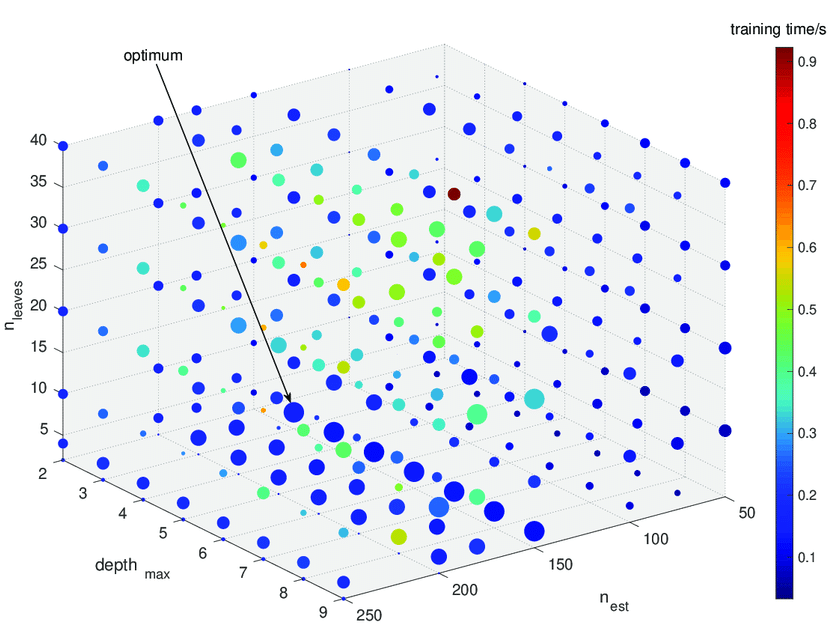

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'hyperparameter_tuning_II.png'))

In [ ]:
# ! pip install -q -U keras-tuner
! pip install keras-tuner

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.9/128.9 kB 2.6 MB/s eta 0:00:00


In [ ]:
import keras_tuner as kt

In [ ]:
# write a function that builds, compiles, and returns a Keras model
# the function must take a "kt.HyperParameters" object as an argument
## this object can be used to define hyperparameters and their range of possible values
## these hyperparams may be used to build and compile the model

# HyperParameter class in KerasTuner
# https://keras.io/api/keras_tuner/hyperparameters/

###################################################################################################
## Other classes in KerasTuner include:
# The Hyperparameters class is used to specify a set of hyperparameters and their values, to be used in the model building function.
# The Tuner subclasses corresponding to different tuning algorithms are called directly by the user to start the search or to get the best models.
# The Oracle subclasses are the core search algorithms, receiving model evaluation results from the Tuner and providing new hyperparameter values.
# The HyperModel subclasses are predefined search spaces for certain model families like ResNet and XceptionNet.
###################################################################################################

In [ ]:
# This function helps define the grid that KerasTuner needs to search over

def build_model(hyper_param):
  ##### First part of the function defines the hyperparameters
  ## The following "registers" hyperparameters to the HyperParameters object from KerasTuner
  # hyperparam 1: number of hidden dense layers
  num_hidden_layers = hyper_param.Int("num_hidden_layers", min_value=0, max_value=10, default=2)
  # hyperparam 2: number of neurons per layer
  num_units = hyper_param.Int("num_units", min_value=5, max_value=40)
  # hyperparam 3: constant learning rate
  learning_rate = hyper_param.Float("learning_rate", min_value=1e-4, max_value=1e-2, sampling="log")
  # hyperparam 4: choosing the optimizer algorithm
  # Values must be int, float, str, or bool. All values must be of the same type.
  optimizer = hyper_param.Choice("optimizer", values=["sgd", "adam", "rmsprop"])
  if optimizer == "sgd":
    optimizer = tf.keras.optimizers.SGD(learning_rate=learning_rate)
  elif optimizer == "adam":
    optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)
  elif optimizer == "rmsprop":
    optimizer = tf.keras.optimizers.RMSprop(learning_rate=learning_rate)

  ##### Second part of the function builds the model using the hyperparameter values
  # build the sequential model using the hyperparameter values
  model = tf.keras.Sequential()
  model.add(tf.keras.layers.Input(shape=(X_train.shape[1], )),
            tf.keras.layers.Normalization())

  for num in range(num_hidden_layers):
    model.add(tf.keras.layers.Dense(units=num_units, activation="relu"))

  # add the final output layer
  model.add(tf.keras.layers.Dense(units=1))
  # compile the model
  model.compile(loss="mse",
                optimizer=optimizer,
                metrics=[tf.keras.metrics.R2Score()])

  return model


## Random Search for Searching Over Hyperparameter Space

- If you want to do a basic random search, you can

  - create a <a href="https://keras.io/api/keras_tuner/tuners/random/">kt.RandomSearch</a> tuner,
  
  - pass the **build_model** function to the constructor,
  
  - then call the tuner's **search()** method.

In [ ]:
random_search_tuner = kt.RandomSearch(build_model,
                                      objective="val_loss", # check if it has val_r2_score or val_mse
                                      max_trials=10, # number of model configurations
                                      seed=42)

random_search_tuner.search(X_sub_train, Y_sub_train, epochs=10,
                           validation_data=(X_validation, Y_validation))

Trial 10 Complete [00h 00m 05s]
val_loss: 0.002326368121430278

Best val_loss So Far: 0.0018841036362573504
Total elapsed time: 00h 01m 06s


- The RandomSearch tuner will first call the **build_model()** once with an empty Hyperparameters object, just to collect all the hyperparameter specifications

- Then it will run 10 trials:

  - For each trial, it builds a model using hyperparameters **that are randomly sampled** within their ranges.

- Then it trains the model for some number of epochs.

- Since the tuner's objective is set to **val_loss**, the tuner prefers models with a lower validation loss.

- Once the tuner has finished searching, you can find the **best models** according to the objective.

In [ ]:
top_three_models = random_search_tuner.get_best_models(num_models=3)

top_three_models

In [ ]:
best_model = top_three_models[0]

- You can also find the **best hyperparameter configurations** according to the objective.

In [ ]:
top_three_params = random_search_tuner.get_best_hyperparameters(num_trials=3)

{top_three_params[i]: top_three_params[i].values for i in range(len(top_three_params))}

{<keras_tuner.src.engine.hyperparameters.hyperparameters.HyperParameters at 0x7eb263e9d4b0>: {'num_hidden_layers': 5,
  'num_units': 13,
  'learning_rate': 0.00905127409782462,
  'optimizer': 'adam'},
 <keras_tuner.src.engine.hyperparameters.hyperparameters.HyperParameters at 0x7eb263b8f9a0>: {'num_hidden_layers': 6,
  'num_units': 13,
  'learning_rate': 0.00041268008323824807,
  'optimizer': 'adam'},
 <keras_tuner.src.engine.hyperparameters.hyperparameters.HyperParameters at 0x7eb262fb76d0>: {'num_hidden_layers': 9,
  'num_units': 21,
  'learning_rate': 0.0005509513888645584,
  'optimizer': 'rmsprop'}}

In [ ]:
best_hyperparams = top_three_params[0].values

best_hyperparams

{'num_hidden_layers': 5,
 'num_units': 13,
 'learning_rate': 0.00905127409782462,
 'optimizer': 'adam'}

In [ ]:
# # Equivalently
# random_search_tuner.oracle.get_best_trials(num_trials=1)[0].summary()

# # Using the "trials oracle" to geet the metrics directly
# random_search_tuner.oracle.get_best_trials(num_trials=1)[0].metrics.get_last_value("val_loss")

- If your analysis through hyperparameter configuration feels thorough, you can continue training the best model for a few epochs on the full training set, and then evaluate it on the test set, and finally deploy it to production.

In [ ]:
best_model.fit(X_train, Y_train, epochs=20)

Epoch 1/20
33/33 [==============================] - 1s 5ms/step - loss: 0.0030 - r2_score: 0.0356
Epoch 2/20
33/33 [==============================] - 0s 3ms/step - loss: 0.0027 - r2_score: 0.1368
Epoch 3/20
33/33 [==============================] - 0s 3ms/step - loss: 0.0025 - r2_score: 0.1957
Epoch 4/20
33/33 [==============================] - 0s 3ms/step - loss: 0.0030 - r2_score: 0.0306
Epoch 5/20
33/33 [==============================] - 0s 3ms/step - loss: 0.0026 - r2_score: 0.1540
Epoch 6/20
33/33 [==============================] - 0s 3ms/step - loss: 0.0022 - r2_score: 0.2882
Epoch 7/20
33/33 [==============================] - 0s 3ms/step - loss: 0.0019 - r2_score: 0.3814
Epoch 8/20
33/33 [==============================] - 0s 3ms/step - loss: 0.0021 - r2_score: 0.3214
Epoch 9/20
33/33 [==============================] - 0s 3ms/step - loss: 0.0020 - r2_score: 0.3520
Epoch 10/20
33/33 [==============================] - 0s 3ms/step - loss: 0.0015 - r2_score: 0.4956
Epoch 11/20
33/33 [

In [ ]:
# best_model.evaluate(X_test, Y_test) # we're not quite ready to do this

- **In some instances, you might want to fine-tune hyperparameters related to**

  - **data preprocessing** (such as scaling rules, imputing nulls, etc.),

  - or **training loop** (i.e. model.fit()) arguments (such as the batch size, number of epochs, or learning rates).

- This requires using a slightly different technique.

  - You must subclass the <a href="https://keras.io/api/keras_tuner/hypermodels/">KerasTuner kt.HyperModel class</a> and define two methods:

    - **build()** (which does the exact same thing as the **build_model()** function: instantiate the hyperparameter objects and build the model's architecture),

    - and **fit()** (which takes a hyperparameter object and a compiled model as an argument, and other training loop arguments, and then fits the model and returns the history object).

In [ ]:
# An example

class MyRegressionHyperModel(kt.HyperModel):
  def build(self, hyper_param):
    return build_model(hyper_param)

  def fit(self, hyper_param, model, X, Y, **kwargs):
    if hyper_param.Boolean("normalize"):
      norm_layer = tf.keras.layers.Normalization()
      X = norm_layer(X)
    return model.fit(X, Y, **kwargs)

- You can then **pass an instance of this class to the tuner of your choice**, instead of passing the **build_model()** function.

In [ ]:
# random_search_tuner = kt.RandomSearch(MyRegressionHyperModel,
#                                       objective="val_loss", # check if it has val_r2_score or val_mse
#                                       max_trials=10, # number of model configurations
#                                       seed=42)

# random_search_tuner.search(X_sub_train, Y_sub_train, epochs=10,
#                            validation_data=(X_validation, Y_validation))

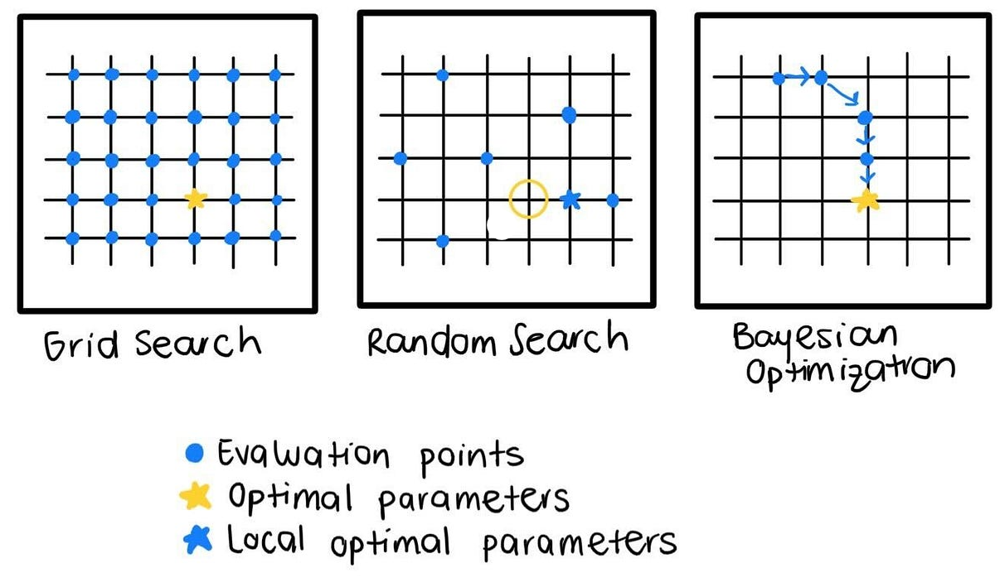

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'bayesian_optimization_for_hyperparams_search_I.png'))

## <a href="https://en.wikipedia.org/wiki/Bayesian_optimization#:~:text=Bayesian%20optimization%20is%20a%20sequential,expensive%2Dto%2Devaluate%20functions.">Bayesian Optimization</a> for Searching Over Hyperparameter Space

- Keras Tuner also includes a <a href="https://keras.io/api/keras_tuner/tuners/bayesian/">Bayesian Optimization tuner</a>, which is an algorithm that gradually learns which regions of the hyperparameter space are most promising.

- Bayesian Optimization tuner explores hyperparameter space by fitting a probabilistic model called a **Gaussian process**, which allows it to gradually zoom in on the best hyperparameters.

- But this algorithm isn't without a cost; it has its own hyperparameters:

  - alpha, which represents the level of noise you expect in the performance measures across trials (default is $10^{-4}$),

  - beta, which specifies the how much you want the algorithm to explore (as opposed to greedy decision) that is different from exploiting known good regions of hyperparameter space.

- For more on Bayesian optimization, see <a href="https://arxiv.org/pdf/1807.02811.pdf">here</a>.

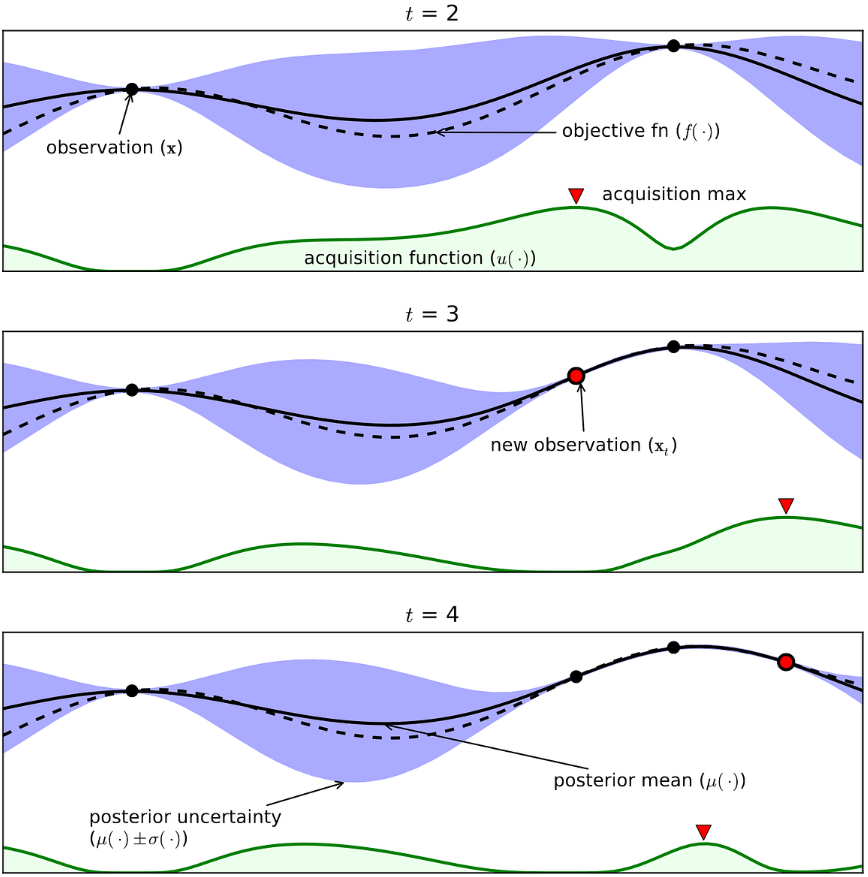

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'bayesian_optimization_for_hyperparams_search_II.png'))

In [ ]:
bayesian_opt_tuner = kt.BayesianOptimization(MyRegressionHyperModel(),
                                            objective="val_loss",
                                            seed=42,
                                            max_trials=10,
                                            overwrite=True,
                                            alpha=1e-4, beta=2.6)

bayesian_opt_tuner.search(X_sub_train, Y_sub_train, epochs=10,
                           validation_data=(X_validation, Y_validation))

Trial 10 Complete [00h 00m 05s]
val_loss: 0.0022892672568559647

Best val_loss So Far: 0.0017103629652410746
Total elapsed time: 00h 00m 47s


In [ ]:
top_three_models = bayesian_opt_tuner.get_best_models(num_models=3)

top_three_models

In [ ]:
best_model = top_three_models[0]

In [ ]:
top_three_params = bayesian_opt_tuner.get_best_hyperparameters(num_trials=3)

{top_three_params[i]: top_three_params[i].values for i in range(len(top_three_params))}

{<keras_tuner.src.engine.hyperparameters.hyperparameters.HyperParameters at 0x7eb26221ac80>: {'num_hidden_layers': 2,
  'num_units': 40,
  'learning_rate': 0.001715074355925934,
  'optimizer': 'rmsprop',
  'normalize': False},
 <keras_tuner.src.engine.hyperparameters.hyperparameters.HyperParameters at 0x7eb2741b12a0>: {'num_hidden_layers': 5,
  'num_units': 10,
  'learning_rate': 0.0009824542588158123,
  'optimizer': 'rmsprop',
  'normalize': False},
 <keras_tuner.src.engine.hyperparameters.hyperparameters.HyperParameters at 0x7eb262167ca0>: {'num_hidden_layers': 10,
  'num_units': 6,
  'learning_rate': 0.001450488633461591,
  'optimizer': 'sgd',
  'normalize': False}}

In [ ]:
best_hyperparams = top_three_params[0].values

best_hyperparams

{'num_hidden_layers': 2,
 'num_units': 40,
 'learning_rate': 0.001715074355925934,
 'optimizer': 'rmsprop',
 'normalize': False}

- Hyperparameter tuning is still an active area of research, and other approaches are still being developed.

- <a href="https://arxiv.org/pdf/1711.09846.pdf">Check out DeepMind's paper</a> that uses an **evolutionary algorithm** (such as <a href="https://en.wikipedia.org/wiki/Simulated_annealing">simulated annealing</a>) to jointly optimize a population of models and their hyperparameters.

- Google has also used an evolutionary approach, not just to search for hyperparameters but also to explore all sorts of model architectures: it powers their <a href="https://cloud.google.com/automl?hl=en">AutoML service on Google Vertex AI</a>.

  - The term AutoML refers to any system that takes care of a large part of the ML workflow.
  
  - Evolutionary algorithms have even been used successfully to train individual neural networks, replacing the ubiquitous gradient descent!
  
  - For an example, see the 2017 post by Uber where the authors introduce their <a href="https://www.uber.com/blog/deep-neuroevolution/">Deep Neuroevolution technique</a>.

  -  **But despite all this exciting progress and all these tools and services, it still helps to have an idea of what values are reasonable for each hyperparameter so that you can build a quick prototype and restrict the search space.**
  
  - **The following sections provide guidelines for choosing the number of hidden layers and neurons in a dense network and for selecting good values for some of the main hyperparameters.**

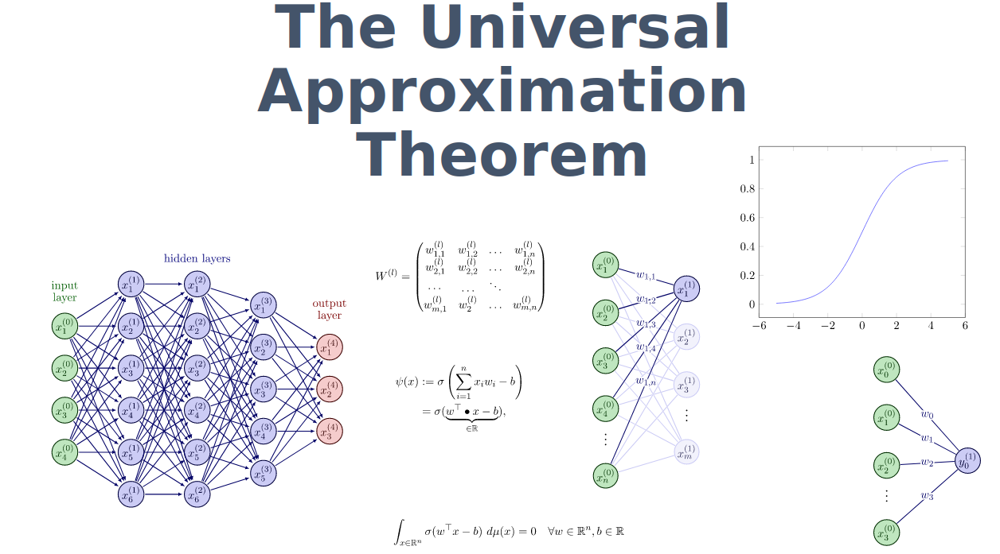

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'universal_approx_theorem.png'))

In [ ]:
break

SyntaxError: 'break' outside loop (<ipython-input-1-6aaf1f276005>, line 1)

## A Prior on the Number of Hidden Layers
<br>
<font size="+1">
  <ul>
    <li>For many problems, you might want to start with a single hidden layer, and it is possible you will get reasonable results.</li>
    <br>
    <ul>
      <li><a href="https://en.wikipedia.org/wiki/Universal_approximation_theorem">The Universal Approximation Theorem (1989)</a> tells us that a dense neural network with just a single hidden layer can theoretically model even the most complex functions, given it has enough neurons.</li>
      <br>
      <li>See <a href="https://www.deep-mind.org/2023/03/26/the-universal-approximation-theorem/">here</a> for more on the Universal Approximation Theorem.</li>
      <br>
    </ul>
    <li>For complex problems, however, deep networks have a much higher <i>parameter efficiency</i> than shallow networks; i.e. they can model complex functions using exponentially fewer neurons than shallow nets, which allows the deep networks to reach much better performance with the same amount of training data.</li>
    <br>
    <ul>
      <li>Why?</li>
      <br>
      <li>Real-world data is often structured in a hierarchical way, and deep neural networks tend to take advantage of this fact:</li>
      <br>
      <ul>
        <li>lower hidden layers model low-level structures (e.g., line segments of various shapes and orientations),</li>
        <br>
        <li>intermediate hidden layers combine these low-level structures to model intermediate-level structures (e.g., squares, circles),</li>
        <br>
        <li>and the highest hidden layers and the output layer combine these intermediate structures to model high-level structures (e.g., faces).</li>
        <br>
      </ul>
    </ul>
    <li>Not only does this hierarchical architecture help dense networks converge faster to a good solution, but it also improves the ability to generalize to new datasets.</li>
    <br>
    <ul>
      <li>As an example, consider a model that has already been trained on a model to recognize faces in pictures, and you now want to train a new network to recognize hairstyles.</li>
      <br>
      <li>You can enhance this training by reusing the lower layers of the first network that was trained to recognize faces.</li>
      <br>
      <li>Instead of randomly initializing the weights and biases of the first few layers of the new network, you can initialize them to the values of the weights and biases of the lower layers of the first network.</li>
      <br>
      <li>This allows for new network to not have to learn from scratch all the low-level structures that occur in most pictures; it will only have to learn the higher-level structures, such as hairstyles.</li>
      <br>
      <li><b>This is called transfer learning.</b></li>
      <br>
    </ul>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <li>But what does deep mean for dense neural networks?</li>
    <br>
    <ul>
      <li>For more complex problems, you can ramp up the number of hidden layers until you start overfitting the training set.</li>
      <br>
      <li>Very complex tasks, such as large image classification or speech recognition, typically require networks with dozens of layers (or even hundreds, but not fully connected ones, as we will see), and they need a huge amount of training data.</li>
      <br>
      <li>We will rarely have to train such networks from scratch: it is much more common to reuse parts of a pretrained state-of-the-art network that performs a similar task.</li>
      <br>
      <li>Training will then be a lot faster and require much less data.</li>
      <br>
    </ul>
    $\rule{800pt}{10pt}$
    <br>
    <br>
  </ul>
</font>
$̇\square$

## A Prior on the Number of Neurons Per Hidden Layer
<br>
<font size="+1">
  <ul>
    <li>Historically, it was common to size the neurons per hidden layer to form a pyramid, with fewer and fewer neurons per layer at each layer.</li>
    <br>
    <ul>
      <li>The logic was that many low-level features can be reduced into far fewer high-level features.</li>
      <br>
    </ul>
    <li>More recently, this practice has been abandoned because it seems that using the same number of neurons in all hidden layers performs just as well, or even better.</li>
    <br>
    <li>This reduces the number of hyperparameters to tune down to one, instead of one per layer.</li>
    <br>
    <ul>
      <li>This, of course, is not a law; depending on the dataset, it can sometimes help to make the first hidden layer bigger than others.</li>
      <br>
    </ul>
    <font color="blue"><li>Just like the number of layers, you can try increasing the number of neurons gradually until the network starts overfitting.</li>
    <br>
    <li>You can also try to build a model with slightly more layers and neurons that you think you need, then use <b>early stopping</b> or <b>other regularization techniques</b> to prevent it from overfitting too much.</li></font>
    <br>
    <li>In general, it is recommended to increase the number of layers instead of the number of neurons per layer.</li>
    <br>
    $\rule{800pt}{10pt}$
    <br>
    <br>
  </ul>
</font>
$̇\square$

## A Prior on the Learning Rate, Batch Size, and Other Hyperparameters
<br>
<font size="+1">
  <ul>
    <li>Learning Rate:</li>
    <br>
    <ul>
      <li>It has been said that the learning rate is <b>the most important hyperparameter</b>.</li>
      <br>
      <li>As a rule of thumb, the optimal learning rate is about half of the maximum learning rate (i.e. the rate above which the training algorithm diverges).</li>
      <br>
      <font color="red"><li>How do you find a good learning rate?</li></font>
      <br>
      <ul>
        <font color="red"><li>One way is to train the model for a few hundred iterations, starting with a very low learning rate (e.g. $10^{-5}$) and gradually increasing it up to a very large value (e.g. $10$).</li>
        <br>
        <li>To <b>increase</b> the learning rate you can multiply it by a constant factor at each iteration (e.g. by $(10/10^{-5})^{1/500}$ to go from $10^{-5}$ to $10$ in $500$ iterations).</li>
        <li>If you plot the loss as a function of the learning rate using a log scale for the learning rate, you <b>should see it dropping at first, but after some time the learning rate will be too large and the loss will shoot back up.</b></li>
        <br>
        <li><b>The optimal learning rate will be slightly lower than the point at which the loss starts to increase.</b></li>
        <br>
        <li>You can then reinitialize your model and train it using this good learning rate.</li>
        <br>
        <li>The optimal learning rate depends on the other hyperparameters, especially the batch size, so if you modify any hyperparameter, make sure to update the learning rate as well.</li></font>
        <br>
      </ul>
    </ul>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <li>Optimizer:</li>
    <br>
    <ul>
      <li>Consider choosing a better optimizer than traditional mini-batch stochastic gradient descent.</li>
      <br>
    </ul>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <li>Batch Size:</li>
    <br>
    <ul>
      <li>The size of your batch can have significant impact on your model's performance and training time.</li>
      <br>
      <li>The main benefit of using large batch sizes is that hardware accelerators like GPUs can process them efficiently, so the training algorithm will see more instances per second.</li>
      <br>
      <li>It is recommended to use the largest batch size that can fit in GPU RAM.</li>
      <br>
      <ul>
        <li>However, in practice large batch sizes often lead to training instabilities, especially at the beginning of training, and the resulting model may not generalize as well as a model trained with a smaller batch size.</li>
        <br>
        <li><b>In April 2018, Yann LeCun tweeted: "Friends don't let friends use mini-batches larger than 32", which cited a <a href="https://arxiv.org/abs/1804.07612">paper</a> which concluded that using small batches (from 2 to 32) was preferable because small batches led to better models in less training time.</b></li>
        <br>
        <li><b>However, other research points in the opposite direction, for example papers like <a href="https://arxiv.org/abs/1705.08741">this one</a> and <a href="https://arxiv.org/abs/1706.02677">this one</a> showed it was possible to use very large batch sizes (up to 8,192) along with various techniques such as warming up the learning (i.e. starting training with a small learning rate, then ramping it up) to get very short training time without any generalization gap.</b></li>
        <br>
        <li><b>One strategy is to try using a large batch size, with learning rate warmup, and if training is unstable or the final performance is poor, then try using a small batch size instead.</b></li>
        <br>
      </ul>
    </ul>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <li>Activation Functions</li>
    <br>
    <ul>
      <li>In general, the ReLU activation function will be a good default for all hidden layers, but for the output layer, it will depend on the target you're trying to predict.</li>
      <br>
    </ul>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <li>Number of Iterations</li>
    <br>
    <ul>
      <li>In most cases, the number of training iterations does not actually need to be tweaked $\implies$ just use early stopping instead.</li>
      <br>
    </ul>
    $\rule{800pt}{10pt}$
    <br>
    <br>
    <li>For more best practices on the tuning of neural network hyperparameters, see <a href="https://arxiv.org/abs/1803.09820">here</a>.</li>
    <br>
    <li>We will get into some of these in the next following notebook.</li>
    <br>
  </ul>
</font>
$̇\square$

$\rule{800pt}{20pt}$

# Other Ways to Use TensorFlow and Keras

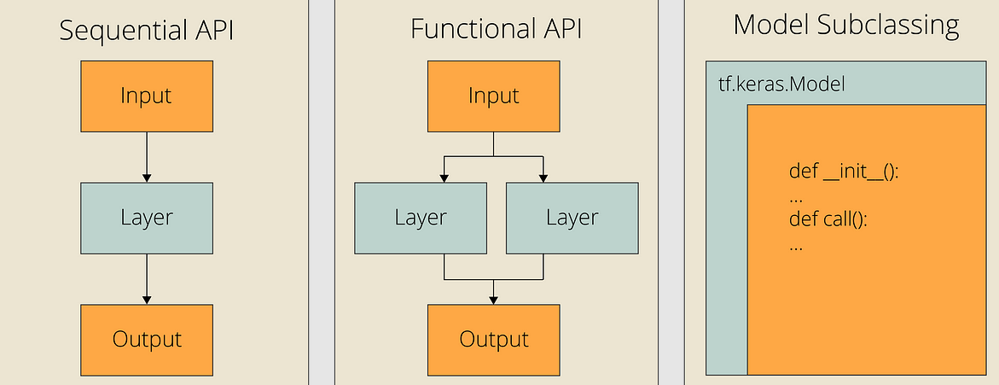

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'three_ways_to_build_keras_models.png'))

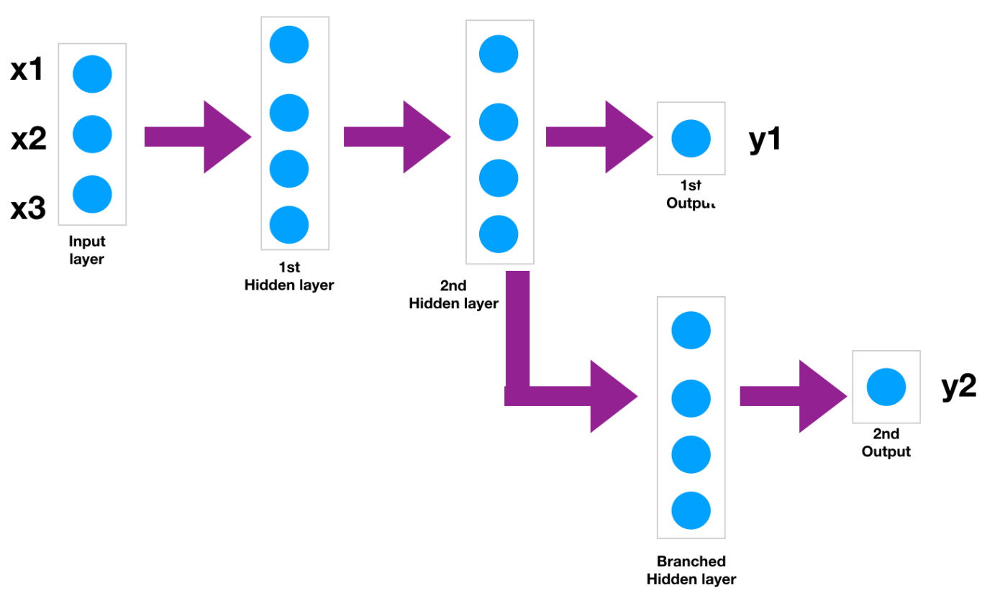

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'functional_API_for_a_branched_model.png'))

## Building Complex Models with the <a href="https://keras.io/guides/functional_api/">Functional API</a>
<br>
<font size="+1">
  <ul>
    <li>An example of a non-sequential neural network is the <a href="https://arxiv.org/pdf/1606.07792.pdf">Wide & Deep</a> network, which was introduced in 2016.</li>
    <br>
    <li>It connects all or part of the inputs directly to the output layer.</li>
    <br>
    <li>The motivation of this architecture is to allow the network to learn both deep patterns (using the deep path) and simple rules (through the short path).</li>
    <br>
    <li>In comparison, a fully-connected dense neural network forces all the data to flow through the full stack of layers $\implies$ simple patterns in the data may end up being distored.</li>
    <br>
    <li><b>The key to using the Functional API is to treat each layer like an individual function with an input and an output.</b></li>
    <br>
  </ul>
</font>
$̇\square$

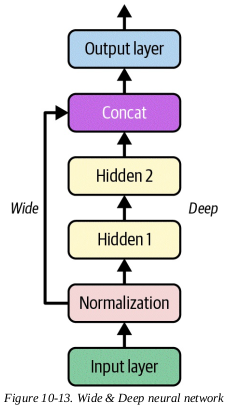

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'functional_API_1.png'))

- First we should create layers that consist of:

  - the input layer
  
    - which is used to specify the kind of input the model will get, including its shape and data type (defaults to 32-bit floats)

    - note that a model may have multiple inputs

  - a normalization layer to standardize the inputs

  - two dense hidden layers to process the features

  - a <a href="https://keras.io/api/layers/merging_layers/concatenate/">concatenation layer</a> that merges the layers

  - and one more dense layer that forms the output layer

- Then we use the layers just like a function, passing the output from the previous layers as input to the subsequent layer.

  - This is why it is called the **Functional API**

  - Note that we are just telling Keras how it should connect the layers together and no actual data is being processed.

- We use the concatenation layer to concatenate the input and the second hidden layer's output.

- Then we pass the concat layer to the output layer.

- The final step is to create a Keras model, which points to the input and output to use.

  - This is particularly useful if you have multiple sets of inputs or multiple sets of outputs.

In [ ]:
# Code to build such a network
tf.keras.utils.set_random_seed(42)

##################################################################################
# First define all the layers individually
input_layer = tf.keras.layers.Input(shape=(X_train.shape[1],))

normalization_layer = tf.keras.layers.Normalization()
hidden_layer_1 = tf.keras.layers.Dense(units=30, activation="relu")
hidden_layer_2 = tf.keras.layers.Dense(units=30, activation="relu")

concatenation_layer = tf.keras.layers.Concatenate()

output_layer = tf.keras.layers.Dense(units=1)

##################################################################################
# Next start plugging the layers into eachother to define the flow of the data
# You can use the layers just like functions to go from input to output
normalized = normalization_layer(input_layer)
hidden_1 = hidden_layer_1(normalized)
hidden_2 = hidden_layer_2(hidden_1)

concat = concatenation_layer([normalized, hidden_2])
output = output_layer(concat)

##################################################################################
# Finally define a Keras Model object specifying where the data processing begins and ends
# The model object points to the input and output

model = tf.keras.Model(inputs=[input_layer], outputs=[output])

In [ ]:
hidden_layer_1

In [ ]:
hidden_1

<KerasTensor: shape=(None, 30) dtype=float32 (created by layer 'dense_11')>

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 15)]                 0         []                            
                                                                                                  
 normalization_1 (Normaliza  (None, 15)                   31        ['input_1[0][0]']             
 tion)                                                                                            
                                                                                                  
 dense_11 (Dense)            (None, 30)                   480       ['normalization_1[0][0]']     
                                                                                                  
 dense_12 (Dense)            (None, 30)                   930       ['dense_11[0][0]']        

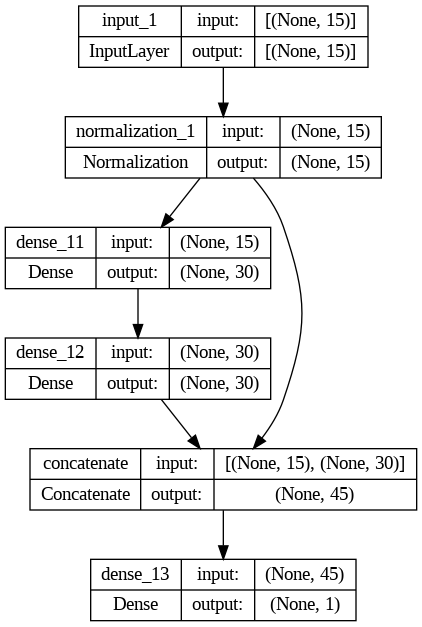

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True, show_layer_names=True) # to_file='model_plot.png'

In [ ]:
model.compile(loss="mse",
              optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
              metrics=[tf.keras.metrics.R2Score()])

In [ ]:
history = model.fit(X_sub_train, Y_sub_train,
                    epochs=150, batch_size=32,
                    validation_data=(X_validation, Y_validation))

history = pd.DataFrame(history.history)

Epoch 1/150
30/30 [==============================] - 1s 11ms/step - loss: 0.0202 - r2_score: -5.3236 - val_loss: 0.0458 - val_r2_score: -22.8723
Epoch 2/150
30/30 [==============================] - 0s 3ms/step - loss: 0.0080 - r2_score: -1.4892 - val_loss: 0.0219 - val_r2_score: -10.3988
Epoch 3/150
30/30 [==============================] - 0s 3ms/step - loss: 0.0041 - r2_score: -0.2674 - val_loss: 0.0093 - val_r2_score: -3.8405
Epoch 4/150
30/30 [==============================] - 0s 3ms/step - loss: 0.0020 - r2_score: 0.3880 - val_loss: 0.0038 - val_r2_score: -0.9948
Epoch 5/150
30/30 [==============================] - 0s 3ms/step - loss: 0.0013 - r2_score: 0.5837 - val_loss: 0.0014 - val_r2_score: 0.2602
Epoch 6/150
30/30 [==============================] - 0s 3ms/step - loss: 0.0012 - r2_score: 0.6203 - val_loss: 0.0013 - val_r2_score: 0.3252
Epoch 7/150
30/30 [==============================] - 0s 3ms/step - loss: 0.0012 - r2_score: 0.6311 - val_loss: 0.0023 - val_r2_score: -0.1914
Ep

<Axes: >

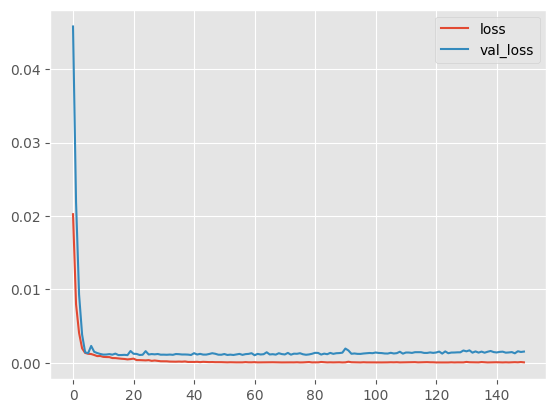

In [ ]:
history[['loss', 'val_loss']].plot()

<Axes: >

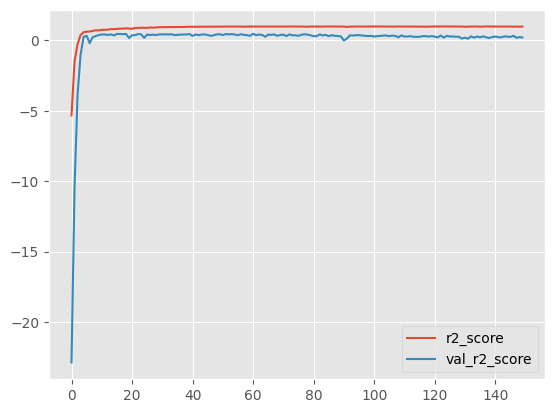

In [ ]:
history[['r2_score', 'val_r2_score']].plot()

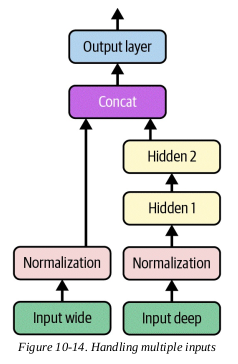

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'functional_API_2.png'))

- What if you want to send a subset of the features through the **wide path** of the network and a different subset (possibly overlapping) throught the **deep path**?

  - One solution is to use multiple inputs.

In [ ]:
tf.keras.utils.set_random_seed(42)

wide_input_layer = tf.keras.layers.Input(shape=(X_train.iloc[:, 0:5].shape[1], ))
deep_input_layer = tf.keras.layers.Input(shape=(X_train.iloc[:, 5:].shape[1], ))

normalize_wide_input = tf.keras.layers.Normalization()
normalize_deep_input = tf.keras.layers.Normalization()

wide_input_normalized = normalize_wide_input(wide_input_layer)
deep_input_normalized = normalize_deep_input(deep_input_layer)

hidden_layer_1 = tf.keras.layers.Dense(units=30, activation="relu")(deep_input_normalized)
hidden_layer_2 = tf.keras.layers.Dense(units=30, activation="relu")(hidden_layer_1)

concat_wide_and_deep_layers = tf.keras.layers.concatenate([wide_input_normalized, hidden_layer_2])

output_layer = tf.keras.layers.Dense(units=1)(concat_wide_and_deep_layers)

model = tf.keras.Model(inputs=[wide_input_layer, deep_input_layer],
                       outputs=[output_layer])

In [ ]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 10)]                 0         []                            
                                                                                                  
 normalization_3 (Normaliza  (None, 10)                   21        ['input_3[0][0]']             
 tion)                                                                                            
                                                                                                  
 input_2 (InputLayer)        [(None, 5)]                  0         []                            
                                                                                                  
 dense_14 (Dense)            (None, 30)                   330       ['normalization_3[0][0]'

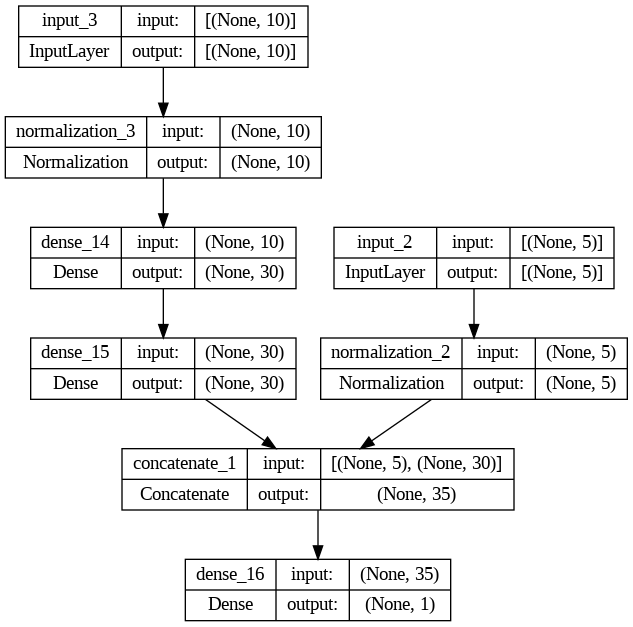

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True, show_layer_names=True) # to_file='model_plot.png'

In [ ]:
model.compile(loss="mse",
              optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
              metrics=[tf.keras.metrics.R2Score()])

In [ ]:
history = model.fit([X_sub_train.iloc[:, 0:5], X_sub_train.iloc[:, 5:]], Y_sub_train,
                    epochs=150, batch_size=32,
                    validation_data=([X_validation.iloc[:, 0:5], X_validation.iloc[:, 5:]], Y_validation))

history = pd.DataFrame(history.history)

Epoch 1/150
30/30 [==============================] - 2s 19ms/step - loss: 0.0980 - r2_score: -29.6206 - val_loss: 0.0306 - val_r2_score: -14.9476
Epoch 2/150
30/30 [==============================] - 0s 7ms/step - loss: 0.0111 - r2_score: -2.4652 - val_loss: 0.0055 - val_r2_score: -1.8549
Epoch 3/150
30/30 [==============================] - 0s 11ms/step - loss: 0.0092 - r2_score: -1.8614 - val_loss: 0.0043 - val_r2_score: -1.2560
Epoch 4/150
30/30 [==============================] - 0s 13ms/step - loss: 0.0086 - r2_score: -1.6909 - val_loss: 0.0082 - val_r2_score: -3.2860
Epoch 5/150
30/30 [==============================] - 0s 14ms/step - loss: 0.0082 - r2_score: -1.5647 - val_loss: 0.0047 - val_r2_score: -1.4531
Epoch 6/150
30/30 [==============================] - 0s 10ms/step - loss: 0.0076 - r2_score: -1.3716 - val_loss: 0.0054 - val_r2_score: -1.8309
Epoch 7/150
30/30 [==============================] - 0s 11ms/step - loss: 0.0072 - r2_score: -1.2370 - val_loss: 0.0035 - val_r2_score:

<Axes: >

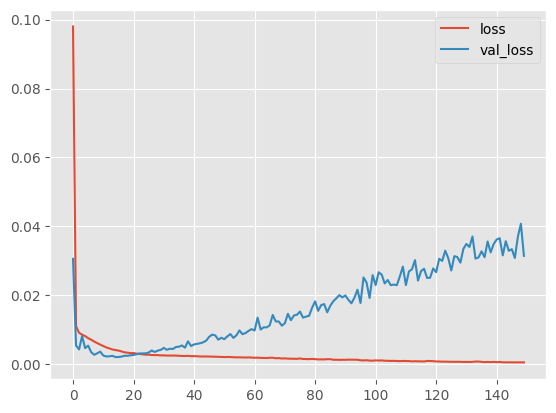

In [ ]:
history[['loss', 'val_loss']].plot()

<Axes: >

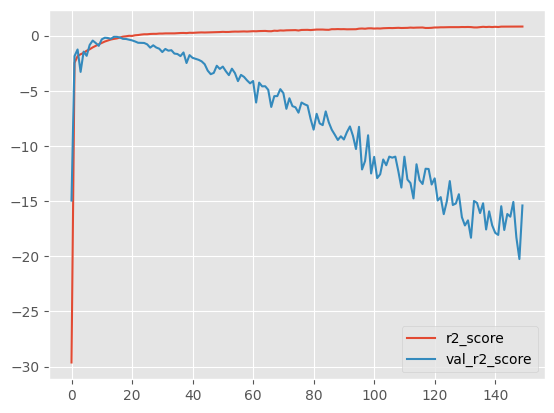

In [ ]:
history[['r2_score', 'val_r2_score']].plot()

- Each dense layer is created and called on the same line.

  - This is common practice with one exception; it does not work on the Normalization layer.

- The concatenation layer gets called with the specified inputs.

- Point to the two inputs when creating the Keras model.

  - Note that when you call fit(), you must also pass two input data matrices; this also applies to the validation data, or when you call evaluate() or predict() on the testing data.



---

- Note:

  - Instead of passing a tuple (X_train_wide, X_train_deep), you can pass a dictionary **{"input_wide": X_train_wide, "input_deep": X_train_deep}**, if you set name="input_wide" and name="input_deep" when creating the inputs.
  
  - This is highly recommended when there are many inputs, to clarify the code and avoid getting the order wrong.


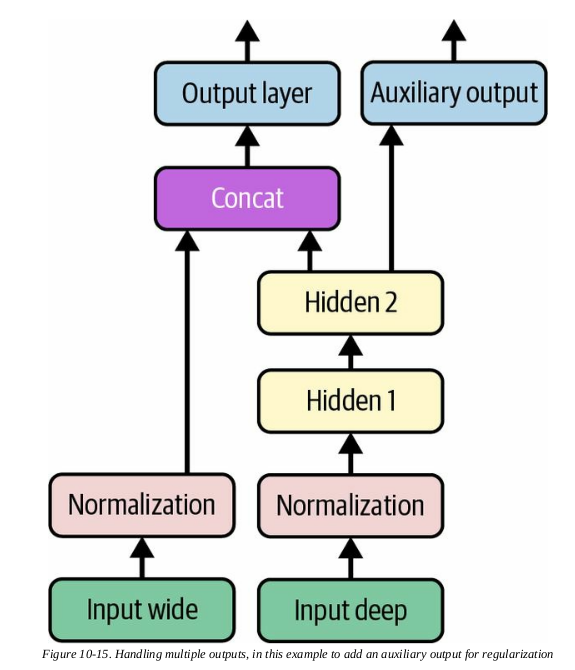

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'functional_API_3.png'))

- You might want to build a model that has multiple outputs.

- Why?

  - It could be mandated by the problem:

    - You might want to locate and classify the main object in a picture:

      - this is both a regression task and a classification task.

    - You might have multiple independent tasks based on the same data:

      - you could train one model per task, but in many cases you can get better results on all tasks by training a single neural network with one output per task (this is a case-by-case solution)

        - this can be because the neural network can learn features in the data that are useful across tasks

        - e.g. consider predicting multiple assets within an asset class or within an industry

        - e.g. consider multi-task classification on pictures, where one output is used to classify the person's facial expression (smiling, surprised, etc.) and another output is used to identify whether they are wearing glasses or not.

    - You might want to implement a **regularization technique (i.e. a training constraint whose objective is to reduce overfitting and improve a model's ability to generalize)**

      - e.g. you might want to add an auxiliary output in a neural network (why?)
      
        - to ensure that the core underlying part of the network (i.e. the deep sequence in the network) learns something useful on its own (i.e. without the help of the wide part of the network)

        - note that **many ad-hoc techniques like this get used in deep learning**



---


- To implement this in code, we just need to connect the appropriate layer and add it to the model's list of outputs.

- Each output will need its own loss function $\implies$ when we compile the model we should pass a list of losses.

  -  If we pass a single loss, Keras will assume that the same loss must be used for all outputs.

  - By default, Keras will compute all the losses individually, and add them together to get the final loss used for training.

- Since we care more about the main output than the auxillary output (which is just used for regularization), we want to give the main output's loss a much greater weight; this can be done in the compile step.



In [ ]:
tf.keras.utils.set_random_seed(42)

wide_input_layer = tf.keras.layers.Input(shape=(X_train.iloc[:, 0:5].shape[1], ))
deep_input_layer = tf.keras.layers.Input(shape=(X_train.iloc[:, 5:].shape[1], ))

normalize_wide_input = tf.keras.layers.Normalization()
normalize_deep_input = tf.keras.layers.Normalization()

wide_input_normalized = normalize_wide_input(wide_input_layer)
deep_input_normalized = normalize_deep_input(deep_input_layer)

hidden_layer_1 = tf.keras.layers.Dense(units=30, activation="relu")(deep_input_normalized)
hidden_layer_2 = tf.keras.layers.Dense(units=30, activation="relu")(hidden_layer_1)

concat_wide_and_deep_layers = tf.keras.layers.concatenate([wide_input_normalized, hidden_layer_2])

output_layer = tf.keras.layers.Dense(units=1, name="main")(concat_wide_and_deep_layers)

#############################################################################################
auxillary_output_layer = tf.keras.layers.Dense(units=1, name="aux")(hidden_layer_2)
#############################################################################################

model = tf.keras.Model(inputs=[wide_input_layer, deep_input_layer],
                       outputs=[output_layer, auxillary_output_layer])

In [ ]:
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 10)]                 0         []                            
                                                                                                  
 normalization_5 (Normaliza  (None, 10)                   21        ['input_5[0][0]']             
 tion)                                                                                            
                                                                                                  
 input_4 (InputLayer)        [(None, 5)]                  0         []                            
                                                                                                  
 dense_17 (Dense)            (None, 30)                   330       ['normalization_5[0][0]'

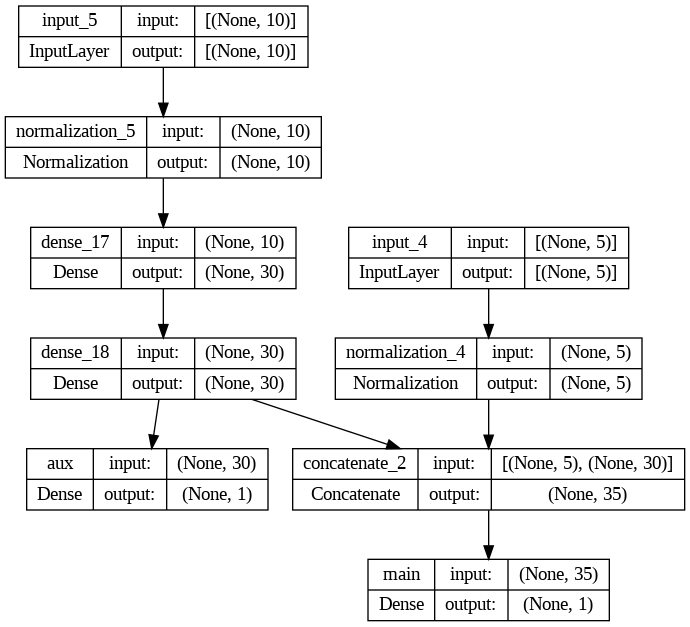

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True, show_layer_names=True) # to_file='model_plot.png'

In [ ]:
model.compile(loss=["mse", "mse"],
              loss_weights=[0.9, 0.1],
              optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              metrics=[tf.keras.metrics.R2Score()])

- Instead of passing a tuple loss ("mse", "mse"), you can pass a dictionary **loss={"output": "mse", "aux_output": "mse"}**, assuming you created the output layers with name="output" and name="aux_output".

- Just like for the inputs, this clarifies the code and avoids errors
when there are several outputs.

- You can also pass a dictionary for loss_weights.

- When you train the model, you need to provide labels for each output.

  - In our example, we want both of our outputs to predict the same thing, so they should have the same labels.

In [ ]:
history = model.fit([X_sub_train.iloc[:, 0:5], X_sub_train.iloc[:, 5:]],
                    [Y_sub_train, Y_sub_train],
                    epochs=150*10, batch_size=32,
                    validation_data=([X_validation.iloc[:, 0:5], X_validation.iloc[:, 5:]],
                                     [Y_validation, Y_validation]))

history = pd.DataFrame(history.history)

Epoch 1/1500
30/30 [==============================] - 2s 16ms/step - loss: 0.3829 - main_loss: 0.4101 - aux_loss: 0.1385 - main_r2_score: -127.1345 - aux_r2_score: -42.2678 - val_loss: 0.3026 - val_main_loss: 0.3139 - val_aux_loss: 0.2010 - val_main_r2_score: -162.5524 - val_aux_r2_score: -103.7289
Epoch 2/1500
30/30 [==============================] - 0s 4ms/step - loss: 0.2125 - main_loss: 0.2228 - aux_loss: 0.1199 - main_r2_score: -68.6120 - aux_r2_score: -36.4737 - val_loss: 0.1555 - val_main_loss: 0.1538 - val_aux_loss: 0.1705 - val_main_r2_score: -79.1304 - val_aux_r2_score: -87.8206
Epoch 3/1500
30/30 [==============================] - 0s 4ms/step - loss: 0.1150 - main_loss: 0.1159 - aux_loss: 0.1069 - main_r2_score: -35.2205 - aux_r2_score: -32.4123 - val_loss: 0.0752 - val_main_loss: 0.0675 - val_aux_loss: 0.1454 - val_main_r2_score: -34.1436 - val_aux_r2_score: -74.7611
Epoch 4/1500
30/30 [==============================] - 0s 4ms/step - loss: 0.0628 - main_loss: 0.0594 - aux_l

In [ ]:
history.head()

,loss,main_loss,aux_loss,main_r2_score,aux_r2_score,val_loss,val_main_loss,val_aux_loss,val_main_r2_score,val_aux_r2_score
0,0.382914,0.410074,0.138472,-127.134476,-42.267818,0.302619,0.313910,0.201008,-162.552399,-103.728905
1,0.212497,0.222782,0.119929,-68.611984,-36.473740,0.155464,0.153796,0.170475,-79.130363,-87.820557
2,0.115019,0.115918,0.106931,-35.220524,-32.412270,0.075248,0.067452,0.145410,-34.143585,-74.761108
3,0.062779,0.059364,0.093518,-17.549225,-28.221142,0.036591,0.026916,0.123658,-13.023937,-63.427818
4,0.037076,0.032228,0.080704,-9.070177,-24.217409,0.019344,0.009965,0.103751,-4.192009,-53.056271


<Axes: >

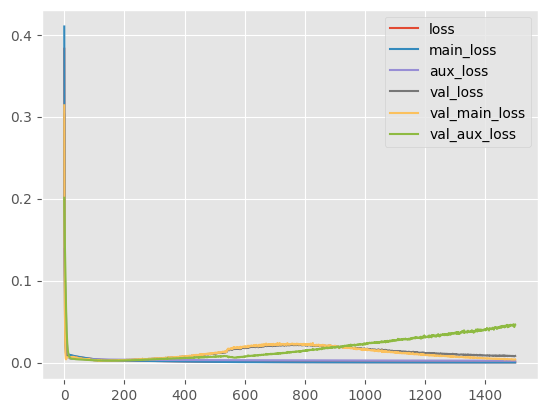

In [ ]:
history[['loss', 'main_loss', 'aux_loss',
         'val_loss', 'val_main_loss', 'val_aux_loss']].plot()

<Axes: >

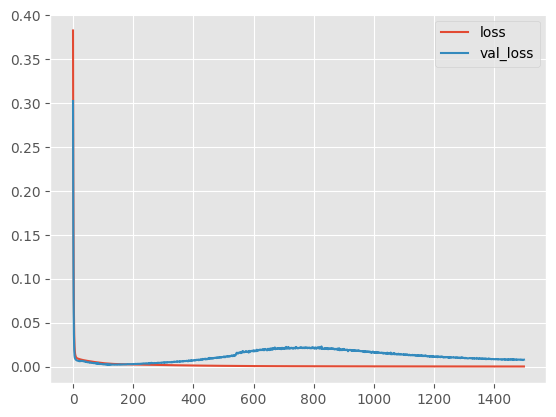

In [ ]:
history[['loss','val_loss']].plot()

<Axes: >

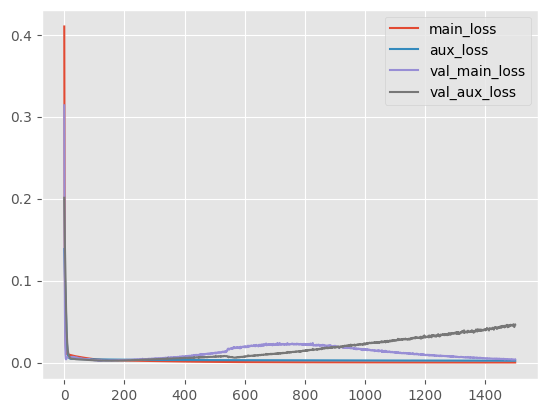

In [ ]:
history[['main_loss', 'aux_loss',
         'val_main_loss', 'val_aux_loss']].plot()

<Axes: >

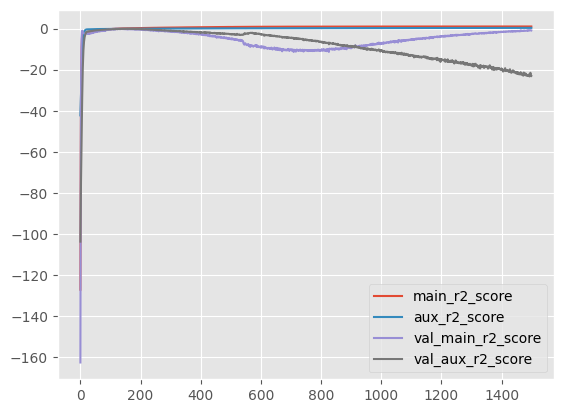

In [ ]:
history[['main_r2_score', 'aux_r2_score',
         'val_main_r2_score', 'val_aux_r2_score']].plot()

- When we evaluate the model, Keras returns the weighted sum of the losses, as well as the individual losses and metrics.

In [ ]:
validation_results = model.evaluate([X_validation.iloc[:, 0:5], X_validation.iloc[:, 5:]],
                                    [Y_validation, Y_validation],
                                    return_dict=True)

4/4 [==============================] - 0s 5ms/step - loss: 0.0080 - main_loss: 0.0037 - aux_loss: 0.0462 - main_r2_score: -0.9453 - aux_r2_score: -23.0833      


In [ ]:
validation_results

{'loss': 0.007982597686350346,
 'main_loss': 0.003733597230166197,
 'aux_loss': 0.04622359946370125,
 'main_r2_score': -0.9452699422836304,
 'aux_r2_score': -23.083309173583984}

In [ ]:
print(validation_results['loss'])

print(0.9*validation_results['main_loss'] + 0.1*validation_results['aux_loss'])

0.007982597686350346
0.007982597453519702


In [ ]:
# main_Y_hat = model.predict([X_validation.iloc[:, 0:5], X_validation.iloc[:, 5:]])[0]

# pd.DataFrame({'mainYhat':np.squeeze(main_Y_hat), 'Yvalid':np.squeeze(Y_validation.values)}).plot(kind='scatter', x='mainYhat', y='Yvalid')
# plt.show()

# aux_Y_hat = model.predict([X_validation.iloc[:, 0:5], X_validation.iloc[:, 5:]])[1]

# pd.DataFrame({'auxYhat':np.squeeze(aux_Y_hat), 'Yvalid':np.squeeze(Y_validation.values)}).plot(kind='scatter', x='auxYhat', y='Yvalid')
# plt.show()

$\rule{800pt}{20pt}$

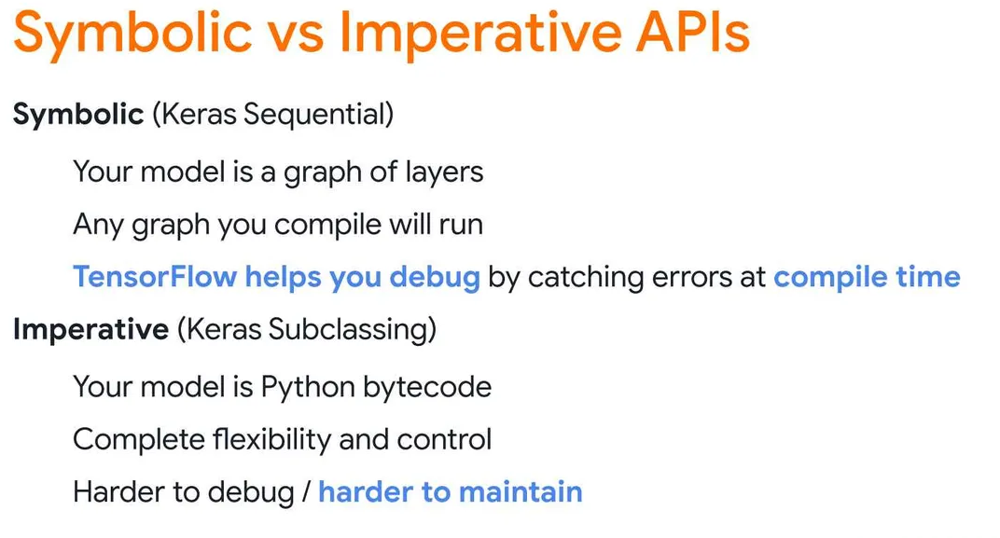

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'keras_symbolic_imperative_APIs.png'))

## <h2>Building Dynamic Models with the <a href="https://keras.io/guides/making_new_layers_and_models_via_subclassing/">Subclassing API</a></h2>
<br>
<font size="+1">
  <ul>
    <li>As you can see, you can build so many architectures with the functional API.</li>
    <br>
    <li>There is one last way to build Keras models, which is by using the Subclassing API.</li>
    <br>
    <li>Both the sequential and the functional API are <b>declarative</b>: this means you start by specifying (declaring) which layers you want to use and how they should be connected, only then can you start feeding the model data for training or inference.</li>
    <br>
    <li>This is useful because the model can be easily saved, cloned, and shared; its structure can be displayed and analyzed; the framework can infer shapes and check types so errors can be caught before any data goes through the model.</li>
    <br>
    <li>It is also easier to debug since the whole model is just a static graph of layers.</li>
    <br>
    <li>Unfortunately, the fact that it is static is a problem the more custom you want to get.</li>
    <br>
    <ul>
      <li>Some models involve loops, have varying shapes, have conditional branching, and other dynamic behaviors.</li>
      <br>
      <li>In these cases, the subclassing API is the right choice.</li>
      <br>
    </ul>
    <li>This approach subclasses the Model class, and creates the layers you need in the <b>constructor</b>, and use them to perform the computations you want in the <b>call()</b> method.</li>
    <br>
  </ul>
</font>
$̇\square$

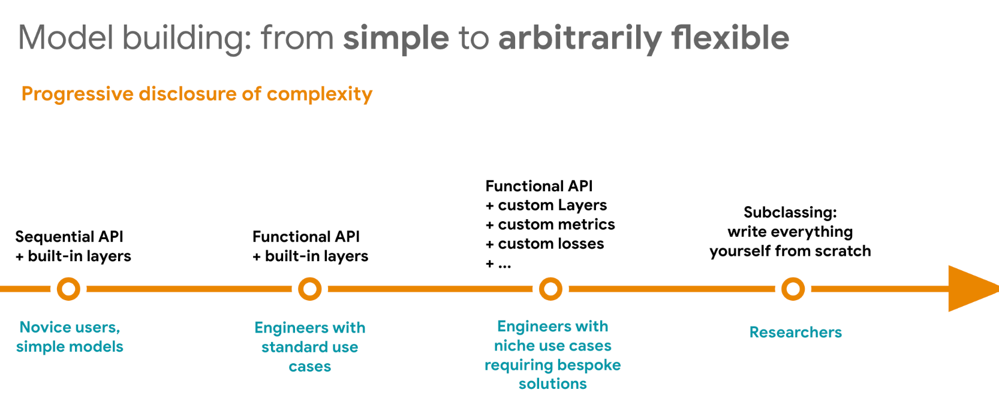

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'simple_to_flexible_keras_APIs.png'))

In [ ]:
# Step 1: define the class by subclassing the Keras Model class
# Step 2: define the required methods, which are __init__() and call()

class WideAndDeepModel(tf.keras.Model):
  def __init__(self):
    None

  def call(self):
    None

In [ ]:
# Step 3: create the layers you need in the constructor, i.e. the __init__() method

class WideAndDeepModel(tf.keras.Model):
  def __init__(self, units=30, activation="relu", **kwargs):
    super().__init__(**kwargs) # required to support the model naming functionality

    self.wide_normalization_layer = tf.keras.layers.Normaliation()
    self.deep_normalization_layer = tf.keras.layers.Normalization()

    self.hidden_layer_1 = tf.keras.layers.Dense(units=units, activation=activation)
    self.hidden_layer_2 = tf.keras.layers.Dense(units=units, activation=activation)

    self.main_output_layer = tf.keras.layers.Dense(units=1)
    self.auxillary_output_layer = tf.keras.layers.Dense(units=1)

  def call(self):
    None

In [ ]:
# Step 4: use the previously defined layers to perform the computation of the network

class WideAndDeepModel(tf.keras.Model):
  def __init__(self, units=30, activation="relu", **kwargs):
    super().__init__(**kwargs) # required to support the model naming functionality
    ## Define the layers
    self.wide_normalization_layer = tf.keras.layers.Normalization()
    self.deep_normalization_layer = tf.keras.layers.Normalization()

    self.hidden_layer_1 = tf.keras.layers.Dense(units=units, activation=activation)
    self.hidden_layer_2 = tf.keras.layers.Dense(units=units, activation=activation)

    self.main_output_layer = tf.keras.layers.Dense(units=1)
    self.auxillary_output_layer = tf.keras.layers.Dense(units=1)

  def call(self, inputs):
    ## Define what to do with the layers when the class is called
    wide_input, deep_input = inputs

    wide_input_normalized = self.wide_normalization_layer(wide_input)
    deep_input_normalized = self.deep_normalization_layer(deep_input)

    hidden_1 = self.hidden_layer_1(deep_input_normalized)
    hidden_2 = self.hidden_layer_2(hidden_1)

    concatenation_layer = tf.keras.layers.concatenate([wide_input_normalized, hidden_2])

    output_layer = self.main_output_layer(concatenation_layer)
    aux_output_layer = self.auxillary_output_layer(hidden_2)

    return output_layer, aux_output_layer

In [ ]:
model = WideAndDeepModel(units=30, activation="relu", name="model_via_subclassing")

- If you take away the class structure, the above code appears very similar to the functional API that we previously used.

- The main difference is that we separate the creation of the layers in the constructor from where the layers are used in the call method; we also don't need to use the Input layer objects.

- Now that we have a model instance, we can compile it, fit it, evaluate it, and use it to make predictions, just like the Sequential and Functional API.

In [ ]:
model.compile(loss=["mse", "mse"],
              loss_weights=[0.9, 0.1],
              optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              metrics=[tf.keras.metrics.R2Score()])

In [ ]:
history = model.fit([X_sub_train.iloc[:, 0:5], X_sub_train.iloc[:, 5:]],
                    [Y_sub_train, Y_sub_train],
                    epochs=150*10, batch_size=32,
                    validation_data=([X_validation.iloc[:, 0:5], X_validation.iloc[:, 5:]],
                                     [Y_validation, Y_validation]))

history = pd.DataFrame(history.history)

Epoch 1/1500
30/30 [==============================] - 2s 15ms/step - loss: 0.0481 - output_1_loss: 0.0524 - output_2_loss: 0.0101 - output_1_r2_score: -15.3666 - output_2_r2_score: -2.1474 - val_loss: 0.0694 - val_output_1_loss: 0.0766 - val_output_2_loss: 0.0050 - val_output_1_r2_score: -38.8890 - val_output_2_r2_score: -1.6214
Epoch 2/1500
30/30 [==============================] - 0s 4ms/step - loss: 0.0105 - output_1_loss: 0.0111 - output_2_loss: 0.0048 - output_1_r2_score: -2.4797 - output_2_r2_score: -0.5121 - val_loss: 0.0460 - val_output_1_loss: 0.0505 - val_output_2_loss: 0.0054 - val_output_1_r2_score: -25.2943 - val_output_2_r2_score: -1.8136
Epoch 3/1500
30/30 [==============================] - 0s 4ms/step - loss: 0.0091 - output_1_loss: 0.0096 - output_2_loss: 0.0046 - output_1_r2_score: -1.9858 - output_2_r2_score: -0.4343 - val_loss: 0.0445 - val_output_1_loss: 0.0489 - val_output_2_loss: 0.0053 - val_output_1_r2_score: -24.4559 - val_output_2_r2_score: -1.7729
Epoch 4/150

In [ ]:
history.head()

,loss,output_1_loss,output_2_loss,output_1_r2_score,output_2_r2_score,val_loss,val_output_1_loss,val_output_2_loss,val_output_1_r2_score,val_output_2_r2_score
0,0.048148,0.052379,0.010073,-15.366627,-2.147444,0.069407,0.076560,0.005031,-38.888954,-1.621375
1,0.010506,0.011136,0.004839,-2.479671,-0.512130,0.045961,0.050467,0.005400,-25.294308,-1.813565
2,0.009059,0.009555,0.004590,-1.985759,-0.434337,0.044504,0.048858,0.005322,-24.455885,-1.772914
3,0.008513,0.008971,0.004393,-1.803087,-0.372568,0.041938,0.046015,0.005248,-22.974566,-1.734501
4,0.008022,0.008429,0.004362,-1.633721,-0.362934,0.039599,0.043429,0.005130,-21.627161,-1.672828


<Axes: >

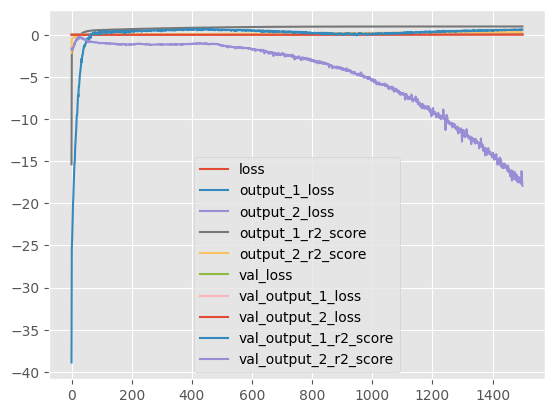

In [ ]:
history.plot()

<Axes: >

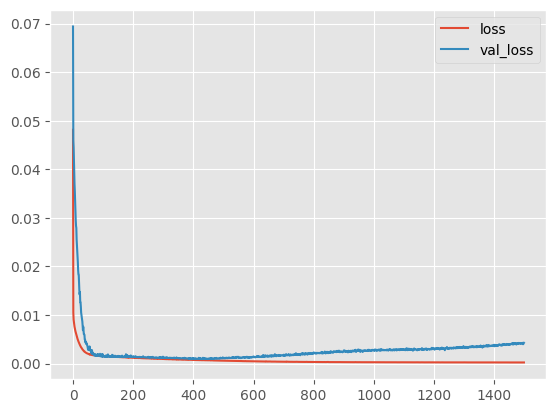

In [ ]:
history[['loss','val_loss']].plot()

<Axes: >

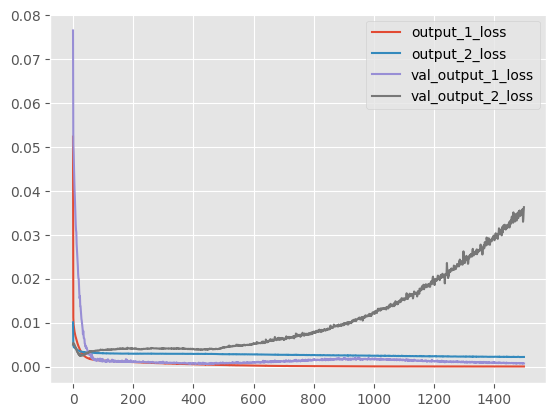

In [ ]:
history[['output_1_loss', 'output_2_loss',
         'val_output_1_loss', 'val_output_2_loss']].plot()

<Axes: >

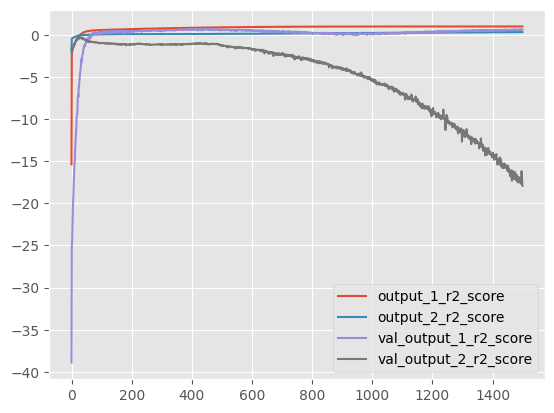

In [ ]:
history[['output_1_r2_score', 'output_2_r2_score',
         'val_output_1_r2_score', 'val_output_2_r2_score']].plot()

In [ ]:
validation_results = model.evaluate([X_validation.iloc[:, 0:5], X_validation.iloc[:, 5:]],
                                    [Y_validation, Y_validation],
                                    return_dict=True)

4/4 [==============================] - 0s 6ms/step - loss: 0.0043 - output_1_loss: 7.2716e-04 - output_2_loss: 0.0363 - output_1_r2_score: 0.6211 - output_2_r2_score: -17.9175


In [ ]:
validation_results

{'loss': 0.00428531551733613,
 'output_1_loss': 0.0007271628128364682,
 'output_2_loss': 0.036308687180280685,
 'output_1_r2_score': 0.6211353540420532,
 'output_2_r2_score': -17.91746711730957}

- The big difference with this API is that anything can be included in the **call()** method.

- This API is great for experimenting with new ideas.

- However, this flexibility does come at a cost.

  - Your model's architecture is hidden within the **call()** method, so Keras cannot easily inspect it, so **summary()** loses some of its functionality and Keras cannot check types and shapes ahead of time $\implies$ it is easier to make mistakes.

$\rule{800pt}{20pt}$

## Using <a href="https://keras.io/api/callbacks/">Callbacks</a>
<br>
<font size="+1">
  <ul>
    <li>The fit method accepts a <b>callbacks</b> argument that lets you specify a list of objects that Keras will call</li>
    <br>
    <ul>
      <li>before and after training,</li>
      <br>
      <li>before and after each epoch,</li>
      <br>
      <li>and even before and after processing each batch.</li>
      <br>
    </ul>
    <li>You can use callbacks to:</li>
    <br>
    <ul>
      <li>write TensorBoard logs after every batch of training to monitor your metrics,</li>
      <br>
      <li>periodically save your model to disk,</li>
      <br>
      <li>do early stopping,</li>
      <br>
      <li><b>get a view on internal states and statistics of a model during training</b></li>
      <br>
    </ul>
    <li>If you need extra control, you can easily write your own custom callbacks by subclassing the Callbacks class.</li>
    <br>
    <li>For example, the following custom callback will display the ratio between the validation loss and the training loss during training (e.g., to detect overfitting):</li>
    <br>
  </ul>
</font>
$̇\square$

In [ ]:
class PrintValTrainRatioCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs):
    ratio = logs["val_loss"] / logs["loss"]
    print(f"Epoch={epoch}, val/train={ratio:.2f}")

- As you might expect, you can implement the methods:

  - **on_train_begin()**

  - **on_train_end()**

  - **on_epoch_begin()**

  - **on_epoch_end()**

  - **on_batch_begin()**

  - **on_batch_end()**

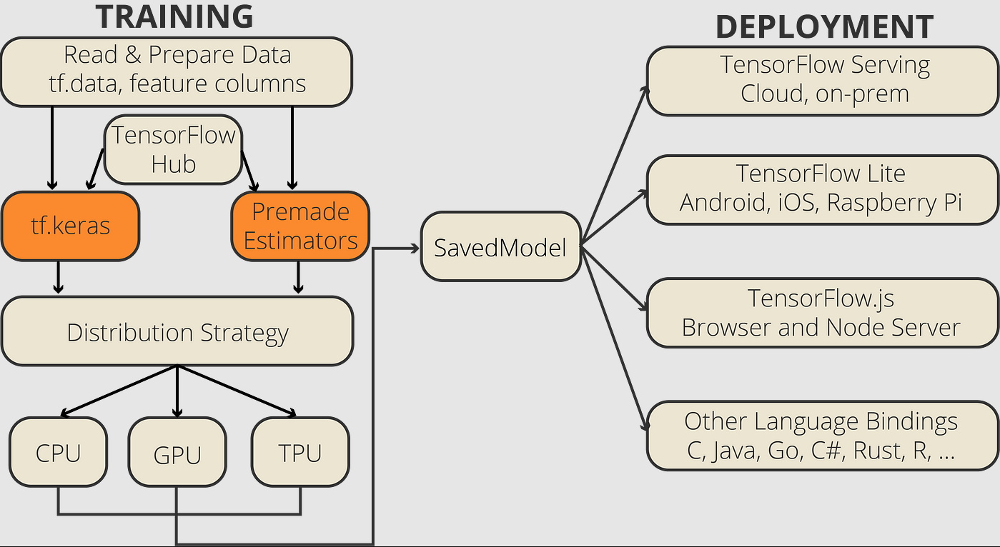

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'training_and_deployment_in_TF.png'))

$\rule{800pt}{20pt}$

$\rule{800pt}{20pt}$

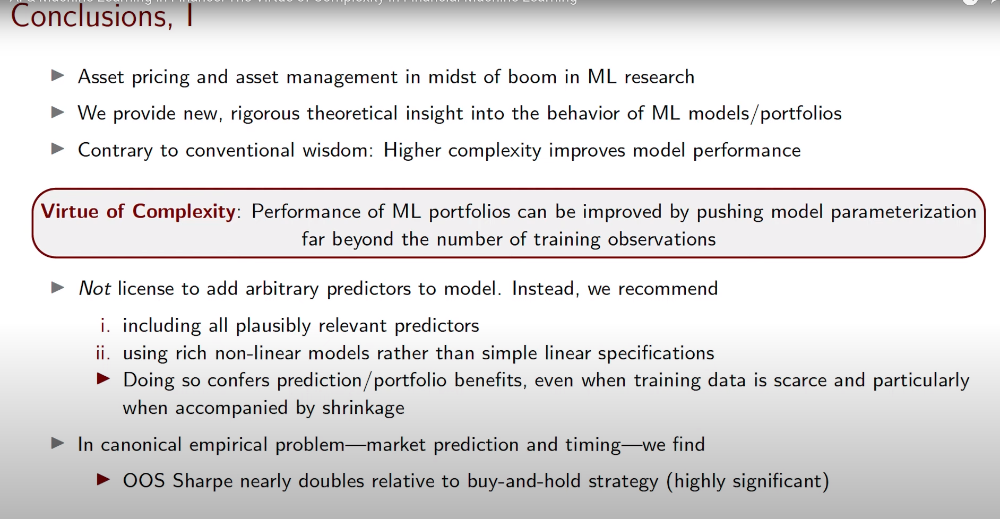

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_conclusion_I.png'))

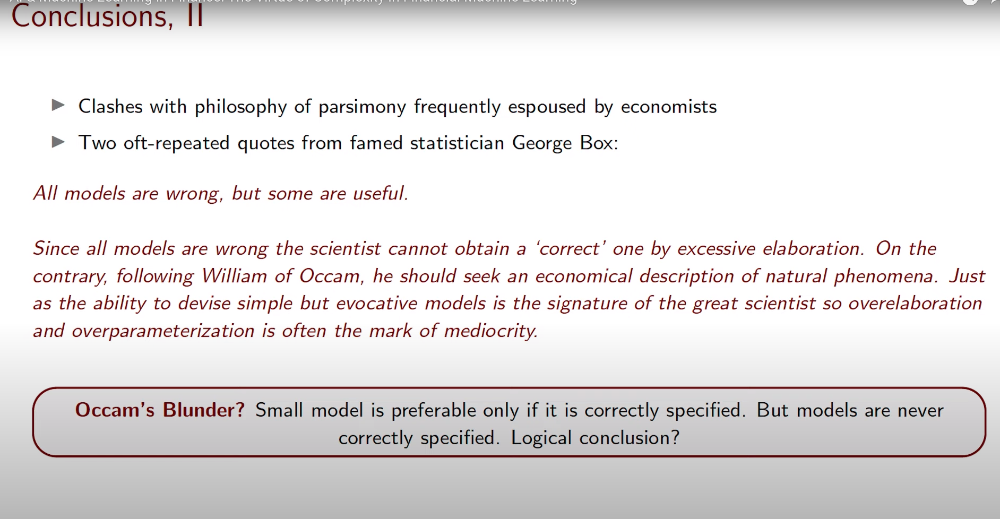

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'benign_overfitting_in_return_prediction_conclusion_II.png'))

# What Have We Covered?
<br>
<font size="+1">
  <ol>
    <li>Predicting financial return time-series for asset management and risk management industries.</li>
    <br>
    <li>Bias-Variance Tradeoffs and Double Descent, as well as the Virtue of Complexity in Return Prediction</li>
    <br>
    <li>Implementing a dense neural network (i.e. multi-layer perceptron) using the Keras API.</li>
    <br>
    <li>How backpropagation computes the gradient used to train the network.</li>
    <br>
    <li>How to build models with the Sequential API, as well as how to tweak and tune hyperparameters with KerasTuner.</li>
    <br>
    <font color="red"><li><b>These are the core implementation details for using TensorFlow and Keras to build neural networks for prediction.</b></li></font>
  <br>
  </ol>
</font>

$\rule{800pt}{20pt}$

$\rule{800pt}{20pt}$

# Miscellaneous: NOT NECESSARY TO KNOW
<br>
<font size="+1">
  <ul>
    <li>For more on the multi-layer perceptron and history of the backpropagation algorithm, see <a href="https://pabloinsente.github.io/the-multilayer-perceptron">the notes by Pablo Caceres</a>.</li>
    <br>
    <li>For more on benign overfitting, double descent, and the virtue of complexity, see the following references:</li>
    <br>
    <ul>
      <li><a href="https://openreview.net/forum?id=NmUWaaFEDdn">On the Double Descent of Random Features Models Trained with SGD (NeurIPS, 2022)</a></li>
      <br>
      <li><a href="https://par.nsf.gov/servlets/purl/10294897">Fit without fear: remarkable mathematical phenomena of deep learning through the prism of interpolation (Mikhail Belkin, 2021)</a></li>
      <br>
      <li><a href="https://web.stanford.edu/~montanar/RESEARCH/FILEPAP/gen_rf.pdf">The generalization error of random features regression: Precise asymptotics and double descent curve (2019)</a></li>
      <br>
      <li><a href="https://arxiv.org/pdf/2106.03212.pdf">Towards an Understanding of Benign Overfitting in Neural Networks (2021)</a></li>
      <br>
      <li><a href="https://arxiv.org/pdf/2305.19377.pdf">Benign Overfitting in Deep Neural Networks under Lazy Training (ICML, 2023)</a></li>
      <br>
      <li><a href="https://proceedings.mlr.press/v178/frei22a/frei22a.pdf">Benign Overfitting without Linearity: Neural Network Classifiers Trained by Gradient Descent for Noisy Linear Data (JMLR, 2022)</a></li>
      <br>
      <li><a href="https://www.jmlr.org/papers/volume24/22-1065/22-1065.pdf">Deep Linear Networks can Benignly Overfit when Shallow Ones Do (JMLR, 2023)</a></li>
      <br>
    </ul>
    <li><table>
  <tr>
    <th>TensorFlow's API Module</th>
    <th>Function</th>
  </tr>
  <tr>
    <td>tf.keras</td>
    <td>high-level deep learning API</td>
  </tr>
  <tr>
    <td>tf.nn</td>
    <td>low-level deep learning API</td>
    <td></td>
  </tr>
  <tr>
    <td>tf.GradientTape</td>
    <td>autodifferentiation API</td>
  </tr>
  <tr>
    <td>tf.math | tf.linalg | tf.signal | tf.random | tf.bitwise</td>
    <td>applied mathematics API</td>
  </tr>
  <tr>
    <td>tf.audio | tf.data | tf.image | tf.io | tf.queue</td>
    <td>data I/O and preprocessing API</td>
  </tr>
  <tr>
    <td>tf.summary</td>
    <td>visualization with TensorBoard API</td>
  </tr>
  <tr>
    <td>tf.distribute | tf.saved_model | tf.autograph | tf.graph_util | tf.lite | tf.quantization | tf.tpu | tf.xla </td>
    <td>deployment and optimization API</td>
  </tr>
  <tr>
    <td>tf.lookup | tf.nest | tf.ragged | tf.sets | tf.sparse | tf.strings </td>
    <td>special data structures API</td>
  </tr>
  <tr>
    <td>tf.experimental | tf.config | tf...</td>
    <td>miscellaneous API</td>
  </tr>
</table></li>
<br>
  </ul>
</font>

$\square$

## <h2>Saving and Restoring a Model</h2>
<br>
<font size="+1">
  <ul>
    <li></li>
    <br>
  </ul>
</font>
$̇\square$

## <h2>Using TensorBoard for Visualization</h2>
<br>
<font size="+1">
  <ul>
    <li><a href="https://tensorboard.dev/">TensorBoard Dev has shut down</a></li>
    <br>
    <li><a href="https://www.tensorflow.org/tensorboard/tensorboard_in_notebooks">Using TensorBoard in notebooks.</a></li>
    <br>
  </ul>
</font>
$̇\square$

## A History of Learning and AI from Geoffrey Hinton

Historically, there was two schools of thought on AI:

- one based it's theories on logic and reasoning

- the other based it's theories on the idea that connections between neurons change, and that's how you learn (which was rooted in biology and neuroscience)




https://m.youtube.com/watch?v=qpoRO378qRY

In [ ]:
from IPython.display import HTML

HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/qpoRO378qRY?si=IPDHlaYxd92L5j9w" title="YouTube video player" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture; web-share" allowfullscreen></iframe>')

## Lessons from the History of Deep Learning from Yann LeCun

In [ ]:
from IPython.display import HTML

HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/gG5NCkMerHU?si=vP_KjdiWOrSnzEDI" title="YouTube video player" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture; web-share" allowfullscreen></iframe>')

## What Is Statistical Learning From A Regression Perspective?

<font size="+1">
    <ul>
        <li>How well does a single variable predict a target variable?</li>
        <br>
        <li>In particular, if two variables are somehow related, can we predict one of them with the other using a line?</li>
        <br>
    </ul>
</font>

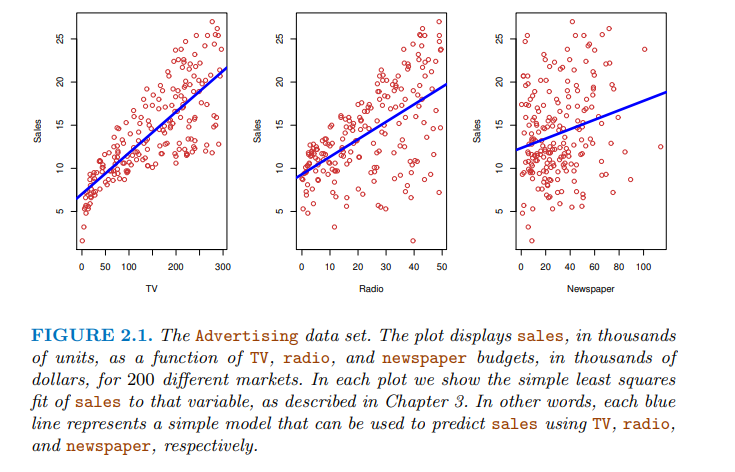

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'relationship_btw_predictors_target.PNG'))

<font size="+1">
    <ul>
        <li>We can extend this simple question of </li>
        <br>
        <ul>
            <li><i>can a single predictor variable predict a target variable</i>?</li>
            <br>
            <li>to <i>can multiple predictor variables predict a target variable</i>?</li>
            <br>
        </ul>
        <li>If so, what is the relationship between the predictors and the target, and how might we model this relationship?</li>
        <br>
    </ul>
</font>

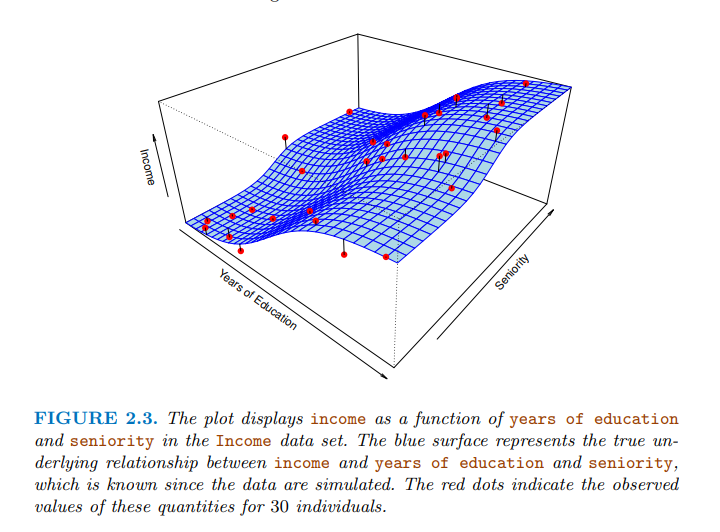

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'true_relationship_btw_predictors_and_target.PNG'))

<br>
<font size="+1">
    <ul>
        <li>Often times when attempting to answer if multiple predictor variables will predict a target variable, the first attempt consists of testing a linear relationship, modeled as a hyperplane.</li>
        <br>
        <li>That is, does a change in the predictor variable result in a <b>proportional</b> change in the target variable?</li>
        <br>
    </ul>
</font>

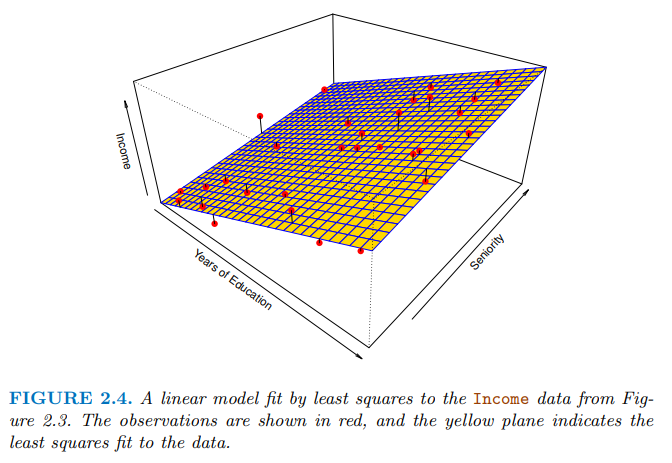

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'linear_approx_of_relationship_btw_predictors_and_target.PNG'))

<br>
<font size="+1">
    <ul>
        <li>One can further attempt to model the relationship between multiple predictor variables and a target variable using very complicated surfaces.</li>
        <br>
        <li>The most complicated surface consists of a curve that perfectly matches every point in the data.</li>
        <br>
        <font color="red"><li style="color:red">These approximation rules are often very hard to interpret and perform very well on the data used for estimation (sometime perfectly in extreme cases), yet do not perform well on unseen data. This phenomenon is known as <b>overfitting</b>!</li></font>
        <br>
    </ul>
</font>

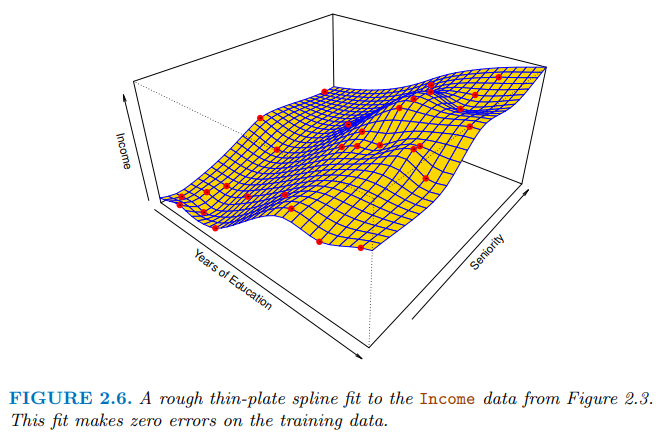

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'too_flexible_approx_of_relationship_btw_predictors_and_target.PNG'))

<br>
<font size="+1">
    <ul>
        <li>A primary goal of building predictive models using machine learning techniques is to find a predicting function which doesn't predict too perfectly (overfit), and also doesn't predict too poorly (underfit).</li>
        <br>
    </ul>
</font>
<br>

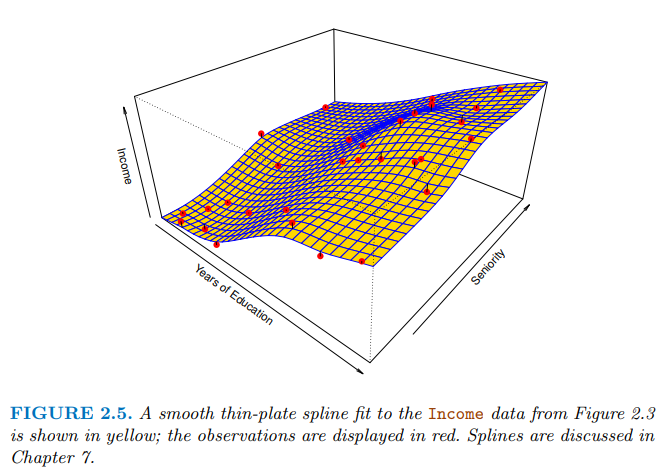

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'flexible_approx_btw_predictors_and_target.PNG'))

<br>
<font size="+1">
    <ul>
        <li>Models that are a little too good at estimating patterns in the data are known as <b>highly flexible</b> models. Less flexible models don't do the best job at making predictions.</li>
        <br>
        <li>It is common that most models that aren't very flexible are <b>highly interpretable</b>, such as linear regressions.</li>
        <br>
        <li>The dream of building predictive models is to find a model that is both <b>highly interpretable</b> and <b>highly flexible</b>, though these efforts are often at odds with one another.</li>
        <br>
    </ul>
</font>

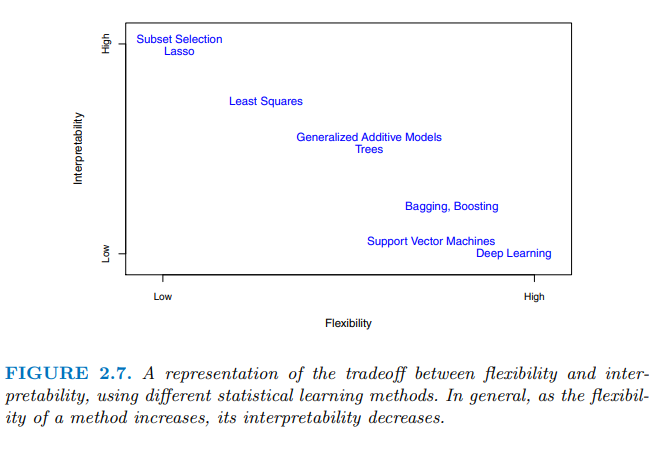

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'model_tradeoff_btw_interpretability_and_accuracy.PNG'))

$\rule{800pt}{20pt}$

## Assessing Model Accuracy in Regression Problems?

<font size="+1">
    <ul>
        <li>When estimating different predictive models, we typically estimate on different data sets known as a <b>training (in-sample)</b> data set and a <b>testing (out-of-sample)</b> data set.</li>
        <br>
        <li>The following is an example of data containing nonlinear signal and moderate noise.</li>
        <br>
    </ul>
</font>

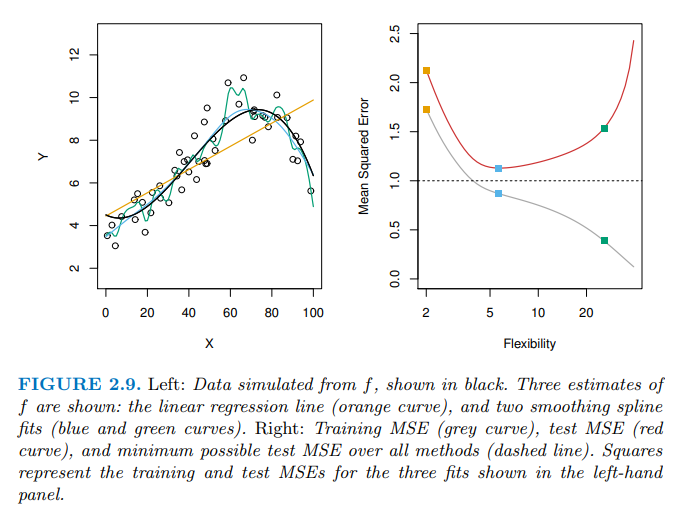

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'error_vs_flexibility_for_semi_nonlinear_data.PNG'))

<br>
<font size="+1">
    <ul>
        <li>Increasing the flexibility of a model typically leads to better error measurements using in-sample training data.</li>
        <br>
        <li>When evaluating a model on out-of-sample test data, increasing the flexibility of a model typically leads to better error measurements initially, but eventually the error worsens as the model flexibility gets too.</li>
        <br>
        <li>This is due to the model fitting the in-sample noise rather than the signal.</li>
        <br>
        <li>The following is an example of data containing linear signal and moderate noise.</li>
        <br>
    </ul>
</font>

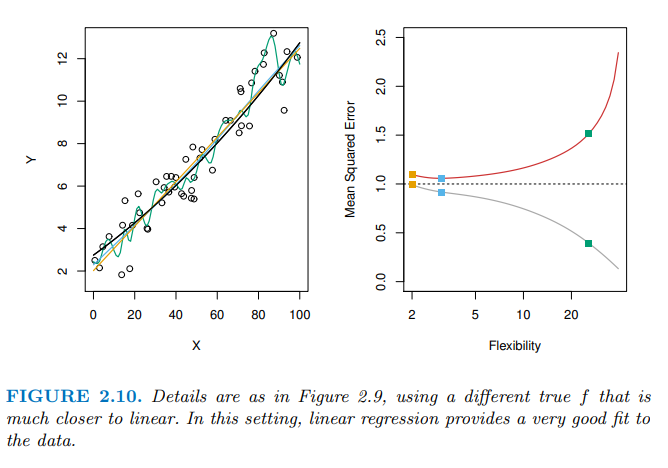

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'error_vs_flexibility_for_linear_data.PNG'))

<br>
<font size="+1">
    <ul>
        <li>We typically wish to find the model which minimizes the error over the out-of-sample testing data set.</li>
        <br>
        <li>The following is an example of data containing nonlinear signal and very small noise.</li>
        <br>
    </ul>
</font>

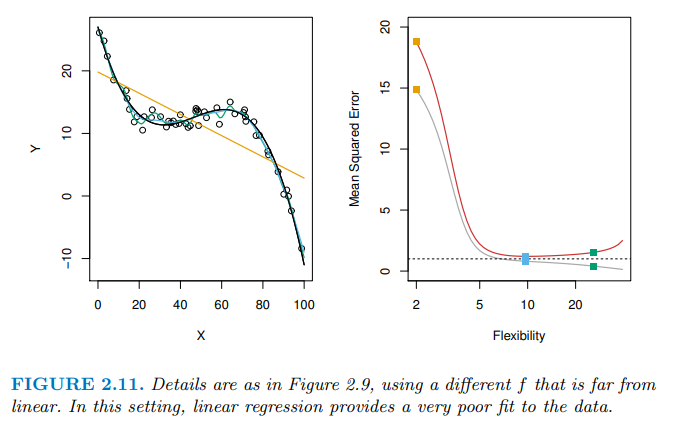

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'error_vs_flexibility_for_highly_nonlinear_data.PNG'))

<br>
<font size="+1">
    <ul>
        <li>This <i>U-shaped</i> curve, also known as convexity, is typically seen in measures of the out-of-sample test error and is caused from a tradeoff between the <b>bias</b> and <b>variance</b> of the model's predictions ($\hat{f}$).</li>
        <br>
        <li>That is, every error measurement can be decomposed into the variance of model's predictions (i.e. the spread of the predictions) and the bias of the model's predictions (i.e. the shift of the predictions).</li>
        <br>
        <li>$$
        \text{average squared error} \approx MSE(\hat{Y}) := \mathbb{E}\left[(\hat{Y}-Y)^2\right] = Var(\hat{Y}) + \left(Bias(\hat{Y})\right)^2
        $$</li>
        <br>
        <li>A dream of building predictive models is to build a model that has <b>low variance</b> and <b>low bias</b>, however, these quantities are at odds with one another and typically as one goes up another goes down.</li>
        <br>
        <li>The relative magnitude of the up and down movements of the bias and variance result in the quality of error a model can hope to achieve out-of-sample on unseen data.</li>
        <br>
    </ul>
</font>

$\square$

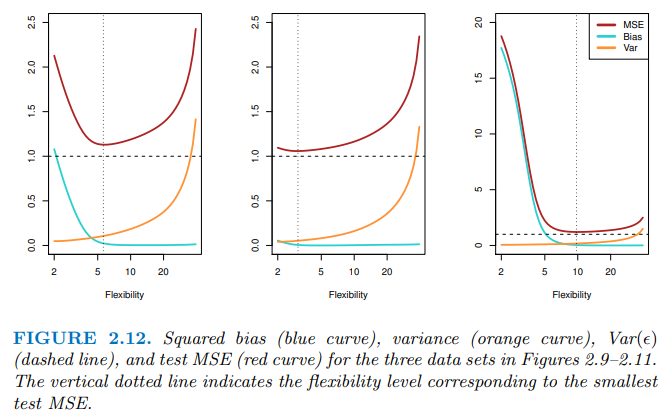

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'total_error_decomposition.PNG'))

### Bias-Variance Tradeoff
<br>
<font size="+1">
    <ul>
        <li>When our estimator is underperforming, how should we move forward?</li>
        <br>
        <ul>
            <li>Should we use a more flexible (complicated) model?</li>
            <br>
            <li>Should we use a less complicated (interpretable/biased) model?</li>
            <br>
            <li>Should we gather more data for estimation, if we can?</li>
            <br>
            <li>Should we gather more data to add predictor variables to every observation?</li>
            <br>
            <br>
        </ul>
        <li> $$
 MSE(\hat{Y}) = Var(\hat{Y}) + (Bias(\hat{Y}))^2
 $$</li>
        <br>
    </ul>
</font>

$\square$

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('ggplot')
import seaborn as sns

#set the random seed for reproducible results
rng = np.random.default_rng(42)

rng

Generator(PCG64) at 0x7EB258AF2F80

In [ ]:
y_true = 4

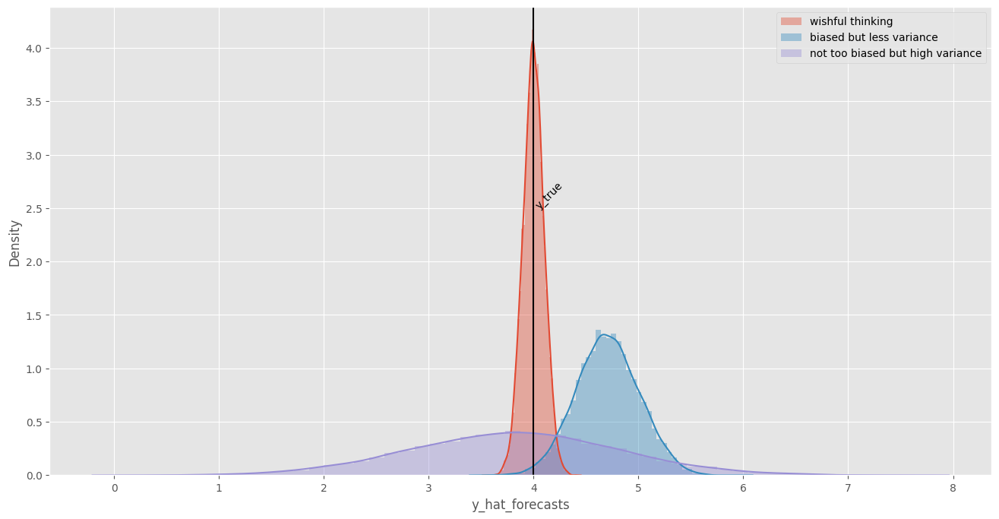

In [ ]:
import warnings
warnings.filterwarnings(action='ignore')

plt.figure(figsize=(16,8))

sns.distplot(rng.normal(loc=y_true, scale=0.1, size=10000),
             kde=True, hist=True, label="wishful thinking")

sns.distplot(rng.normal(loc=4.7, scale=0.3, size=10000),
             kde=True, hist=True, label="biased but less variance")

sns.distplot(rng.normal(loc=3.8, scale=1, size=10000),
             kde=True, hist=True, label="not too biased but high variance")

plt.xlabel('y_hat_forecasts')
plt.axvline(x=y_true, color="black")
plt.text(y_true,2.5,'y_true',rotation=45)
plt.legend()
plt.show()

<font size="+1">
    <ul>
        <li>Which estimator is better?</li>
        <br>
    </ul>
</font>

$\rule{800pt}{20pt}$

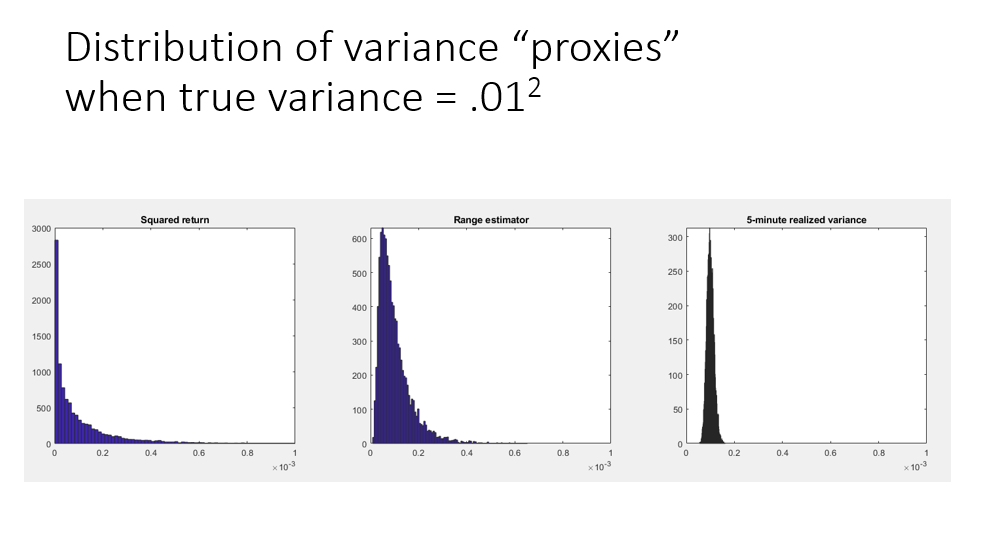

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'Bias_variance_tradeoff_with_vol_estimators.png'))

<font size="+1">
    <ul>
        <li>In finance, which estimator for return volatility is better? </li>
        <br>
    <ul>
        <li>Squared return (higher bias),</li>
        <br>
        <li>Range estimator (higher variance),</li>
        <br>
        <li>5-minute realized variance?</li>
        <br>
    </ul>
        <li>This often depends on how the estimator is being used.</li>
        <br>
    </ul>
</font>

<font size="+1">
    <ul>
    <li>Models that don't have enough flexibility fail to suitably account for all the features in the data, that is, they have high <i>bias</i>. They don't pick up enough <i>signal</i>.</li>
    <br>
    <li>Models that are extremely flexibile can nearly perfectly account for all the features in the data, that is, they have high <i>variance</i>. They tend to pick up the signal and all of the <i>noise</i>. That is, they fail to distinguish between signal and noise.</li>
    <br>
    </ul>
    <br>
    <li>In general:</li>
    <br>
    <ol>
        <li>We expect to see: $ \widehat{\varepsilon}^{IS} < \widehat{\varepsilon}^{OOS} $.</li>
        <br>
        <li>$ \widehat{\varepsilon}^{IS} << \widehat{\varepsilon}^{OOS} \iff $ the estimator is overfitting, i.e. high variance.</li>
        <br>
        <li>$ \widehat{\varepsilon}^{IS} \approx \widehat{\varepsilon}^{OOS} \iff $ the estimator is underfitting, i.e. high bias.</li>
        <br>
        <li>One wants the right balance between the difference of in-sample and out-of-sample error, not too small (high-bias), and not too large (high-variance).</li>
        <br>
    </ol>
    <br>
    <li>What edge cases could cause $ \widehat{\varepsilon}^{IS} > \widehat{\varepsilon}^{OOS} $? Perhaps some sort of extreme bias?</li>
</font>

$\square$

<font size="+1">
    <ul>
        <li>Typically, we would like to tune the model complexity and find the configuration which minimizes the out-of-sample generalization error.</li>
        <br>
        <li>This configuration will typically be between a low and high complexity model. </li>
    <br>
<li>One way of visualizing this is to consider <i>validation curves</i>, which is a particular cross-section of an <i>error suface</i>.</li>
        <br>
    </ul>
</font>

## Is a large number of parameters always a bad thing?
<br>
<font size="+1">
  <ul>
    <li>Double Descent</li>
    <br>
    <li>Benign Overfitting</li>
    <br>
    <ul>
      <li><a href="https://www.pnas.org/doi/epdf/10.1073/pnas.1907378117">Benign Overfitting in Linear Regression</a></li>
      <br>
      <li><a href="https://arxiv.org/pdf/2305.14077.pdf">Mind the spikes: Benign overfitting of kernels and neural networks in fixed dimension</a></li>
      <br>
    </ul>
    <li>Overparameterization</li>
    <br>
    <li>Interpolation Estimators</li>
    <br>
    <ul>
      <li><a href="https://www.youtube.com/watch?v=RYXNgksWXR0">Surprises in High-Dimensional (Overparameterized) Linear Classification</a></li>
      <br>
      <li>Least-2-norm interpolation can classify consistently even when the corresponding regression task fails,</li>
      <br>
      <li>The support-vector-machine and least-2-norm interpolation solutions exactly coincide in sufficiently high-dimensional models.</li>
      <br>
    </ul>
    <li></li>
    <br>
  </ul>
</font>


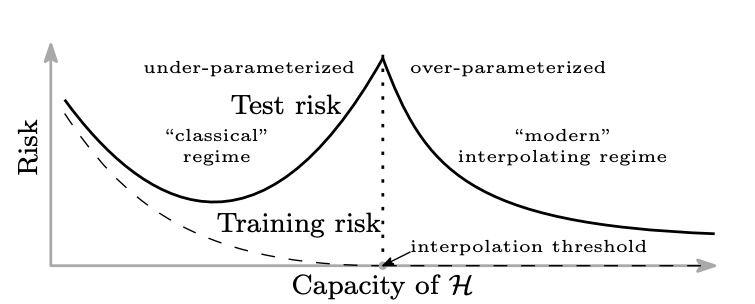

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'double_descent_I.png'))

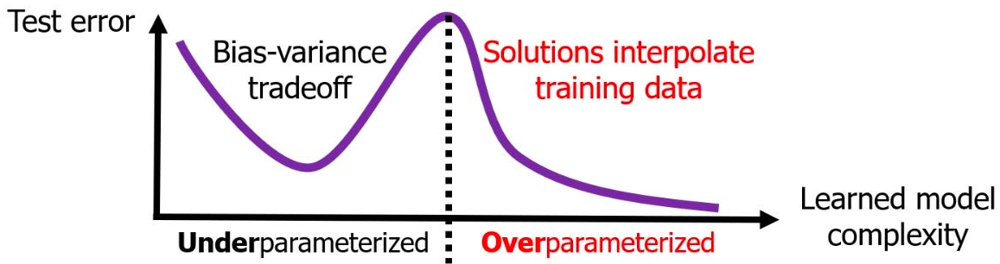

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'double_descent_II.png'))

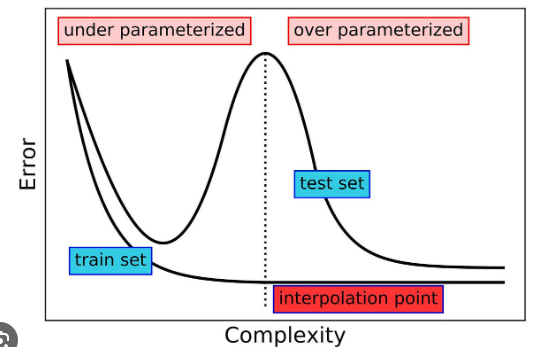

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'double_descent_III.png'))

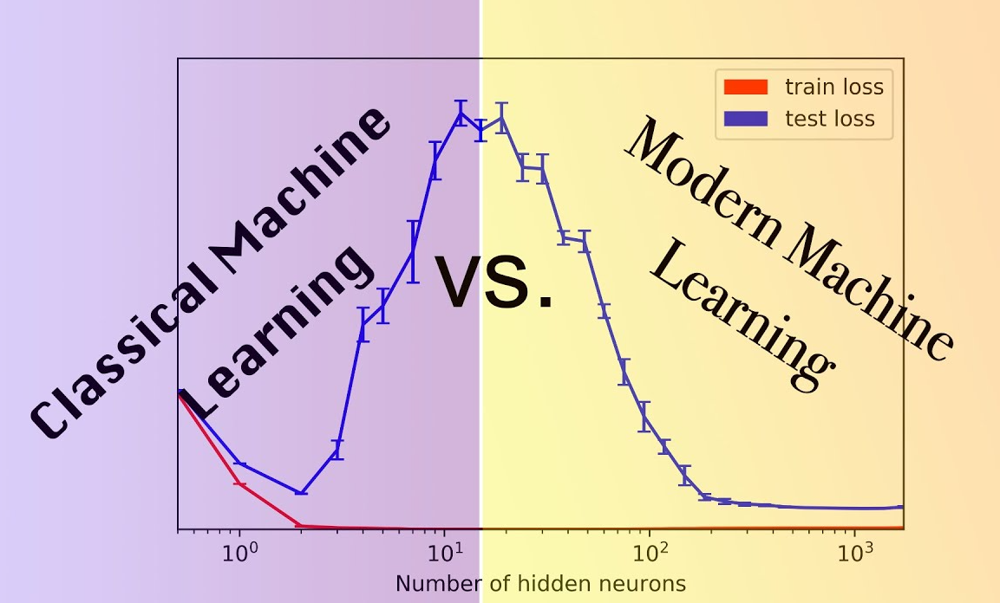

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'classical_vs_modern_ML.png'))

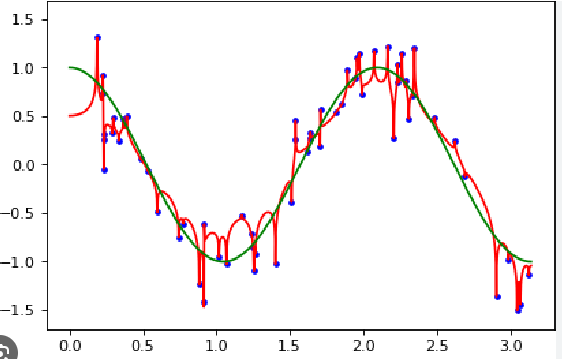

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'interpolation_estimators_II.png'))

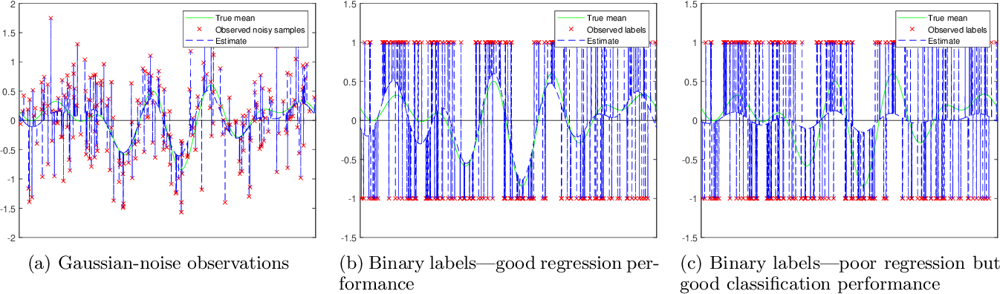

In [ ]:
tf.keras.preprocessing.image.load_img(os.path.join(images_path, 'interpolation_estimators_I.png'))

<br>
<font size="+1" style="color:red">
    <font color="red">A residual analysis is usually based on the fact that the residuals of an adequate model should be approximately white noise.
    <br>
    <ul>
        <font color="red"><li>A plot of the residuals can be a useful tool in checking for outliers.</li>
        <br>
        <li>The estimated residual autocorrelations are usually examined.</li>
        <br>
        <li>Recall, for a white noise series, the autocorrelations are zero. Therefore the significance of the residual autocorrelations is often checked by comparing with approximate two-standard error bounds ($\pm 2 / \sqrt{T}$).</li></font>
        <br>
    </ul>
</font>

$\square$

## Standarize data

> We volatility standardize returns and predictors using backward-looking standard deviations that preserve the out-of-sample nature of our forecasts.

> Returns are standardized by their trailing 12-month return standard deviation (to capture their comparatively fastmoving conditional volatility), while predictors are standardized using an expanding window historical standard deviation (given the much higher persistence of most predictors).

> We require 36 months of data to ensure that we have enough stability in our initial predictor standardization, so the final sample that we bring to our analysis begins in 1930. We perform this standardization to align the empirical analysis with our homoskedastic theoretical setting, **but our results are insensitive to this step (none of our findings are sensitive to variations in how standardizations are implemented)**

I did try a few different normalizations and the end results seems to be nearly the same.

In [ ]:
# for col in columns:
#     data[col] = (data[col] - data[col].expanding(36).mean())/data[col].expanding(36).std()
# # Standarize return by the std of the last 12 values
# returns_std = returns.rolling(12).std().shift()
# returns = returns / returns_std

# data = data[36:]
# returns = returns[36:]

# sns.heatmap(data[columns].cov(), center=0, vmin=-1, vmax=1, cmap=sns.color_palette("coolwarm_r", as_cmap=True))
# fig = plt.gcf()
# fig.figsize = (10,10)
# plt.title("Covariance Matrix")
# # plt.savefig("plots/covariance.jpg")
# plt.show()

## Random Fourier Features

In [ ]:
# data = data[columns].copy()
# nr_features = 6000
# if f"data_{nr_features}.parquet" not in os.listdir("data"):
#     print("Calculating omegas.")
#     omegas, rff_names, rff_features = [], [], []
#     for i in tqdm(range(nr_features)): # 6000*2 == 12000 == P
#         omega = np.random.normal(0, 2, len(columns))
#         rff_names.append(f"sin_{i}")
#         rff_names.append(f"cos_{i}")
#         rff_features.append(np.sin(data[columns] @ omega))
#         rff_features.append(np.cos(data[columns] @ omega))
#         omegas.append(omega)
#     data[rff_names] = np.vstack(rff_features).T
#     joblib.dump(omegas, f"data/omegas_{nr_features}.joblib")
#     data.to_parquet(f"data/data_{nr_features}.parquet")

# else:
#     omegas = joblib.load(f"data/omegas_{nr_features}.joblib")
#     data = pd.read_parquet(f"data/data_{nr_features}.parquet")
#     print("data & omegas.joblib loaded.")

# print("Shape of data after generating RFFs:", data.shape)





## Model

Ridge Regression with Moore-Penrose pseudo-inverse:

This is the formula from the paper, *run time of 6mins*

> ```beta = np.linalg.pinv(z*np.identity(nr_cols) +  (S.T @ S)/T) @ (R @ S)/T```

Normal Inverse (not numerically stable if not full rank), *run time of 25sec*

>```beta = np.linalg.inv(z*np.identity(nr_cols) +  (S.T @ S)/T) @ (R @ S)/T```

Note: I did not observe different results with inv() vs. pinv().


This formula (notice that the division by `T` is missing) is equivalent to the sklearn ridge regression but orders of magnitude slower (*numpy: 6mins, Sklearn: 45ms*)
>```beta = np.linalg.pinv(z*np.identity(nr_cols) +  (S.T @ S)) @ (R @ S)```


Since the Sklearn solution is 8.000 times slower, I will proceed with that solution. `np.linalg.pinv()`.

I did only test ~100 iterations in the comparision between `pinv()`, `inv()` and `Ridge()` to get the runtime of 6min per calculation of pinv()


In [ ]:
# %%time
# z_values = [10**-3, 10**2, 10**3,  10**4,  10**5, 10**6, 10**7, 10**8, 10**9]
# t_values = list(range(12, data.shape[0]))
# if f"backtest_{nr_features}.parquet" not in os.listdir("data"):
#     backtest = []
#     for t in tqdm(t_values[:-1]):
#         for z in z_values:
#             regression_data = data.drop(columns, axis=1)

#             R = returns[t-12+1:t+1].values      # y_train
#             R_s = returns[t+1:t+2].values       # y_test
#             R_s_index = returns[t+1:t+2].index  # y_test
#             S = regression_data[t-12:t]         # X_train
#             S_t = regression_data[t:t+1]        # X_test
#             T, nr_cols = S.shape

#             beta = Ridge(alpha=z, solver="svd", fit_intercept=False, normalize=False).fit(S, R).coef_
#             beta_norm = np.sqrt((beta**2).sum())

#             forecast = S_t @ beta
#             timing_strategy = forecast * R_s # pi

#             backtest.append({"z":z, "t":t, "beta_norm":beta_norm,
#                 "index":forecast.index[0], "forecast":forecast.values[0],
#                 "timing_strategy_index":R_s_index[0], "timing_strategy":timing_strategy.values[0], "return":R_s[0]
#             })
#     backtest = pd.DataFrame(backtest).set_index("index")

#     backtest["return_denorm"] = (backtest["return"]*returns_std).dropna()
#     backtest["forecast_denorm"] = (backtest["forecast"]*returns_std).dropna()

#     backtest.to_parquet(f"data/backtest_{nr_features}.parquet")
# else:
#     backtest = pd.read_parquet(f"data/backtest_{nr_features}.parquet")
#     print("backtest.parquet loaded.")

## Result

Note: **Footnote [25]**
> More specifically, the first column reports summary statistics for the market return with rolling 12-month volatility standardization. Thus, the buy-and-hold version of this asset is itself a basic timing strategy, where timing is inversely proportional to rolling volatility. We do this simply because the standardized market is the target in our forecasting analysis. Our results across the board are generally insensitive to, and our conclusions entirely unaffected by, whether we work with the raw or volatility standardized market return. As noted earlier, we prefer to use the volatility standardized market because it aligns more directly with our theoretical framework.

**Expected result:**

|    | High Complexity Machine |
|----|-------------------------|
|  z |                    1000 |
|  c |                    1000 |
| R2 |                      8% |
| SR | 0.46                    |
| IR | 0.31                    |

Page 48 reports $R^2$ as "per month". The Sharpe Ratio value seems to be more fitting if you annualize the data.



In [ ]:
# result = []
# for z in z_values:
#         df = backtest[backtest["z"] == z]
#         # Calculate the strategies alpha/beta
#         market_reg = LinearRegression().fit(df[["timing_strategy"]], df["return"])
#         beta = market_reg.coef_[0]
#         alpha = market_reg.intercept_

#         time_factor = 12 # 12 to get annual values
#         mean = df["timing_strategy"].mean()*time_factor
#         std = df["timing_strategy"].std()*np.sqrt(time_factor)
#         mean_return = df["return"].mean()/beta

#         result.append({
#             "log10(z)" : np.log10(z),
#             "beta_norm_mean" : df["beta_norm"].mean(),
#             "Market Sharpe Ratio" : (df["return"].mean()*time_factor)/(df["return"].std()*np.sqrt(time_factor)),
#             "Expected Return" : mean,
#             "Volatility" : std,
#             "R2" : r2_score(df["return"]/beta, df["timing_strategy"]),
#             "SR" : mean/std,
#             "IR" : (mean - mean_return)/std,
#             "Alpha" : alpha,
#             "Precision": precision_score(df["return"] > 0, df["forecast"] > 0),
#             "Recall": recall_score(df["return"] > 0, df["forecast"] > 0),
#             "Accuracy": accuracy_score(df["return"] > 0, df["forecast"] > 0),
#         })
# result = pd.DataFrame(result)
# result.round(5)

In [ ]:
# fig, ax = plt.subplots(figsize=(18,10))
# for col in ["forecast", "timing_strategy"]:
#     plot_data = pd.DataFrame()
#     plot_data[col] = backtest.loc[backtest["z"] == 1000, col]
#     plot_data["6m MA"] = plot_data[col].rolling(6).mean()

#     recessions = [t for date_list in nber.apply(lambda x: pd.date_range(x["peak"], x["trough"]), axis=1).values for t in date_list]
#     plot_data["NBER Recession"] = plot_data.index.isin(recessions).astype(int)
#     plot_data = plot_data.dropna()
#     plot_data["6m MA"].plot(ax=ax, label=col)
# ax.fill_between(plot_data.index, ax.get_ylim()[0], ax.get_ylim()[1],
#                 where=plot_data["NBER Recession"] == 1 ,color='grey', alpha=0.3,  label="NBER Recession")
# ax.legend(loc="upper right")
# ax.axhline(0, c="black")
# ax.set_title("Forecast vs. timing_strategy")
# plt.savefig("plots/result.jpg")
# plt.show()

In [ ]:
# for col in ["forecast", "timing_strategy"]:
#     plot_data = pd.DataFrame()
#     plot_data[col] = backtest.loc[backtest["z"] == 1000, col]
#     plot_data["6m MA"] = plot_data[col].rolling(6).mean()

#     recessions = [t for date_list in nber.apply(lambda x: pd.date_range(x["peak"], x["trough"]), axis=1).values for t in date_list]
#     plot_data["NBER Recession"] = plot_data.index.isin(recessions).astype(int)

#     plot_data = plot_data.dropna()

#     fig, ax = plt.subplots(figsize=(18,10))
#     plot_data[col].plot(ax=ax, alpha=0.7, c="lightblue")
#     plot_data["6m MA"].plot(ax=ax, c="steelblue")
#     ax.set_ylim(plot_data["6m MA"].min()*1.1, plot_data["6m MA"].max()*1.1)
#     ax.fill_between(plot_data.index, ax.get_ylim()[0], ax.get_ylim()[1],
#                     where=plot_data["NBER Recession"] == 1 ,color='grey', alpha=0.3,  label="NBER Recession")
#     ax.legend(loc="upper right")
#     ax.set_title(f"Column: {col}")
#     plt.savefig("plots/result.jpg")
#     plt.show()



## Expected plot:
![Expected plot](plots/expected_result.png "Expected plot")

## Plots
Here we present several visualizations to analyze our metrics. We use a logarithmic scale on the left to better represent the results for each `c` in the range `[0, 1000]`. The right-hand side provides plots similar to those in the original paper, but with a broken x-axis for `c` in the ranges `[0, 50]` and `[950, 1000]`.

We also provide plots for specific metrics, such as the Sharpe Ratio, for particular ranges of `log10(z)`. This allows us to better visualize the differences for each value of `log10(z)`. Additionally, we show plots for various `gamma` values to validate footnote [24]:  
> We set γ = 2. Our results are generally insensitive to γ, as discussed in the robustness section below.

The critical point at `c=1` (meaning the number of observations equals the number of features resulting in) is indicated by a vertical grey line. **The baseline value of a simple Ridge regression without Random Fourier Features is marked by a horizontal black line, aiding in the comparison and identification of improvements.**


--------------------------

Overall, our plots show a trend consistent with the original paper, although there are differences in specific values. These discrepancies may stem from different specific implementation choices (e.g., beta adjustment?).


The metrics are displayed blow. Compared to page 39:
- beta_norm_mean: comparable
- Expected Return: 10x higher. Figure 7 of the paper indicates that it is the "Market Timing Performance", which is what I used (annualized)
- Volatility: our results are approximately twice as high
- R2: comparable

The following metrics are extremely similar to those shown in Figure 8 of the paper (p41)
- Sharpe Ratio
- Information Ratio
- Alpha

**All values are below the regression benchmark** for `gamma==2`.

## Anatomy of a Neural Network: Understanding Core Keras API
<br>
<font size="+1">
  <ul>
    <li>https://keras.io/api/</li>
    <br>
    <li>https://www.tensorflow.org/guide/keras</li>
    <br>
  </ul>
</font>
$̇\square$

## <h2>Layers: The Building Blocks of Deep Learning</h2>
<br>
<font size="+1">
  <ul>
    <li>https://keras.io/api/</li>
    <br>
    <li>https://www.tensorflow.org/guide/keras</li>
    <br>
  </ul>
</font>
$̇\square$

## <h2>From Layers to Models</h2>
<br>
<font size="+1">
  <ul>
    <li>https://keras.io/api/</li>
    <br>
    <li>https://www.tensorflow.org/guide/keras</li>
    <br>
  </ul>
</font>
$̇\square$

## <h2>The "Compile" Step: Configuring the Learning Process</h2>
<br>
<font size="+1">
  <ul>
    <li>https://keras.io/api/</li>
    <br>
    <li>https://www.tensorflow.org/guide/keras</li>
    <br>
  </ul>
</font>
$̇\square$

## <h2>Picking a Loss Function</h2>
<br>
<font size="+1">
  <ul>
    <li>https://keras.io/api/</li>
    <br>
    <li>https://www.tensorflow.org/guide/keras</li>
    <br>
  </ul>
</font>
$̇\square$

## <h2>Understanding the <i>fit()</i> Method</h2>
<br>
<font size="+1">
  <ul>
    <li>https://keras.io/api/</li>
    <br>
    <li>https://www.tensorflow.org/guide/keras</li>
    <br>
  </ul>
</font>
$̇\square$

## <h2>Monitoring Loss and Metrics on Validation Data</h2>
<br>
<font size="+1">
  <ul>
    <li>https://keras.io/api/</li>
    <br>
    <li>https://www.tensorflow.org/guide/keras</li>
    <br>
  </ul>
</font>
$̇\square$

## <h2>Inference: Using a Model After Training</h2>
<br>
<font size="+1">
  <ul>
    <li>https://keras.io/api/</li>
    <br>
    <li>https://www.tensorflow.org/guide/keras</li>
    <br>
  </ul>
</font>
$̇\square$